# Macroeconomic cycles and asset class returns

This notebook offers the necessary code to replicate the research findings discussed in Macrosynergy's post ["Macroeconomic cycles and asset class returns"](https://research.macrosynergy.com/macroeconomic-cycles-and-asset-class-returns/). Its primary objective is to inspire readers to explore and conduct additional investigations while also providing a foundation for testing their own unique ideas. 

## Get packages and JPMaQS data

This notebook primarily relies on the standard packages available in the Python data science stack. However, there is an additional package `macrosynergy` that is required for two purposes:

- Downloading JPMaQS data: The `macrosynergy` package facilitates the retrieval of JPMaQS data, which is used in the notebook.
- For the analysis of quantamental data and value propositions: The `macrosynergy` package provides functionality for performing quick analyses of quantamental data and exploring value propositions.

For detailed information and a comprehensive understanding of the `macrosynergy` package and its functionalities, please refer to the ["Introduction to Macrosynergy package"](https://academy.macrosynergy.com/academy/Introductions/Introduction%20to%20Macrosynergy%20package/_build/html/Introduction%20to%20Macrosynergy%20package.php) on the Macrosynergy Academy or visit the following link on [Kaggle](https://www.kaggle.com/code/macrosynergy/introduction-to-macrosynergy-package).

In [1]:
import numpy as np
import pandas as pd
import matplotlib.pyplot as plt
import seaborn as sns


import macrosynergy.management as msm
import macrosynergy.panel as msp
import macrosynergy.signal as mss
import macrosynergy.pnl as msn
from macrosynergy.download import JPMaQSDownload

from datetime import timedelta, date, datetime
from itertools import combinations
import warnings
import os

warnings.simplefilter("ignore")

The JPMaQS indicators we consider are downloaded using the J.P. Morgan Dataquery API interface within the `macrosynergy` package. This is done by specifying ticker strings, formed by appending an indicator category code <category> to a currency area code <cross_section>. These constitute the main part of a full quantamental indicator ticker, taking the form `DB(JPMAQS,<cross_section>_<category>,<info>)`, where <info> denotes the time series of information for the given cross-section and category. The following types of information are available:

`value` giving the latest available values for the indicator
`eop_lag` referring to days elapsed since the end of the observation period
`mop_lag` referring to the number of days elapsed since the mean observation period
`grade` denoting a grade of the observation, giving a metric of real time information quality.

After instantiating the `JPMaQSDownload` class within the `macrosynergy.download` module, one can use the `download(tickers,start_date,metrics)` method to easily download the necessary data, where `tickers` is an array of ticker strings, `start_date` is the first collection date to be considered and `metrics` is an array comprising the times series information to be downloaded. For more information see [here](https://github.com/macrosynergy/macrosynergy/blob/develop/README.md).

To ensure reproducibility, only samples between January 2000 (inclusive) and May 2023 (exclusive) are considered.

In [2]:
# General cross-sections lists

cids_g3 = ["EUR", "JPY", "USD"]  # DM large currency areas
cids_dmsc = ["AUD", "CAD", "CHF", "GBP", "NOK", "NZD", "SEK"]  # DM small currency areas
cids_latm = ["BRL", "COP", "CLP", "MXN", "PEN"]  # Latam
cids_emea = ["CZK", "HUF", "ILS", "PLN", "RON", "RUB", "TRY", "ZAR"]  # EMEA
cids_emas = ["IDR", "INR", "KRW", "MYR", "PHP", "SGD", "THB", "TWD"]  # EM Asia ex China

cids_dm = cids_g3 + cids_dmsc
cids_em = cids_latm + cids_emea + cids_emas
cids = cids_dm + cids_em

cids_nomp = ["COP", "IDR", "INR"]  # countries that have no employment growth data
cids_mp = list(set(cids) - set(cids_nomp))

# Equity cross-sections lists

cids_dmeq = ["EUR", "JPY", "USD"] + ["AUD", "CAD", "CHF", "GBP", "SEK"]
cids_emeq = ["BRL", "INR", "KRW", "MXN", "MYR", "SGD", "THB", "TRY", "TWD", "ZAR"]
cids_eq = cids_dmeq + cids_emeq

# FX cross-sections lists

cids_nofx = ["EUR", "USD", "SGD"]
cids_fx = list(set(cids) - set(cids_nofx))

cids_dmfx = set(cids_dm).intersection(cids_fx)
cids_emfx = set(cids_em).intersection(cids_fx)

cids_eur = ["CHF", "CZK", "HUF", "NOK", "PLN", "RON", "SEK"]  # trading against EUR
cids_eud = ["GBP", "RUB", "TRY"]  # trading against EUR and USD
cids_usd = list(set(cids_fx) - set(cids_eur + cids_eud))  # trading against USD

# IRS cross-section lists

cids_dmsc_du = ["AUD", "CAD", "CHF", "GBP", "NOK", "NZD", "SEK"]
cids_latm_du = ["CLP", "COP", "MXN"]  # Latam
cids_emea_du = [
    "CZK",
    "HUF",
    "ILS",
    "PLN",
    "RON",
    "RUB",
    "TRY",
    "ZAR",
]  # EMEA
cids_emas_du = ["CNY", "HKD", "IDR", "INR", "KRW", "MYR", "SGD", "THB", "TWD"]

cids_dmdu = cids_g3 + cids_dmsc_du
cids_emdu = cids_latm_du + cids_emea_du + cids_emas_du
cids_du = cids_dmdu + cids_emdu

JPMaQS indicators are conveniently grouped into 6 main categories: Economic Trends, Macroeconomic balance sheets, Financial conditions, Shocks and risk measures, Stylyzed trading factors, and Generic returns. Each indicator has a separate page with notes, description, availability, statistical measures, and timelines for main currencies. The description of each JPMaQS category is available either under [Macro Quantamental Academy](https://academy.macrosynergy.com/quantamental-indicators/), [JPMorgan Markets](https://markets.jpmorgan.com/#jpmaqs) (password protected).
In particular, the indicators used in this notebook could be found under [Labor market dynamics](https://academy.macrosynergy.com/academy/Themes/Economic%20trends/_build/html/notebooks/Labor%20market%20dynamics.php?highlight=employment), [Demographic trends](https://academy.macrosynergy.com/academy/Themes/Economic%20trends/_build/html/notebooks/Demographic%20trends.php?highlight=wforce_nsa_p1q1ql4_20qmm#demographic-trends), [Consumer price inflation trends](https://academy.macrosynergy.com/academy/Themes/Economic%20trends/_build/html/notebooks/Consumer%20price%20inflation%20trends.php), [Intuitive growth estimates](https://macrosynergy.com/academy/notebooks/intuitive-gdp-growth-estimates/), [Long-term GDP growth](https://macrosynergy.com/academy/notebooks/gdp-growth/), [Private credit expansion](https://macrosynergy.com/academy/notebooks/private-credit-expansion/), [Equity index future returns](https://academy.macrosynergy.com/academy/Themes/Generic%20returns/_build/html/notebooks/Equity%20index%20future%20returns.php), [FX forward returns](https://academy.macrosynergy.com/academy/Themes/Generic%20returns/_build/html/notebooks/FX%20forward%20returns.php), and [Duration returns](https://academy.macrosynergy.com/academy/Themes/Generic%20returns/_build/html/notebooks/Duration%20returns.php).

In [3]:
# Category tickers

main = [
    "EMPL_NSA_P1M1ML12_3MMA",
    "EMPL_NSA_P1Q1QL4",
    "WFORCE_NSA_P1Y1YL1_5YMM",
    "WFORCE_NSA_P1Q1QL4_20QMM",
    "UNEMPLRATE_NSA_3MMA_D1M1ML12",
    "UNEMPLRATE_NSA_D1Q1QL4",
    "UNEMPLRATE_SA_D1Q1QL4",  # potentially NZD only
    "UNEMPLRATE_SA_D3M3ML3",
    "UNEMPLRATE_SA_D1Q1QL1",
    "UNEMPLRATE_SA_3MMA",
    "UNEMPLRATE_SA_3MMAv10YMM",
    "CPIH_SA_P1M1ML12",
    "CPIH_SJA_P6M6ML6AR",
    "CPIC_SA_P1M1ML12",
    "CPIC_SJA_P6M6ML6AR",
    "INFTEFF_NSA",
    "INTRGDPv5Y_NSA_P1M1ML12_3MMA",
    "RGDP_SA_P1Q1QL4_20QMM",
    "PCREDITBN_SJA_P1M1ML12",
]
xtra = ["GB10YXR_NSA"]

rets = [
    "EQXR_NSA",
    "EQXR_VT10",
    "FXTARGETED_NSA",
    "FXUNTRADABLE_NSA",
    "FXXR_NSA",
    "FXXR_VT10",
    "FXXRHvGDRB_NSA",
    "DU02YXR_NSA",
    "DU02YXR_VT10",
    "DU05YXR_VT10",
]

xcats = main + rets + xtra

In [4]:
# Download series from J.P. Morgan DataQuery by tickers

start_date = "2000-01-01"
end_date = "2023-05-01"

tickers = [cid + "_" + xcat for cid in cids for xcat in xcats]
print(f"Maximum number of tickers is {len(tickers)}")

# Retrieve credentials

client_id: str = os.getenv("DQ_CLIENT_ID")
client_secret: str = os.getenv("DQ_CLIENT_SECRET")

with JPMaQSDownload(client_id=client_id, client_secret=client_secret) as dq:
    df = dq.download(
        tickers=tickers,
        start_date=start_date,
        suppress_warning=True,
        metrics=["value"],
        report_time_taken=True,
        show_progress=True,
    )

Maximum number of tickers is 930
Timestamp UTC:  2024-11-19 09:42:46
Connection successful!


Requesting data: 100%|██████████| 47/47 [00:09<00:00,  4.84it/s]


Time taken to download data: 	22.68 seconds.
Some expressions are missing from the downloaded data. Check logger output for complete list.
229 out of 930 expressions are missing. To download the catalogue of all available expressions and filter the unavailable expressions, set `get_catalogue=True` in the call to `JPMaQSDownload.download()`.
Some dates are missing from the downloaded data. 
3 out of 6494 dates are missing.


In [5]:
display(df["xcat"].unique())
display(df["cid"].unique())
df["ticker"] = df["cid"] + "_" + df["xcat"]
df.head(3)

array(['FXTARGETED_NSA', 'FXXRHvGDRB_NSA', 'DU02YXR_NSA', 'DU02YXR_VT10',
       'CPIH_SJA_P6M6ML6AR', 'CPIC_SJA_P6M6ML6AR',
       'WFORCE_NSA_P1Y1YL1_5YMM', 'INTRGDPv5Y_NSA_P1M1ML12_3MMA',
       'EQXR_VT10', 'DU05YXR_VT10', 'FXUNTRADABLE_NSA', 'FXXR_VT10',
       'INFTEFF_NSA', 'FXXR_NSA', 'PCREDITBN_SJA_P1M1ML12',
       'RGDP_SA_P1Q1QL4_20QMM', 'EQXR_NSA', 'CPIH_SA_P1M1ML12',
       'CPIC_SA_P1M1ML12', 'UNEMPLRATE_SA_3MMAv10YMM',
       'UNEMPLRATE_SA_D1Q1QL1', 'EMPL_NSA_P1Q1QL4', 'UNEMPLRATE_SA_3MMA',
       'UNEMPLRATE_NSA_D1Q1QL4', 'EMPL_NSA_P1M1ML12_3MMA',
       'UNEMPLRATE_NSA_3MMA_D1M1ML12', 'UNEMPLRATE_SA_D3M3ML3',
       'GB10YXR_NSA', 'WFORCE_NSA_P1Q1QL4_20QMM'], dtype=object)

array(['INR', 'PHP', 'HUF', 'KRW', 'THB', 'NZD', 'SGD', 'CHF', 'GBP',
       'MXN', 'ZAR', 'TRY', 'COP', 'RON', 'SEK', 'ILS', 'CLP', 'EUR',
       'AUD', 'JPY', 'USD', 'CAD', 'CZK', 'NOK', 'PLN', 'MYR', 'PEN',
       'IDR', 'TWD', 'RUB', 'BRL'], dtype=object)

,real_date,cid,xcat,value,ticker
0,2000-01-03,INR,FXTARGETED_NSA,1.0,INR_FXTARGETED_NSA
1,2000-01-04,INR,FXTARGETED_NSA,1.0,INR_FXTARGETED_NSA
2,2000-01-05,INR,FXTARGETED_NSA,1.0,INR_FXTARGETED_NSA


In [6]:
scols = ["cid", "xcat", "real_date", "value"]  # required columns
dfx = df[scols].copy()
dfx.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 4302461 entries, 0 to 4302460
Data columns (total 4 columns):
 #   Column     Dtype         
---  ------     -----         
 0   cid        object        
 1   xcat       object        
 2   real_date  datetime64[ns]
 3   value      float64       
dtypes: datetime64[ns](1), float64(1), object(2)
memory usage: 131.3+ MB


## Blacklist dictionaries

Identifying and isolating periods of official exchange rate targets, illiquidity, or convertibility-related distortions in FX markets is the first step in creating an FX trading strategy. These periods can significantly impact the behavior and dynamics of currency markets, and failing to account for them can lead to inaccurate or misleading findings. 

In [7]:
dfb = df[df["xcat"].isin(["FXTARGETED_NSA", "FXUNTRADABLE_NSA"])].loc[
    :, ["cid", "xcat", "real_date", "value"]
]
dfba = (
    dfb.groupby(["cid", "real_date"])
    .aggregate(value=pd.NamedAgg(column="value", aggfunc="max"))
    .reset_index()
)
dfba["xcat"] = "FXBLACK"
fxblack = msp.make_blacklist(dfba, "FXBLACK")
fxblack

{'BRL': (Timestamp('2012-12-03 00:00:00'), Timestamp('2013-09-30 00:00:00')),
 'CHF': (Timestamp('2011-10-03 00:00:00'), Timestamp('2015-01-30 00:00:00')),
 'CZK': (Timestamp('2014-01-01 00:00:00'), Timestamp('2017-07-31 00:00:00')),
 'ILS': (Timestamp('2000-01-03 00:00:00'), Timestamp('2005-12-30 00:00:00')),
 'INR': (Timestamp('2000-01-03 00:00:00'), Timestamp('2004-12-31 00:00:00')),
 'MYR_1': (Timestamp('2000-01-03 00:00:00'), Timestamp('2007-11-30 00:00:00')),
 'MYR_2': (Timestamp('2018-07-02 00:00:00'), Timestamp('2024-11-18 00:00:00')),
 'PEN': (Timestamp('2021-07-01 00:00:00'), Timestamp('2021-07-30 00:00:00')),
 'RON': (Timestamp('2000-01-03 00:00:00'), Timestamp('2005-11-30 00:00:00')),
 'RUB_1': (Timestamp('2000-01-03 00:00:00'), Timestamp('2005-11-30 00:00:00')),
 'RUB_2': (Timestamp('2022-02-01 00:00:00'), Timestamp('2024-11-18 00:00:00')),
 'SGD': (Timestamp('2000-01-03 00:00:00'), Timestamp('2024-11-18 00:00:00')),
 'THB': (Timestamp('2007-01-01 00:00:00'), Timestamp('20

In [8]:
dublack = {
    "TRY": fxblack["TRY_2"]
}  # create a customized blacklist for TRY to be used later in the code

## Availability

It is important to assess data availability before conducting any analysis. It allows to identify any potential gaps or limitations in the dataset, which can impact the validity and reliability of analysis and ensure that a sufficient number of observations for each selected category and cross-section is available as well as determining the appropriate time periods for analysis. 

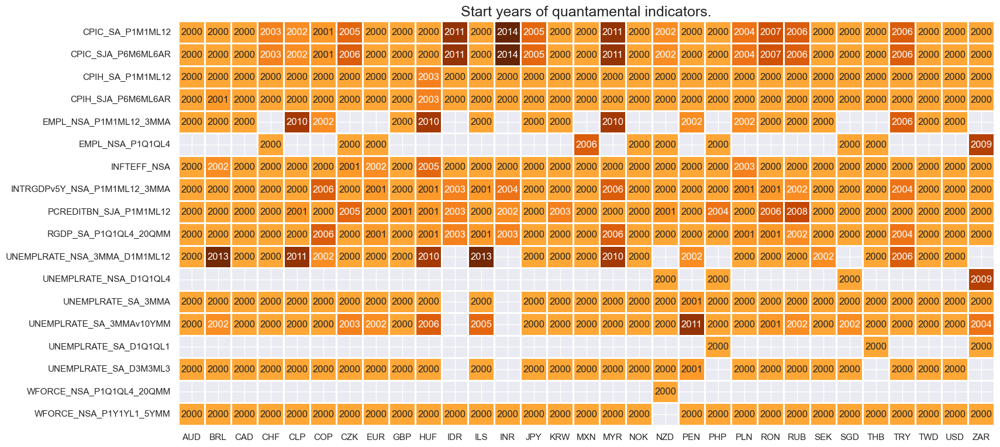

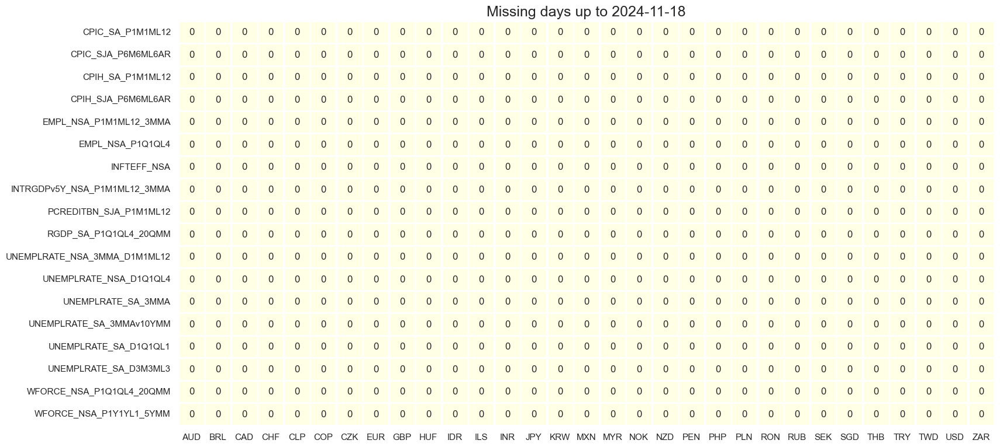

In [9]:
msm.check_availability(df, xcats=main, cids=cids)

# Transformations and checks

## Features

### Name replacements

In [10]:
dict_repl = {
    "EMPL_NSA_P1Q1QL4": "EMPL_NSA_P1M1ML12_3MMA",
    "WFORCE_NSA_P1Q1QL4_20QMM": "WFORCE_NSA_P1Y1YL1_5YMM",
    "UNEMPLRATE_NSA_D1Q1QL4": "UNEMPLRATE_NSA_3MMA_D1M1ML12",
    "UNEMPLRATE_SA_D1Q1QL1": "UNEMPLRATE_SA_D3M3ML3",
}

for key, value in dict_repl.items():
    dfx["xcat"] = dfx["xcat"].str.replace(key, value)

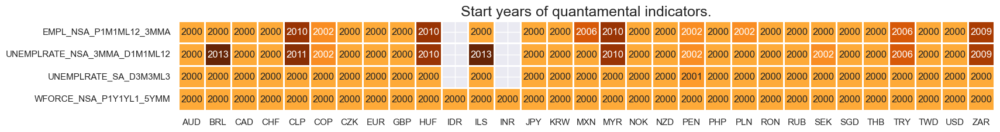

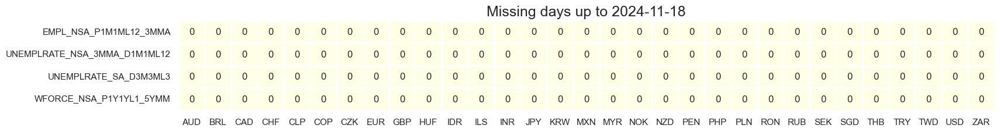

In [11]:
msm.check_availability(dfx, xcats=list(dict_repl.values()), cids=cids)

### Labor market scores

#### Excess employment growth

To proxy the impact of the business cycle state on employment growth, a common approach is to calculate the difference between employment growth and the long-term median of workforce growth. This difference is often referred to as "excess employment growth." By calculating excess employment growth, one can estimate the component of employment growth that is attributable to the business cycle state. This measure helps to identify deviations from the long-term trend and provides insights into the cyclical nature of employment dynamics.

In [12]:
calcs = ["XEMPL_NSA_P1M1ML12_3MMA = EMPL_NSA_P1M1ML12_3MMA - WFORCE_NSA_P1Y1YL1_5YMM "]
dfa = msp.panel_calculator(dfx, calcs=calcs, cids=cids, blacklist=None)
dfx = msm.update_df(dfx, dfa)

The `macrosynergy` package provides two useful functions, `view_ranges()` and `view_timelines()`, which facilitate the convenient visualization of data for selected indicators and cross-sections. These functions assist in plotting means, standard deviations, and time series of the chosen indicators.

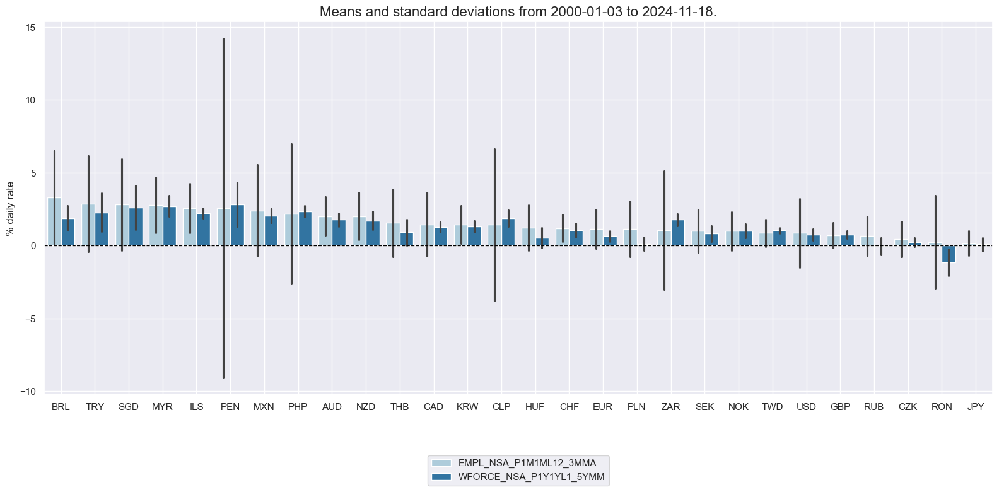

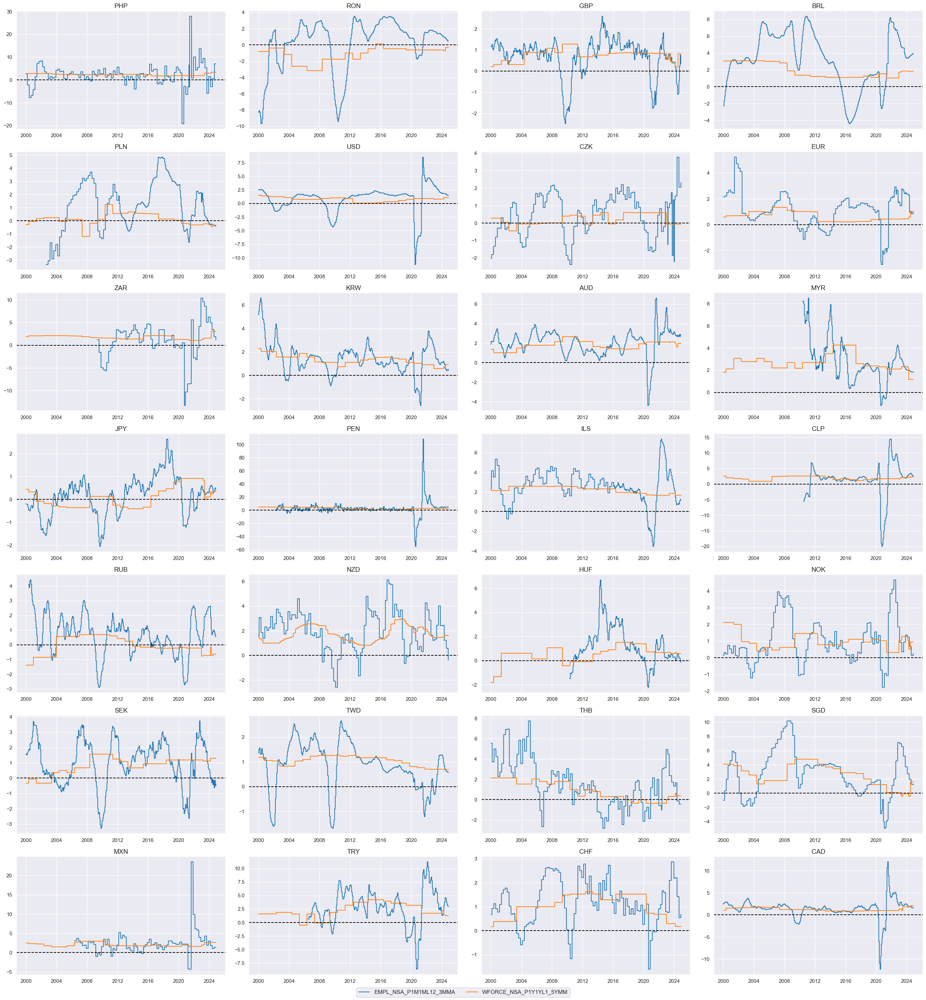

In [13]:
xcatx = ["EMPL_NSA_P1M1ML12_3MMA", "WFORCE_NSA_P1Y1YL1_5YMM"]
cidx = cids_mp

msp.view_ranges(
    dfx,
    cids=cidx,
    xcats=xcatx,
    kind="bar",
    sort_cids_by="mean",
    ylab="% daily rate",
    start="2000-01-01",
)
msp.view_timelines(
    dfx,
    xcats=xcatx,
    cids=cidx,
    ncol=4,
    cumsum=False,
    start="2000-01-01",
    same_y=False,
    size=(12, 12),
    all_xticks=True,

)

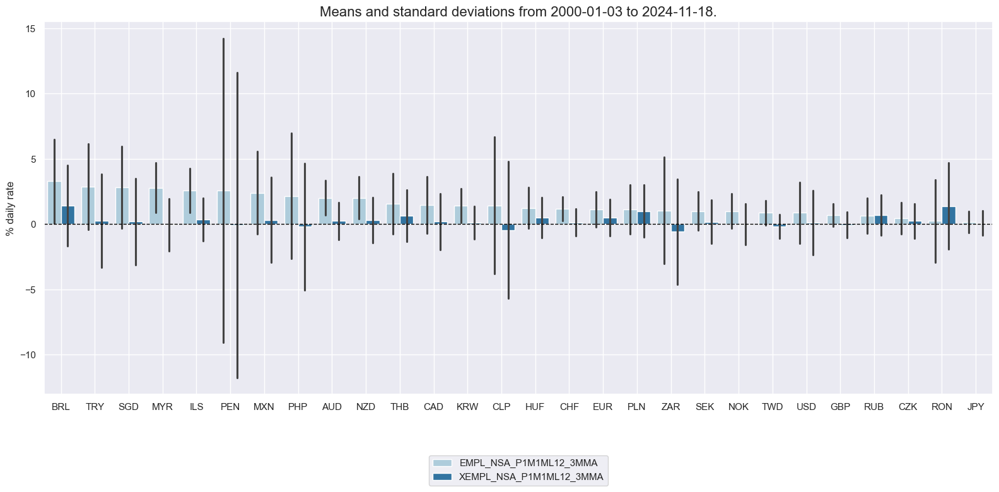

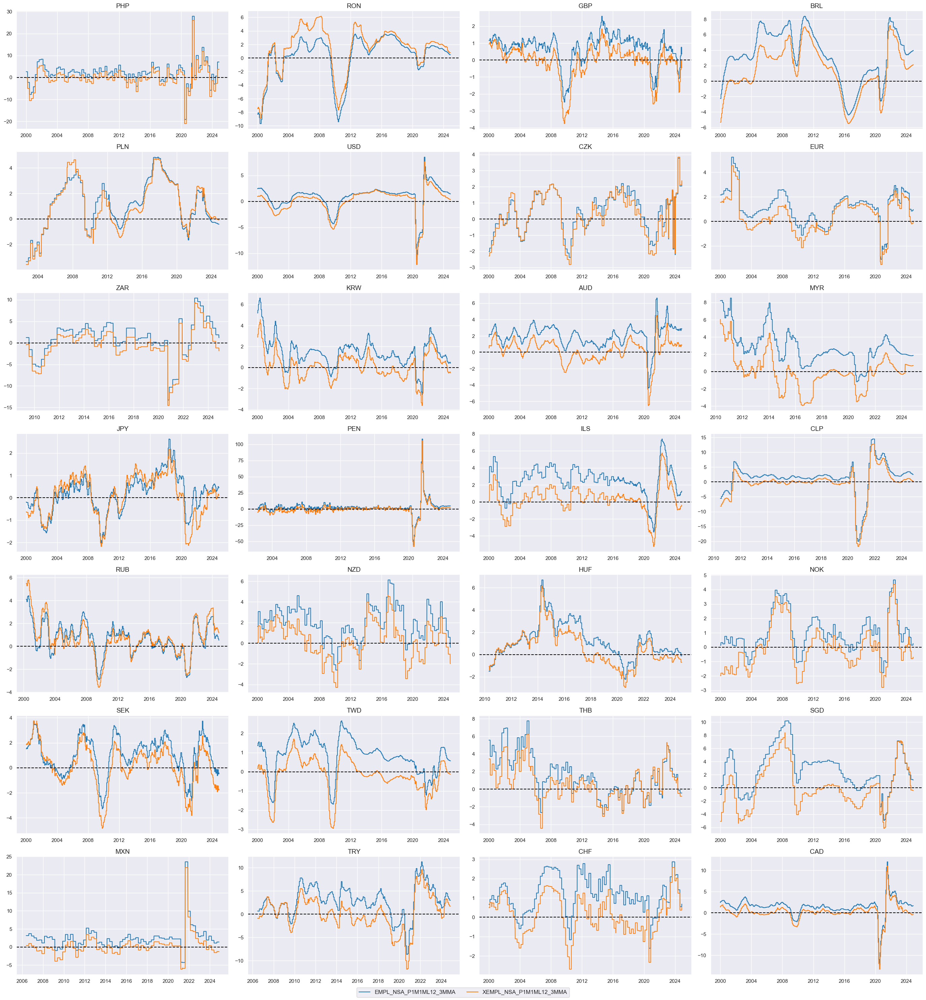

In [14]:
xcatx = ["EMPL_NSA_P1M1ML12_3MMA", "XEMPL_NSA_P1M1ML12_3MMA"]
cidx = cids_mp

msp.view_ranges(
    dfx,
    cids=cidx,
    xcats=xcatx,
    kind="bar",
    sort_cids_by="mean",
    ylab="% daily rate",
    start="2000-01-01",
)

msp.view_timelines(
    dfx,
    xcats=xcatx,
    cids=cidx,
    ncol=4,
    cumsum=False,
    start="2000-01-01",
    same_y=False,
    size=(12, 12),
    all_xticks=True,
   )

#### Unemployment rates and gaps

Unemployment rates and unemployment gaps are commonly used measures in labor market analysis. The unemployment rate is a widely used indicator that measures the percentage of the labor force that is unemployed and actively seeking employment. The unemployment gap refers to the difference between the actual unemployment rate and a reference or target unemployment rate. The unemployment gap is used to assess the deviation of the current unemployment rate from the desired or expected level.
Here we compare the standard unemployment rate, sa, 3mma with unemployment rate difference, 3-month moving average minus the 10-year moving median. Comparison between the two can give insights into the short-term fluctuations and the long-term trend of the unemployment rate. 

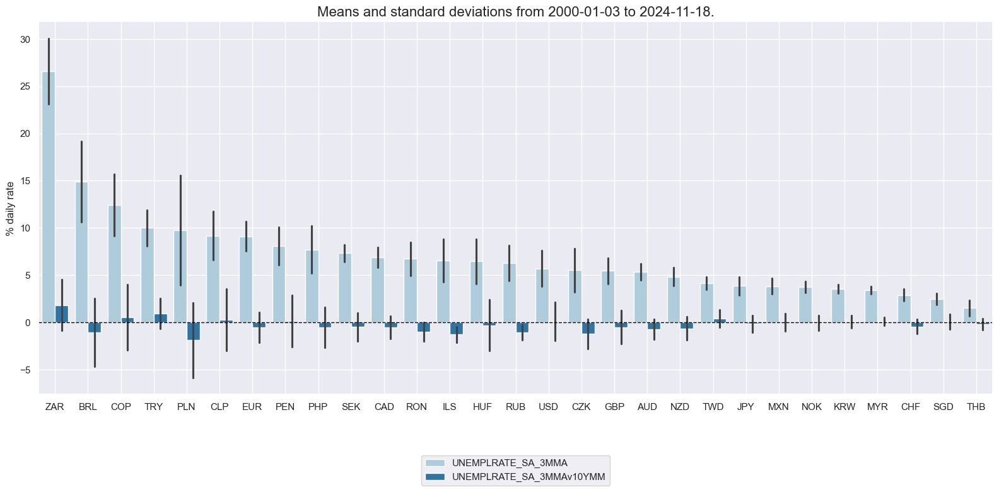

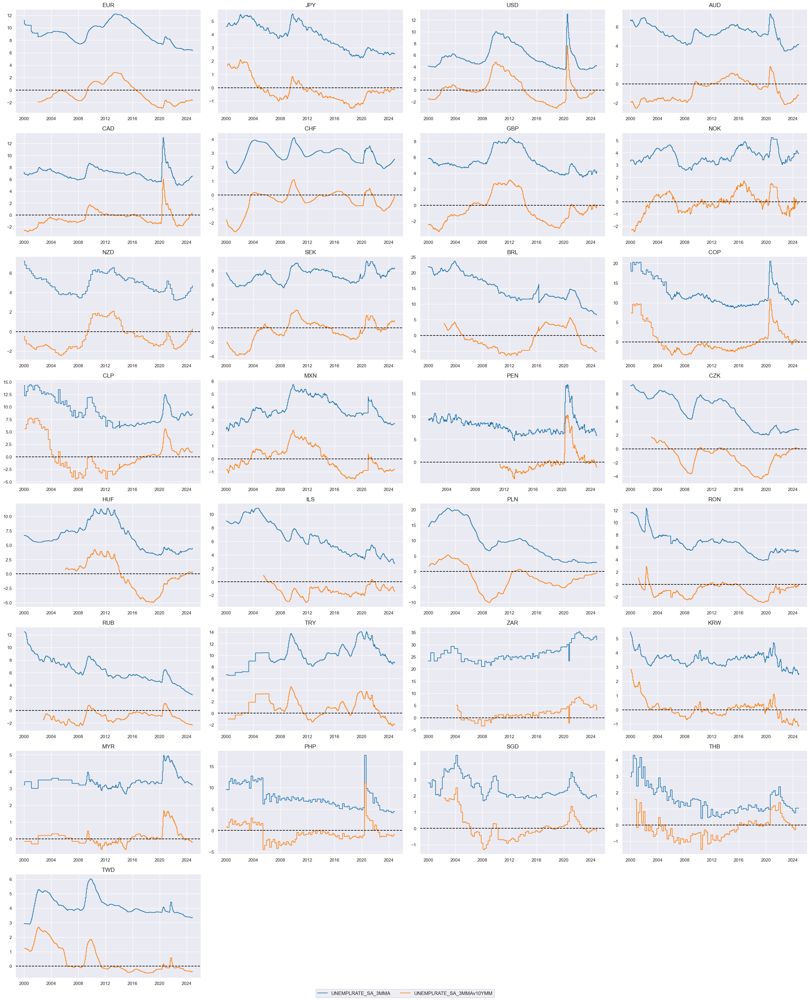

In [15]:
xcatx = ["UNEMPLRATE_SA_3MMA", "UNEMPLRATE_SA_3MMAv10YMM"]
cidx = cids

msp.view_ranges(
    dfx,
    cids=cidx,
    xcats=xcatx,
    kind="bar",
    sort_cids_by="mean",
    ylab="% daily rate",
    start="2000-01-01",
)
msp.view_timelines(
    dfx,
    xcats=xcatx,
    cids=cidx,
    ncol=4,
    cumsum=False,
    start="2000-01-01",
    same_y=False,
    size=(12, 12),
    all_xticks=True,
  
)

#### Unemployment changes

We create a simple average of two unemployment growth indicators: unemploent rate change and unemployment growth:

In [16]:
calcs = [
    "UNEMPLRATE_DA = 1/2 * ( UNEMPLRATE_NSA_3MMA_D1M1ML12 + UNEMPLRATE_SA_D3M3ML3 )",
]
dfa = msp.panel_calculator(dfx, calcs=calcs, cids=cids, blacklist=None)
dfx = msm.update_df(dfx, dfa)

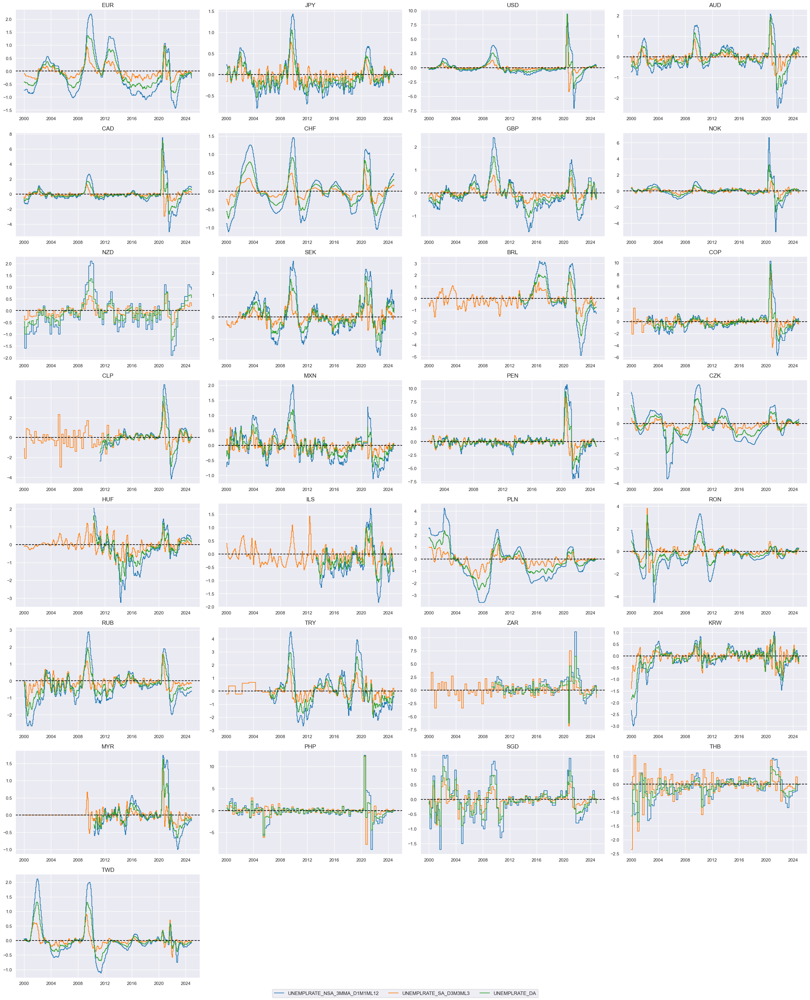

In [17]:
xcatx = ["UNEMPLRATE_NSA_3MMA_D1M1ML12", "UNEMPLRATE_SA_D3M3ML3", "UNEMPLRATE_DA"]
cidx = cids

msp.view_timelines(
    dfx,
    xcats=xcatx,
    cids=cidx,
    ncol=4,
    cumsum=False,
    start="2000-01-01",
    same_y=False,
    size=(12, 12),
    all_xticks=True,
 
)

#### Labor tightening scores

We compute two types of labor market z-scores. One is based on the panel and assumes no structural differences in the features quantitative effects across sections. The other is half based on cross-section alone, which implies persistent structural differences in distributions and their impact on targets. For a description and possible options of function `make_zn_scores()` please see either [Kaggle](https://www.kaggle.com/code/macrosynergy/introduction-to-macrosynergy-package) or under [Academy notebooks](https://academy.macrosynergy.com/academy/Introductions/Introduction%20to%20Macrosynergy%20package/_build/html/Introduction%20to%20Macrosynergy%20package.php). 

In [18]:
xcat_lab = [
    "XEMPL_NSA_P1M1ML12_3MMA",
    "UNEMPLRATE_DA",
    "UNEMPLRATE_SA_3MMAv10YMM",
]
cidx = msm.common_cids(dfx, xcat_lab)

pws = [0.25, 1]  # cross-sectional and panel-based normalization

for xc in xcat_lab:
    for pw in pws:
        dfa = msp.make_zn_scores(
            dfx,
            xcat=xc,
            cids=cidx,
            sequential=True,
            min_obs=522,  # oos scaling after 2 years of panel data
            est_freq="m",
            neutral="zero",
            pan_weight=pw,
            thresh=3,
            postfix="_ZNP" if pw == 1 else "_ZNM",
        )
        dfx = msm.update_df(dfx, dfa)

The individual category scores are combined into a single labor market tightness score.

In [19]:
xcatx = [
    "XEMPL_NSA_P1M1ML12_3MMA",
    "UNEMPLRATE_DA",
    "UNEMPLRATE_SA_3MMAv10YMM",
]
cidx = msm.common_cids(dfx, xcat_lab)
# cidx.remove("NZD")  # ISSUE: invalid empty series created above
n = len(xcatx)
wx = [1 / n] * n
sx = [1, -1, -1]  # signs for tightening


dix = {"ZNP": [xc + "_ZNP" for xc in xcatx], "ZNM": [xc + "_ZNM" for xc in xcatx]}

dfa = pd.DataFrame(columns=dfx.columns).reindex([])
for key, value in dix.items():
    dfaa = msp.linear_composite(
        dfx,
        xcats=value,
        weights=wx,
        signs=sx,
        cids=cidx,
        complete_xcats=False,  # if some categories are missing the score is based on the remaining
        new_xcat="LABTIGHT_" + key,
    )
    dfa = msm.update_df(dfa, dfaa)
dfx = msm.update_df(dfx, dfa)

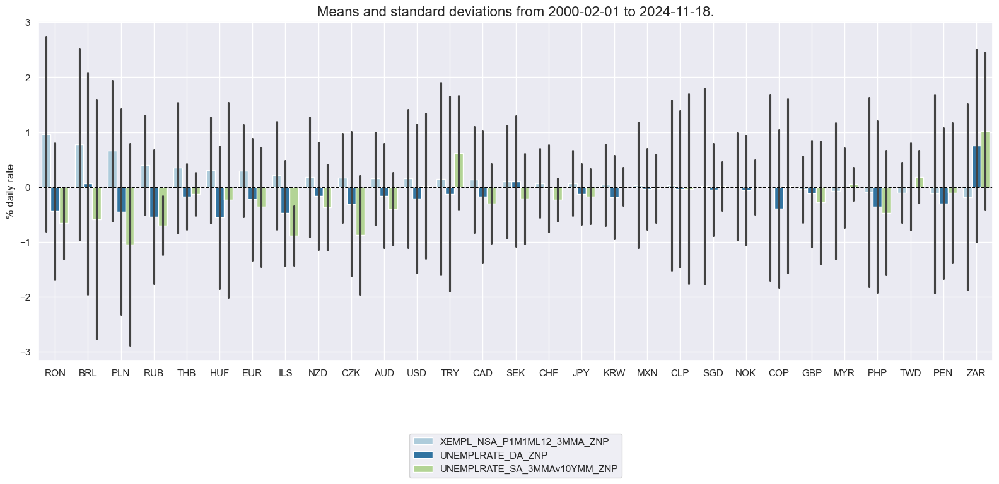

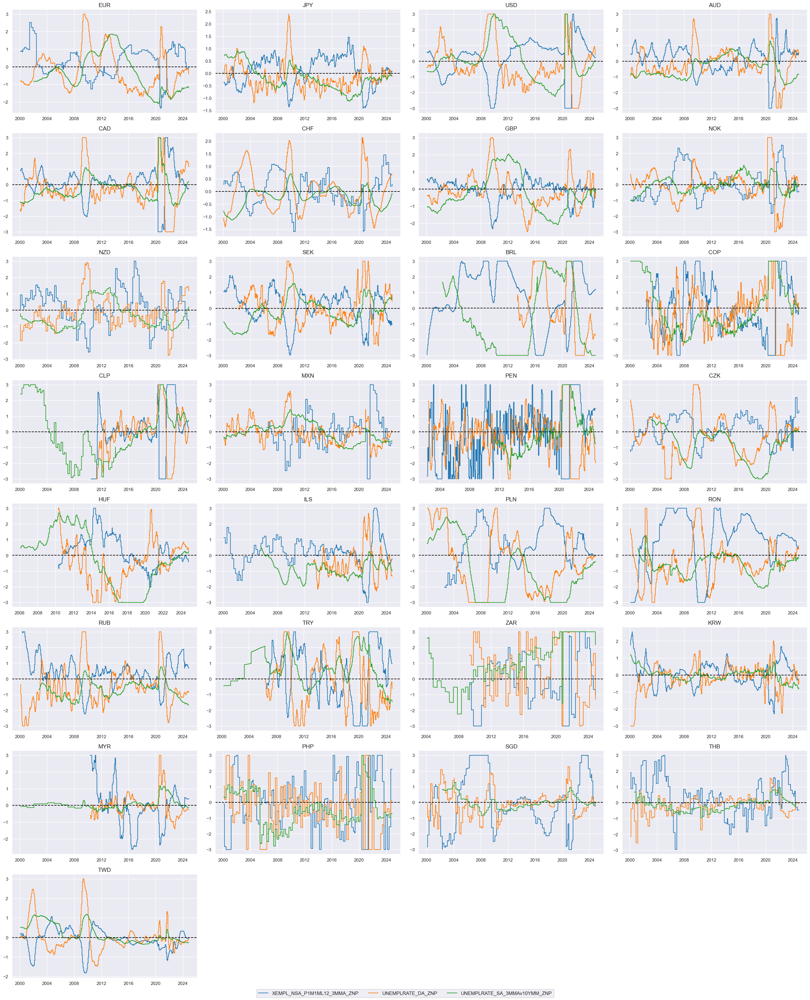

In [20]:
xcatx = [xc + "_ZNP" for xc in xcat_lab]
cidx = cids

msp.view_ranges(
    dfx,
    cids=cidx,
    xcats=xcatx,
    kind="bar",
    sort_cids_by="mean",
    ylab="% daily rate",
    start="2000-01-01",
)
msp.view_timelines(
    dfx,
    xcats=xcatx,
    cids=cidx,
    ncol=4,
    cumsum=False,
    start="2000-01-01",
    same_y=False,
    size=(12, 12),
    all_xticks=True,
  
)

To summarize: we created two Labor market tightening indicators: These are a composite of three quantamental indicators that are jointly tracking the usage of the economy’s labor force. The first is employment growth relative to workforce growth, where the former is measured in % over a year ago and 3-month average and the latter is an estimate based on the latest available 5 years of workforce growth. The second sub-indicator measures changes in the unemployment rate over a year ago and over the last three months, both as a 3-month moving average (view documentation here). The third labor market indicator is the level of the unemployment rate versus a 10-year moving median, again as a 3-month moving average. All three indicators are z-scored, then combined with equal weights, and then the combination is again z-scored for subsequent analysis and aggregation. The difference between the two is the difference in the importance of the panel versus the individual cross-sections for scaling the zn-scores. "_ZNP"  indicator uses the whole panel data as the basis for the parameters and "_ZNM" uses 1/4 of the whole panel and 3/4 of an individual cross-section.  


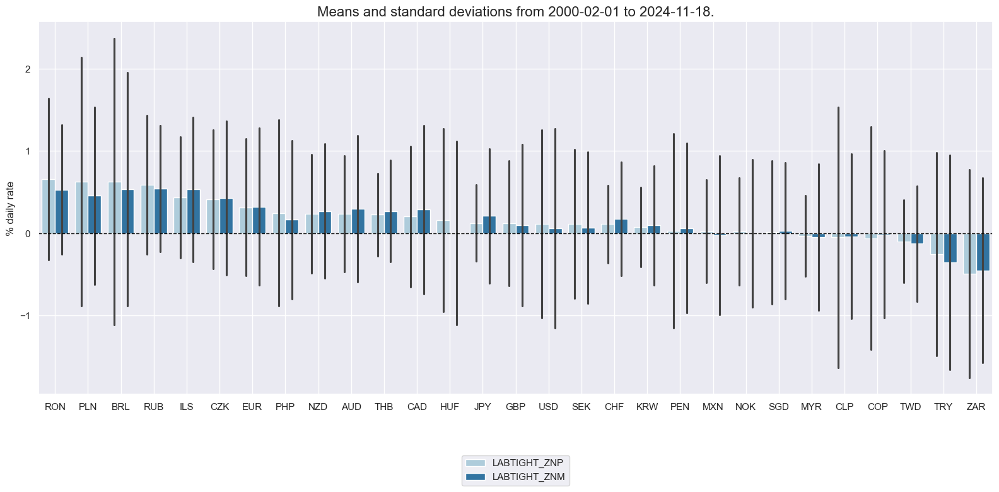

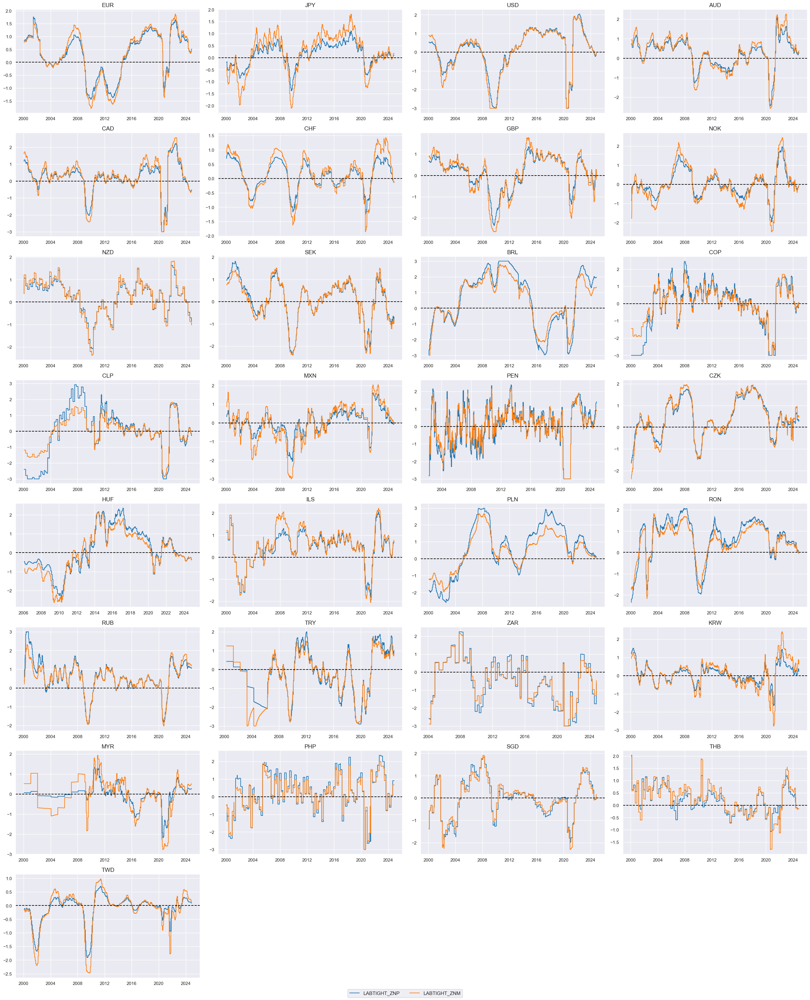

In [21]:
xcatx = ["LABTIGHT_ZNP", "LABTIGHT_ZNM"]
cidx = cids

msp.view_ranges(
    dfx,
    cids=cidx,
    xcats=xcatx,
    kind="bar",
    sort_cids_by="mean",
    ylab="% daily rate",
    start="2000-01-01",
)
msp.view_timelines(
    dfx,
    xcats=xcatx,
    cids=cidx,
    ncol=4,
    cumsum=False,
    start="2000-01-01",
    same_y=False,
    size=(12, 12),
    all_xticks=True,
  )

### Excess inflation

Similarly to labor market tightness, we can calculate plausible metrics of excess inflation versus a country's effective inflation target. To make the targets comparable across markets, the relative target deviations need denominator bases that should never be less than 2, so we clip the Estimated official inflation target for next year at a minimum value of 2 and use it as denominator. We then calculate absolute and relative target deviations for a range of CPI inflation metrics.



In [22]:
dfa = msp.panel_calculator(
    dfx,
    ["INFTEBASIS = INFTEFF_NSA.clip(lower=2)"],
    cids=cids,
)
dfx = msm.update_df(dfx, dfa)

In [23]:
infs = [
    "CPIH_SA_P1M1ML12",
    "CPIH_SJA_P6M6ML6AR",
    "CPIC_SA_P1M1ML12",
    "CPIC_SJA_P6M6ML6AR",
]

for inf in infs:
    calc_iet = f"{inf}vIETR = ( {inf} - INFTEFF_NSA ) / INFTEBASIS"
    dfa = msp.panel_calculator(dfx, calcs=[calc_iet], cids=cids)
    dfx = msm.update_df(dfx, dfa)

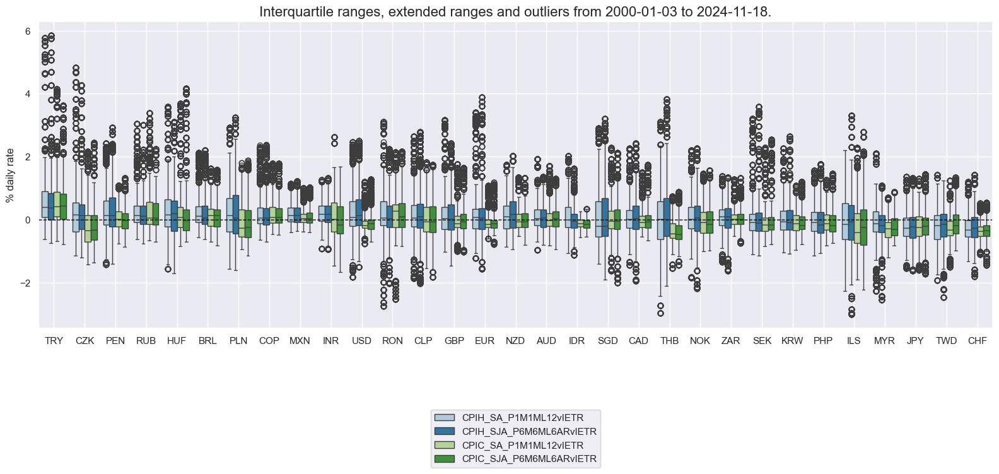

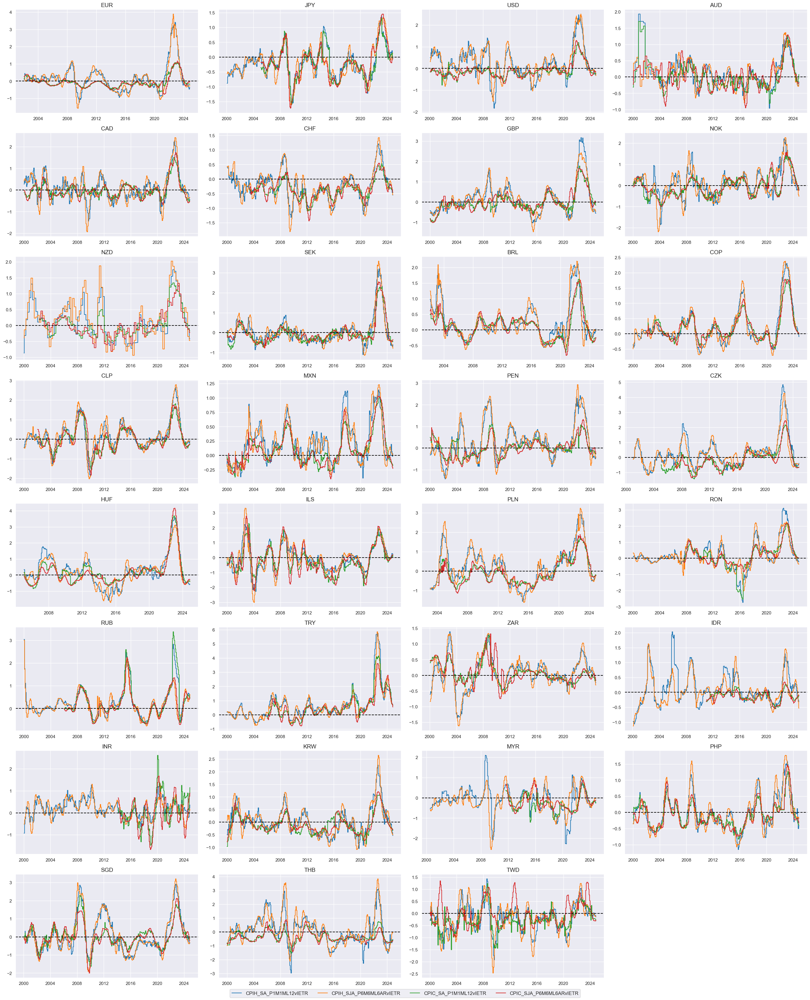

In [24]:
xcatx = [inf + "vIETR" for inf in infs]
cidx = cids

msp.view_ranges(
    dfx,
    cids=cidx,
    xcats=xcatx,
    kind="box",
    sort_cids_by="mean",
    ylab="% daily rate",
    start="2000-01-01",
)
msp.view_timelines(
    dfx,
    xcats=xcatx,
    cids=cidx,
    ncol=4,
    cumsum=False,
    start="2000-01-01",
    same_y=False,
      size=(12, 12),
    all_xticks=True,
  )

The individual excess inflation metrics are similar in size and, hence can be directly combined into a composite excess inflation metric.

In [25]:
xcatx = [inf + "vIETR" for inf in infs]
cidx = cids

dfa = msp.linear_composite(
    dfx,
    xcats=xcatx,
    cids=cidx,
    complete_xcats=False,  # if some categories are missing the score is based on the remaining
    new_xcat="CPI_PCHvIETR",
)

dfx = msm.update_df(dfx, dfa)

As before, we normalize values for the composite excess inflation metric around zero based on the whole panel.

In [26]:
xcatx = "CPI_PCHvIETR"
cidx = cids

dfa = msp.make_zn_scores(
    dfx,
    xcat=xcatx,
    cids=cidx,
    sequential=True,
    min_obs=522,  # oos scaling after 2 years of panel data
    est_freq="m",
    neutral="zero",
    pan_weight=1,
    thresh=2.5,
    postfix="_ZNP",
)
dfx = msm.update_df(dfx, dfa)

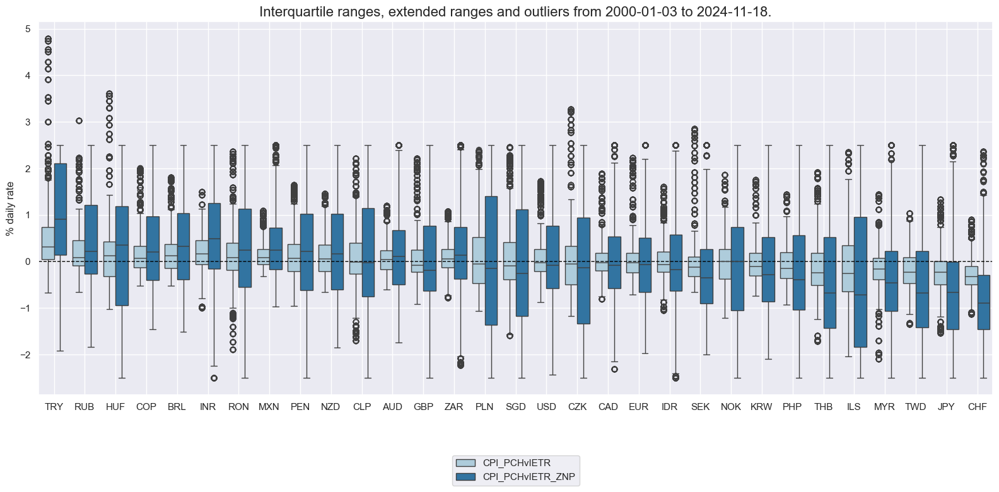

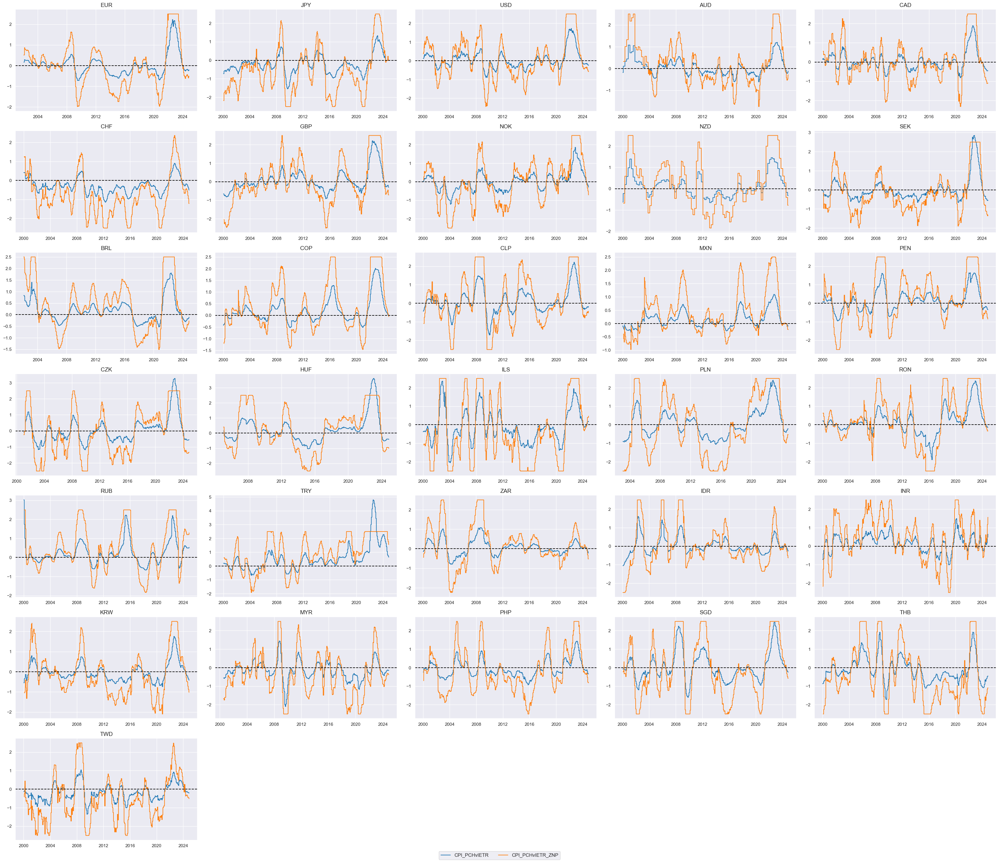

In [27]:
xcatx = ["CPI_PCHvIETR", "CPI_PCHvIETR_ZNP"]
cidx = cids

msp.view_ranges(
    dfx,
    cids=cidx,
    xcats=xcatx,
    kind="box",
    sort_cids_by="mean",
    ylab="% daily rate",
    start="2000-01-01",
)
msp.view_timelines(
    dfx,
    xcats=xcatx[0:2],
    cids=cidx,
    ncol=5,
    cumsum=False,
    start="2000-01-01",
    same_y=False,
    size=(12, 12),
    all_xticks=True,
 )

### Excess growth

Excess real-time growth estimates are z-scored for intuitive interpretation and to winsorize large outliers, which often reflect temporary disruptions and data issues. JPMaQS offers a ready-made indicator of excess estimated GDP growth trend, labelled `INTRGDPv5Y_NSA_P1M1ML12_3MMA`. For each day this is the latest estimated GDP growth trend (% over a year ago, 3-month moving average) minus a 5-year median of that country’s actual GDP growth rate. The historic median represents the growth rate that businesses and markets have grown used to. The GDP growth trend is estimated based on actual national accounts and monthly activity data, based on sets of regressions that replicate conventional charting methods in markets (view full documentation here). For subsequent aggregation and analysis, we then z-score the indicator (normalize volatility) around its zero value on an expanding out-of-sample basis using all cross sections for estimating the standard deviations. As before, we normalize values for the indicator around zero based on the whole panel.

In [28]:
xcatx = "INTRGDPv5Y_NSA_P1M1ML12_3MMA"
cidx = cids

dfa = msp.make_zn_scores(
    dfx,
    xcat=xcatx,
    cids=cidx,
    sequential=True,
    min_obs=522,  # oos scaling after 2 years of panel data
    est_freq="m",
    neutral="zero",
    pan_weight=1,
    #  thresh=3,
    postfix="_ZNP",
)
dfx = msm.update_df(dfx, dfa)

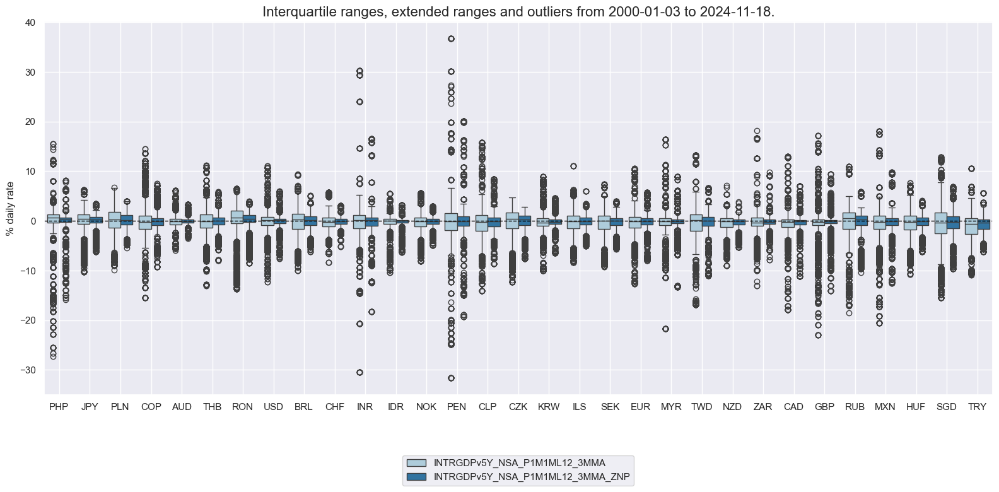

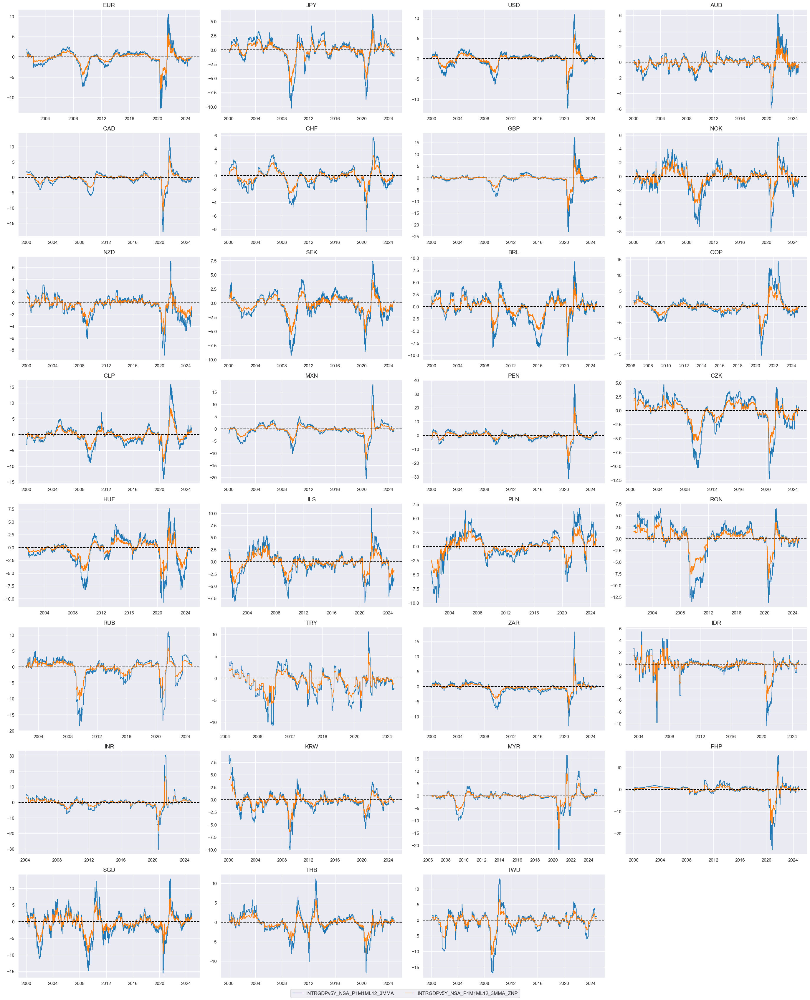

In [29]:
xcatx = ["INTRGDPv5Y_NSA_P1M1ML12_3MMA", "INTRGDPv5Y_NSA_P1M1ML12_3MMA_ZNP"]
cidx = cids

msp.view_ranges(
    dfx,
    cids=cidx,
    xcats=xcatx,
    kind="box",
    sort_cids_by="mean",
    ylab="% daily rate",
    start="2000-01-01",
)
msp.view_timelines(
    dfx,
    xcats=xcatx[0:2],
    cids=cidx,
    ncol=4,
    cumsum=False,
    start="2000-01-01",
    same_y=False,
    size=(12, 12),
    all_xticks=True,
 
)

### Features relative to the base currency

In [30]:
cycles = [
    "LABTIGHT",
    "CPI_PCHvIETR",
    "INTRGDPv5Y_NSA_P1M1ML12_3MMA",
]
xcatx = [cc + "_ZNP" for cc in cycles]

for xc in xcatx:
    calc_eur = [f"{xc}vBM = {xc} - iEUR_{xc}"]
    calc_usd = [f"{xc}vBM = {xc} - iUSD_{xc}"]
    calc_eud = [f"{xc}vBM = {xc} - 0.5 * ( iEUR_{xc} + iUSD_{xc} )"]

    dfa_eur = msp.panel_calculator(dfx, calcs=calc_eur, cids=cids_eur)
    dfa_usd = msp.panel_calculator(dfx, calcs=calc_usd, cids=cids_usd + ["SGD"])
    dfa_eud = msp.panel_calculator(dfx, calcs=calc_eud, cids=cids_eud)

    dfa = pd.concat([dfa_eur, dfa_usd, dfa_eud])
    dfx = msm.update_df(dfx, dfa)

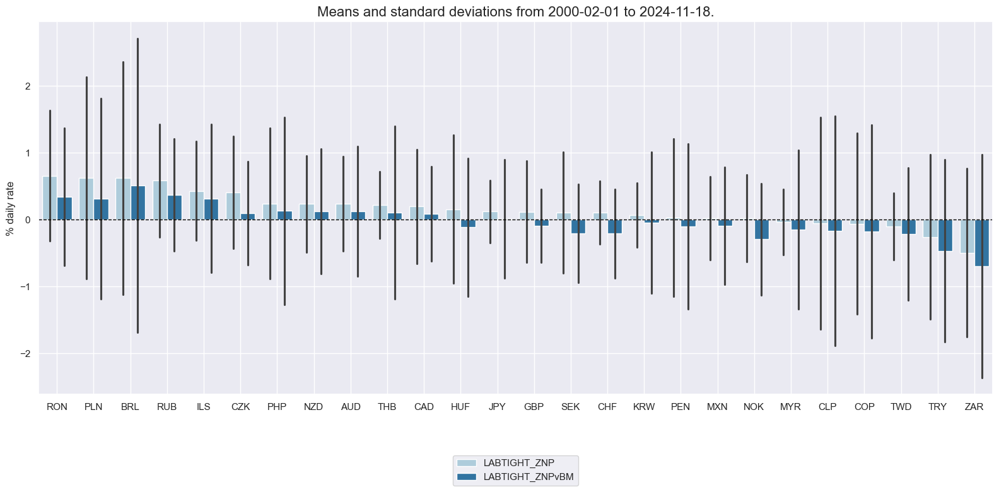

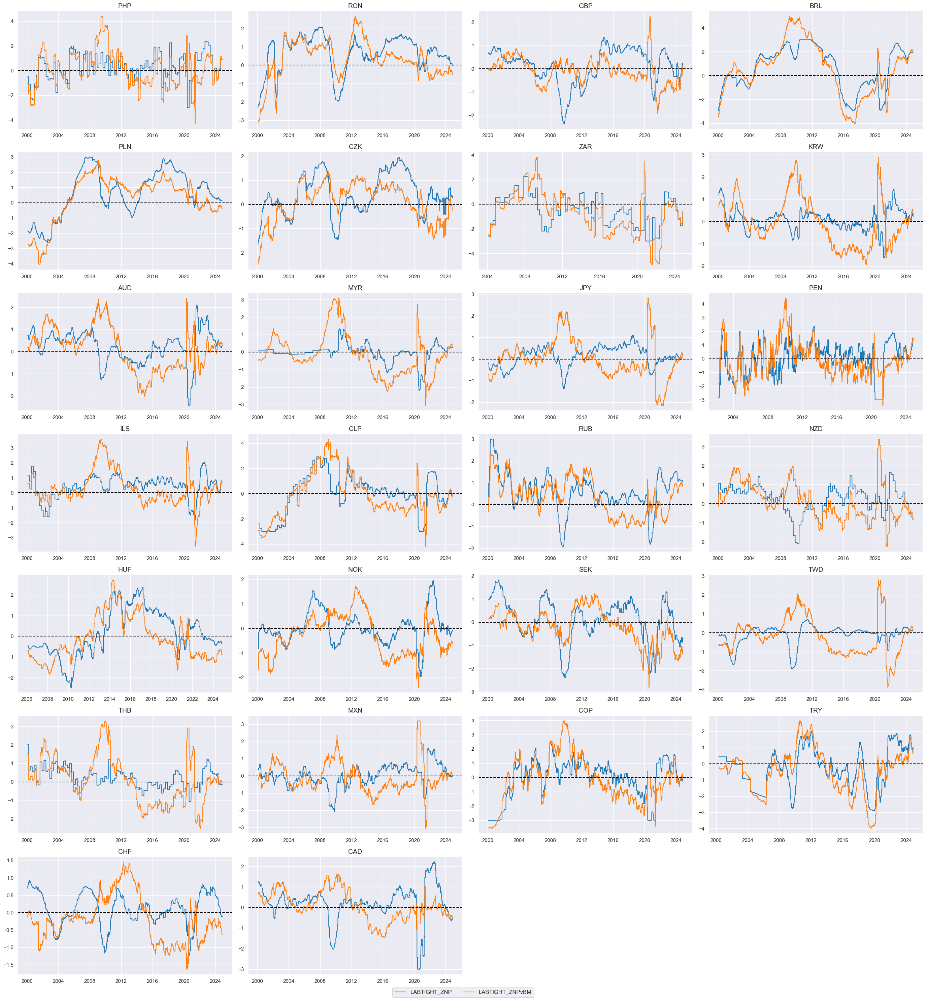

In [31]:
xcatx = ["LABTIGHT_ZNP", "LABTIGHT_ZNPvBM"]
cidx = cids_fx

msp.view_ranges(
    dfx,
    cids=cidx,
    xcats=xcatx,
    kind="bar",
    sort_cids_by="mean",
    ylab="% daily rate",
    start="2000-01-01",
)
msp.view_timelines(
    dfx,
    xcats=xcatx[0:2],
    cids=cidx,
    ncol=4,
    cumsum=False,
    start="2000-01-01",
    same_y=False,
    size=(12, 12),
    all_xticks=True,
 
)

### Composite z-scores

We calculate composite zn-scores of cyclical strength with and without labor market tightness. We also calculate composite zn-score differences to FX base currencies with and without labor market tightness.

In [32]:
# Cyclical strength constituents and list of its keys

d_cs = {
    "G": "INTRGDPv5Y_NSA_P1M1ML12_3MMA",
    "I": "CPI_PCHvIETR",
    "L": "LABTIGHT",
    # "C": "XPCREDITBN_SJA_P1M1ML12",  not so relevant for cyclical strength
}
cs_keys = list(d_cs.keys())


# Available cross-sections

xcatx_znp = [d_cs[i] + "_ZNP" for i in cs_keys]
cidx_znp = msm.common_cids(dfx, xcatx_znp)

xcatx_vbm = [d_cs[i] + "_ZNPvBM" for i in cs_keys]
cidx_vbm = msm.common_cids(dfx, xcatx_vbm)

d_ar = {"_ZNP": cidx_znp, "_ZNPvBM": cidx_vbm}


# Collect all cycle strength key combinations

cs_combs = [combo for r in range(1, 5) for combo in combinations(cs_keys, r)]


# Use key combinations to calculate all possible factor combinations

dfa = pd.DataFrame(columns=dfx.columns).reindex([])

for cs in cs_combs:
    for key, value in d_ar.items():
        xcatx = [
            d_cs[i] + key for i in cs
        ]  # extract absolute or relative xcat combination
        dfaa = msp.linear_composite(
            dfx,
            xcats=xcatx,
            cids=value,
            complete_xcats=False,  # if some categories are missing the score is based on the remaining
            new_xcat="CS" + "".join(cs) + key[4:] + "_ZC",
        )
        dfa = msm.update_df(dfa, dfaa)

dfx = msm.update_df(dfx, dfa)


# Collect factor combinations in lists

cs_all = dfa["xcat"].unique()
cs_dir = [cs for cs in cs_all if "vBM" not in cs]
cs_rel = [cs for cs in cs_all if "vBM" in cs]

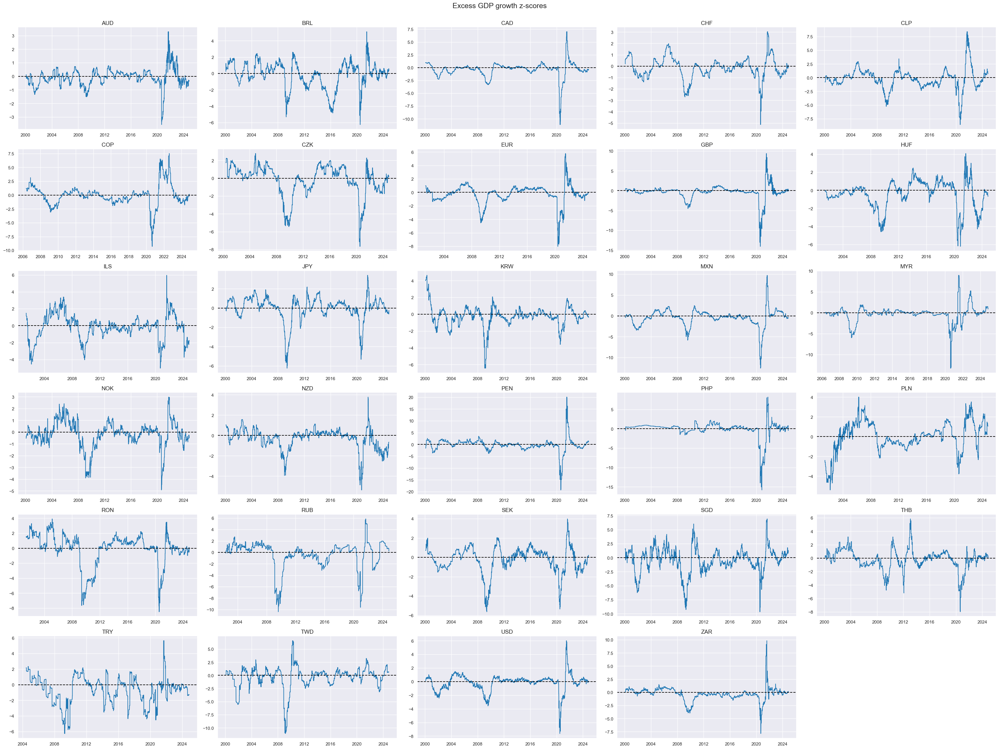

In [33]:
xcatx = ["CSG_ZC"]
cidx = cidx_znp

msp.view_timelines(
    dfx,
    xcats=xcatx[0:2],
    cids=cidx,
    ncol=5,
    cumsum=False,
    start="2000-01-01",
    same_y=False,
    size=(12, 12),
    all_xticks=True,
    title="Excess GDP growth z-scores",
)

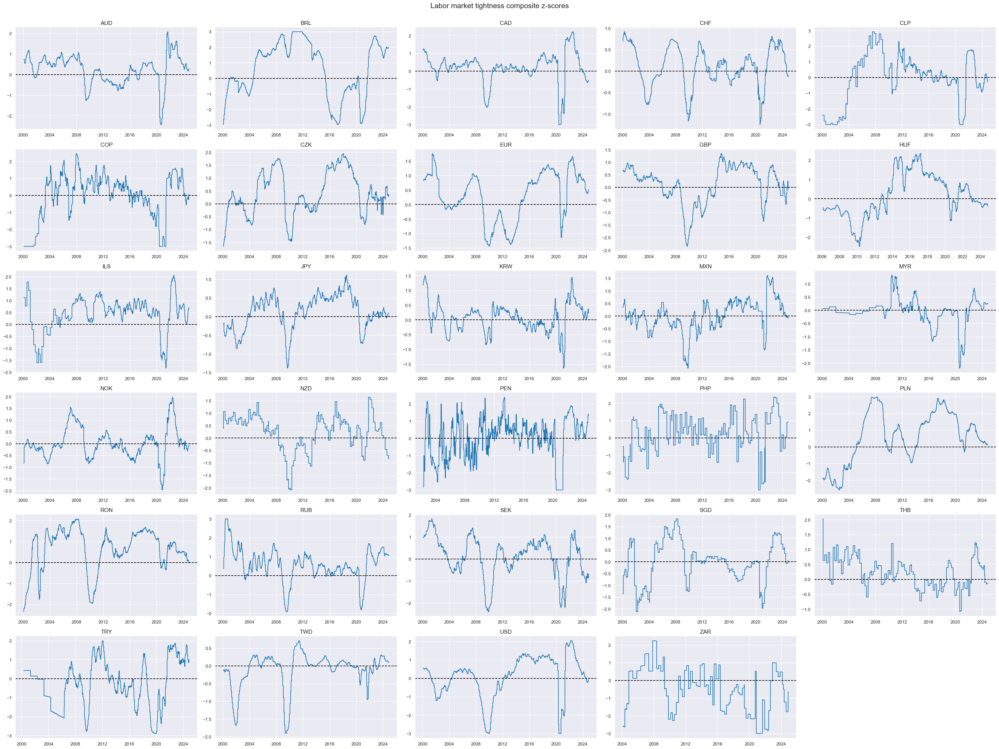

In [34]:
xcatx = ["CSL_ZC"]
cidx = cidx_znp

msp.view_timelines(
    dfx,
    xcats=xcatx[0:2],
    cids=cidx,
    ncol=5,
    cumsum=False,
    start="2000-01-01",
    same_y=False,
    size=(12, 12),
    all_xticks=True,
    title="Labor market tightness composite z-scores",
  
)

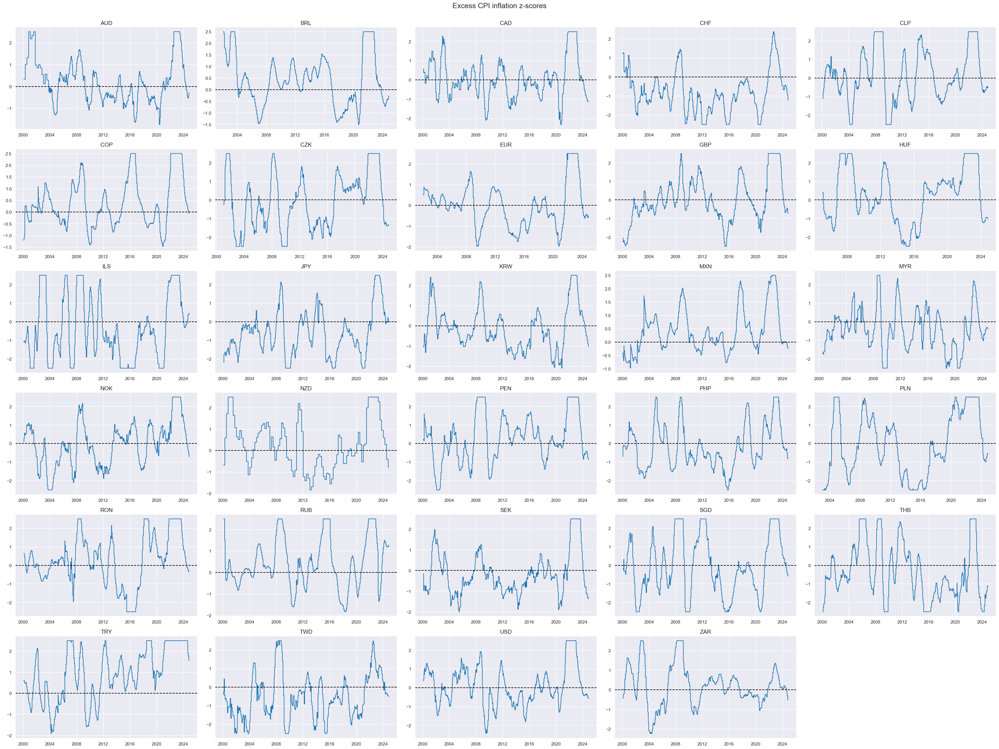

In [35]:
xcatx = ["CSI_ZC"]
cidx = cidx_znp

msp.view_timelines(
    dfx,
    xcats=xcatx[0:2],
    cids=cidx,
    ncol=5,
    cumsum=False,
    start="2000-01-01",
    same_y=False,
     size=(12, 12),
    all_xticks=True,
    title="Excess CPI inflation z-scores",
  )

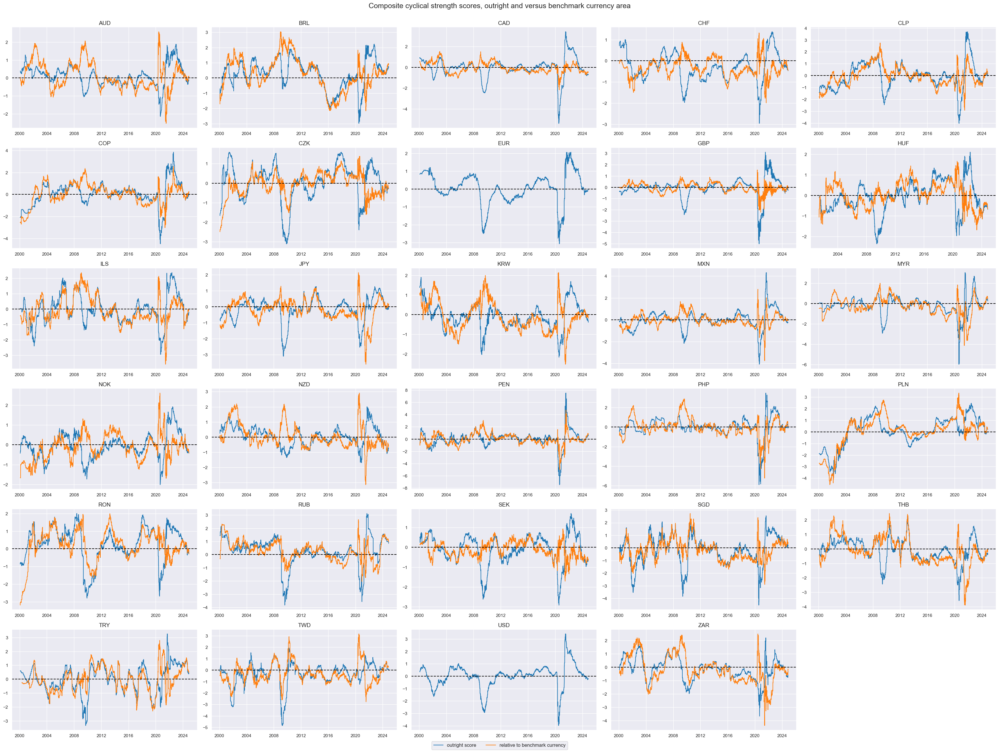

In [36]:
xcatx = ["CSGIL_ZC", "CSGILvBM_ZC"]
cidx = cidx_znp

msp.view_timelines(
    dfx,
    xcats=xcatx[0:2],
    xcat_labels=["outright score", "relative to benchmark currency"],
    cids=cidx,
    ncol=5,
    cumsum=False,
    start="2000-01-01",
    same_y=False,
    size=(12, 12),
    all_xticks=True,
    title="Composite cyclical strength scores, outright and versus benchmark currency area",
   )

## Targets

### Directional vol-targeted IRS returns

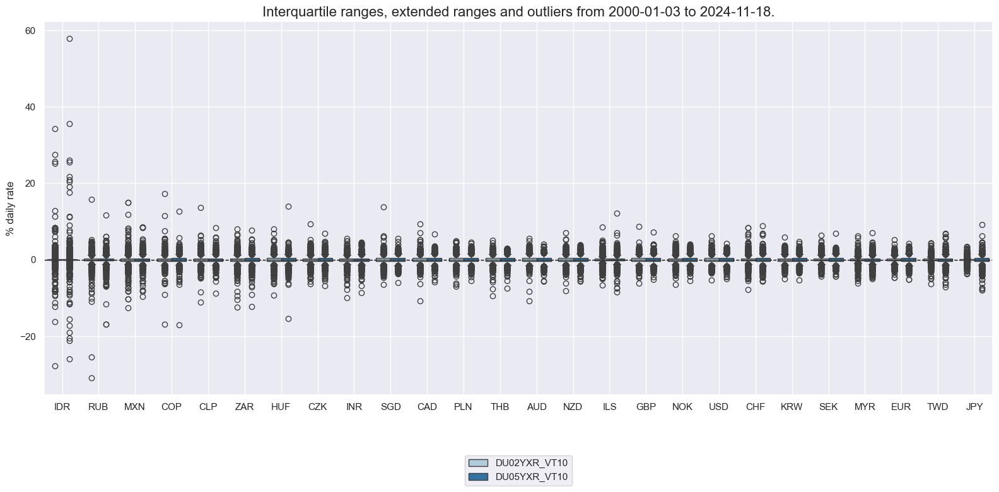

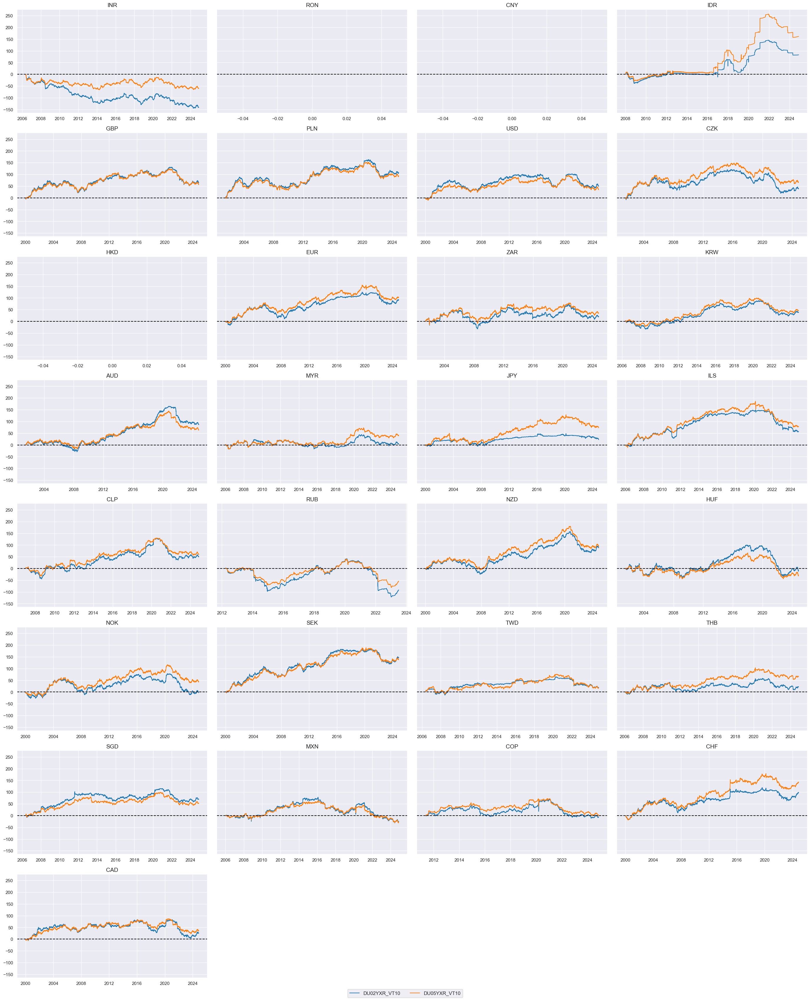

In [37]:
xcatx = ["DU02YXR_VT10", "DU05YXR_VT10"]
cidx = list(set(cids_du) - set(["TRY"]))


msp.view_ranges(
    dfx,
    cids=cidx,
    xcats=xcatx,
    kind="box",
    sort_cids_by="std",
    ylab="% daily rate",
    start="2000-01-01",
)

msp.view_timelines(
    dfx,
    xcats=xcatx,
    cids=cidx,
    ncol=4,
    cumsum=True,
    start="2000-01-01",
    same_y=True,
    size=(12, 12),
    all_xticks=True,
  )

### Directional equity returns

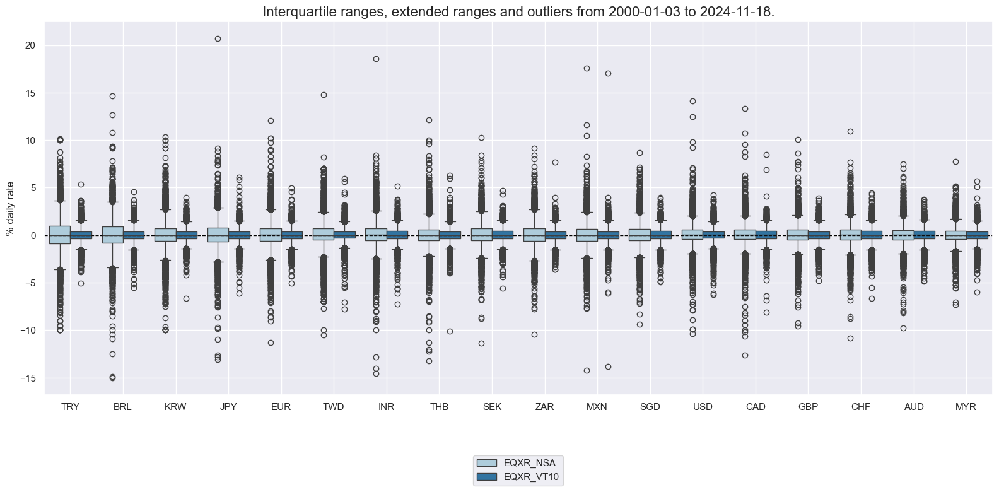

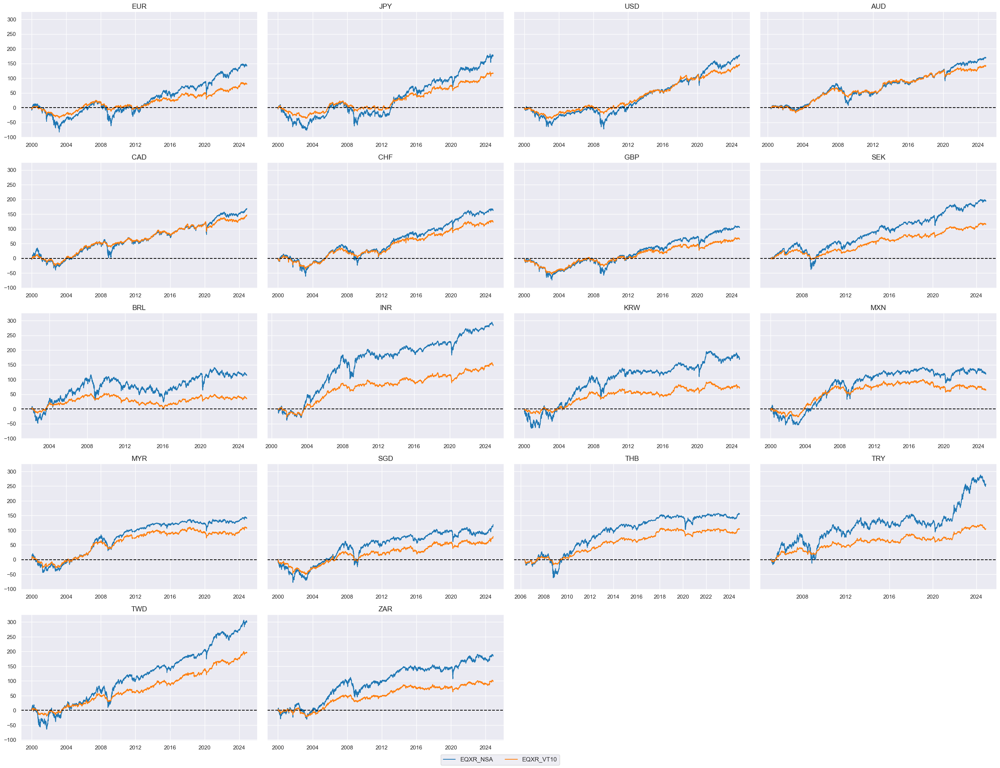

In [38]:
xcatx = ["EQXR_NSA", "EQXR_VT10"]
cidx = cids_eq

msp.view_ranges(
    dfx,
    cids=cidx,
    xcats=xcatx,
    kind="box",
    sort_cids_by="std",
    ylab="% daily rate",
    start="2000-01-01",
)

msp.view_timelines(
    dfx,
    xcats=xcatx,
    cids=cidx,
    ncol=4,
    cumsum=True,
    start="2000-01-01",
    same_y=True,
    size=(12, 12),
    all_xticks=True,
 
)

### FX returns relative to base currencies

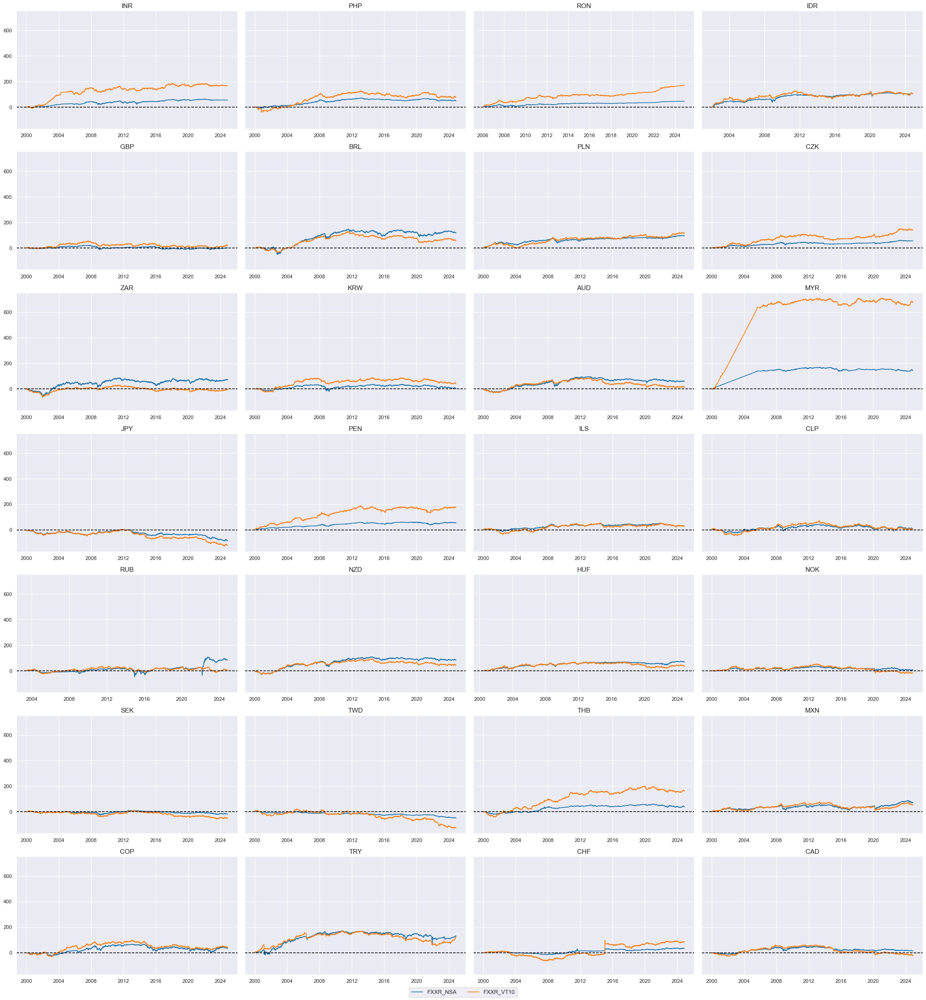

In [39]:
xcatx = ["FXXR_NSA", "FXXR_VT10"]
cidx = cids_fx

msp.view_timelines(
    dfx,
    xcats=xcatx,
    cids=cidx,
    ncol=4,
    cumsum=True,
    start="2000-01-01",
    same_y=True,
    size=(12, 12),
    all_xticks=True,
  
)

### FX versus equity returns

In [40]:
cidx_fxeq = msm.common_cids(dfx, ["FXXR_VT10", "EQXR_VT10"])
calcs = ["FXvEQXR = FXXR_VT10 - EQXR_VT10 "]
dfa = msp.panel_calculator(dfx, calcs=calcs, cids=cidx_fxeq, blacklist=None)
dfx = msm.update_df(dfx, dfa)

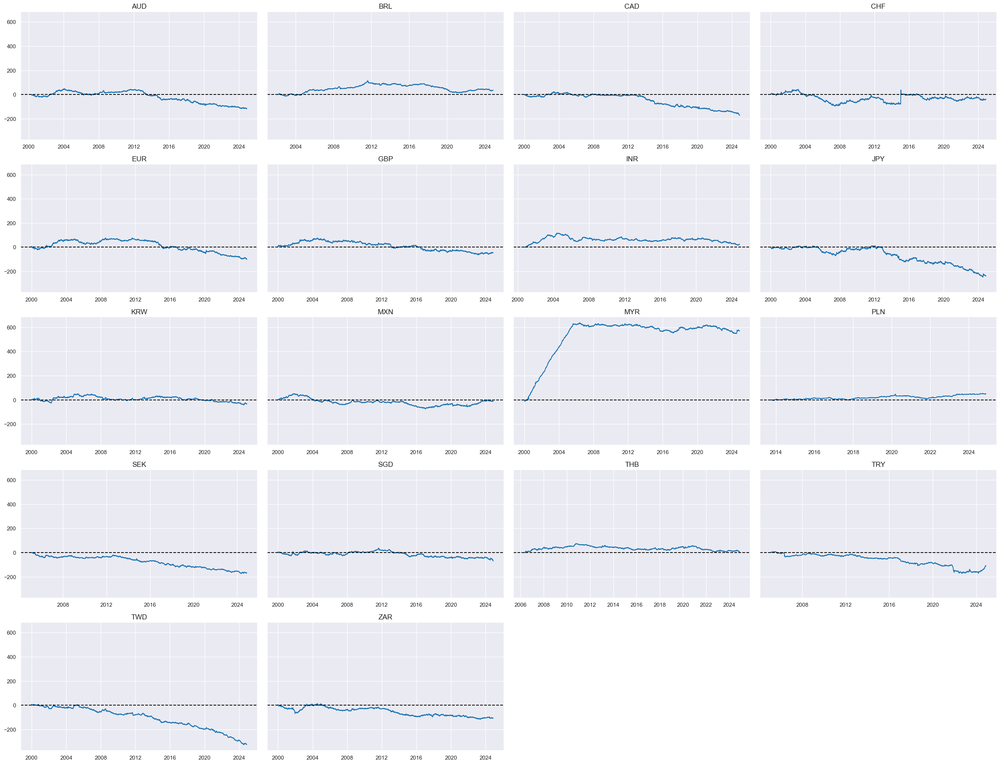

In [41]:
xcatx = ["FXvEQXR"]
cidx = cidx_fxeq

msp.view_timelines(
    dfx,
    xcats=xcatx,
    cids=cidx,
    ncol=4,
    cumsum=True,
    start="2000-01-01",
    same_y=True,
    size=(12, 12),
    all_xticks=True,
)

### FX versus IRS returns

In [42]:
cidx_fxdu = list(
    set(msm.common_cids(dfx, ["FXXR_VT10", "DU05YXR_VT10"])) - set(["IDR"])
)
calcs = ["FXvDU05XR = FXXR_VT10 - DU05YXR_VT10 "]
dfa = msp.panel_calculator(dfx, calcs=calcs, cids=cidx_fxdu, blacklist=dublack)
dfx = msm.update_df(dfx, dfa)

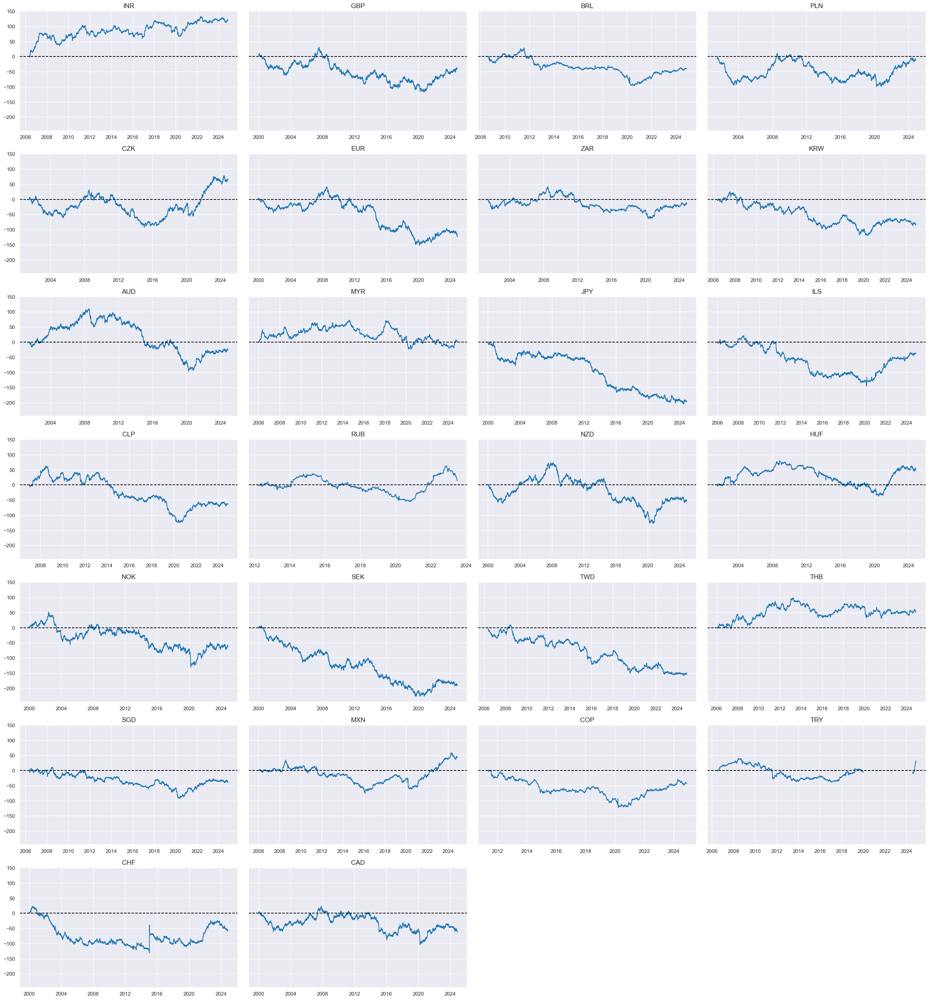

In [43]:
xcatx = ["FXvDU05XR"]
cidx = cidx_fxdu

msp.view_timelines(
    dfx,
    xcats=xcatx,
    cids=cidx,
    ncol=4,
    cumsum=True,
    start="2000-01-01",
    same_y=True,
    size=(12, 12),
    all_xticks=True,
 
)

### 2s-5s flattener returns

In [44]:
cidx_du52 = list(
    set(msm.common_cids(dfx, ["DU02YXR_VT10", "DU05YXR_VT10"])) - set(["IDR"])
)
calcs = ["DU05v02XR = DU05YXR_VT10 - DU02YXR_VT10 "]
dfa = msp.panel_calculator(dfx, calcs=calcs, cids=cidx_du52, blacklist=dublack)
dfx = msm.update_df(dfx, dfa)

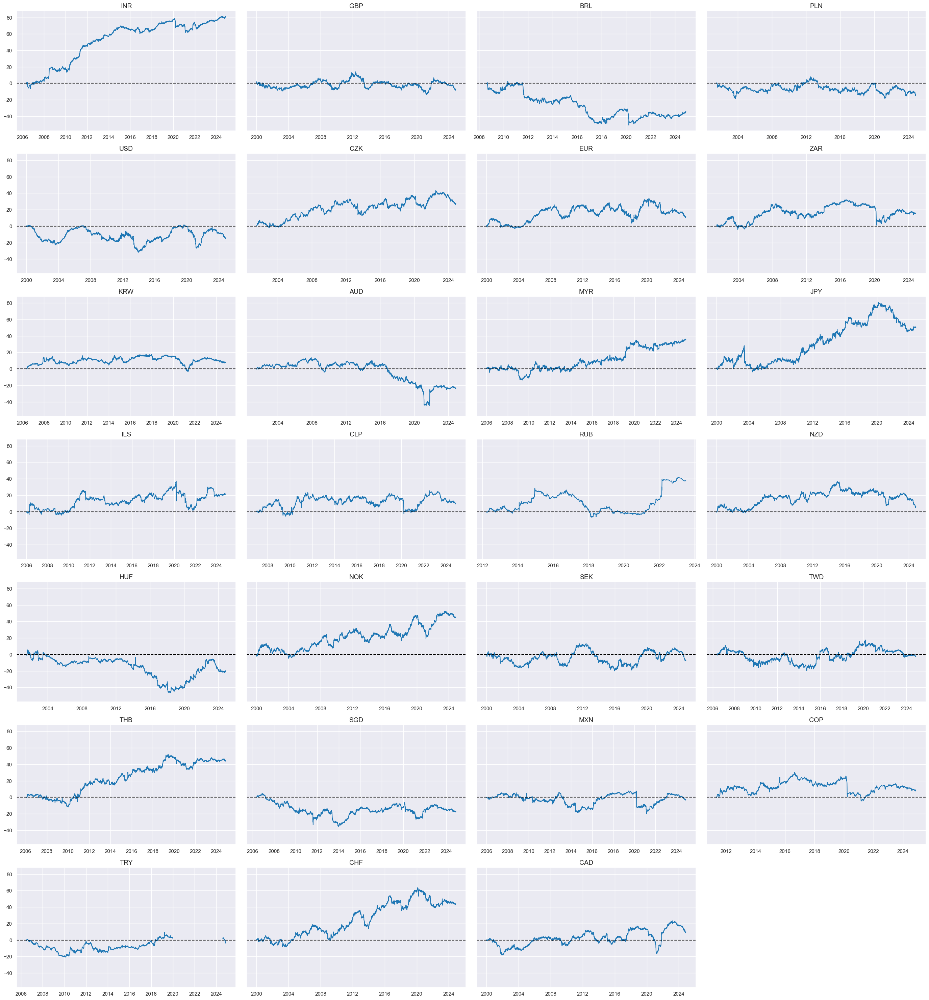

In [45]:
xcatx = ["DU05v02XR"]
cidx = cidx_du52

msp.view_timelines(
    dfx,
    xcats=xcatx,
    cids=cidx,
    ncol=4,
    cumsum=True,
    start="2000-01-01",
    same_y=True,
    size=(12, 12),
    all_xticks=True,
  
)

# Value checks

### Directional equity strategy

#### Specs and panel test

In [46]:
sigs = cs_dir
ms = "CSGIL_ZC"  # main signal
oths = list(set(sigs) - set([ms]))  # other signals

targ = "EQXR_VT10"
cidx = msm.common_cids(dfx, sigs + [targ])
# cidx = list(set(cids_dm) & set(cidx))   # for DM alone

dict_eqdi = {
    "sig": ms,
    "rivs": oths,
    "targ": targ,
    "cidx": cidx,
    "black": fxblack,
    "srr": None,
    "pnls": None,
}

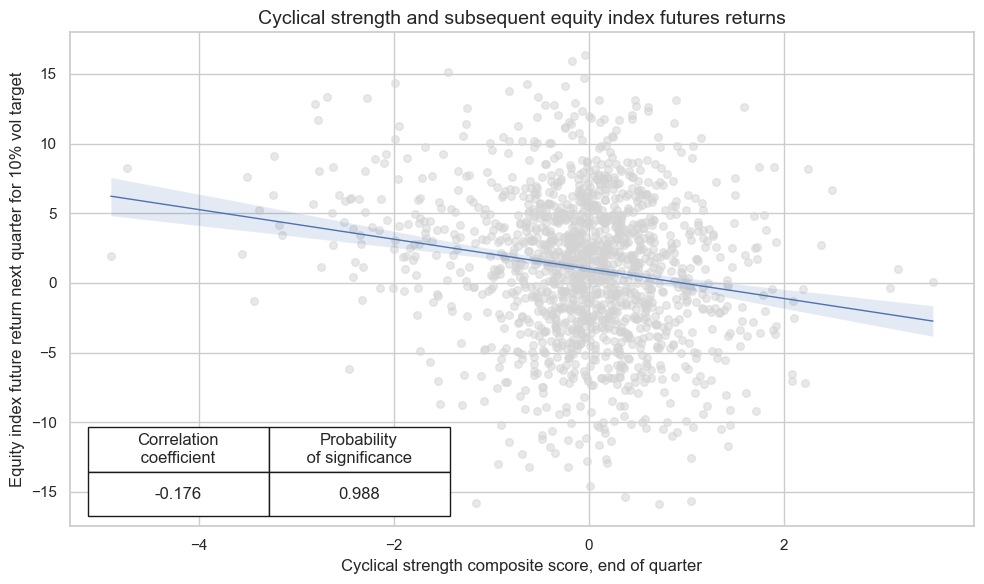

In [47]:
dix = dict_eqdi

sig = dix["sig"]
targ = dix["targ"]
cidx = dix["cidx"]
blax = dix["black"]

crx = msp.CategoryRelations(
    dfx,
    xcats=[sig, targ],
    cids=cidx,
    freq="Q",  # quarterly frequency allows for policy inertia
    lag=1,
    xcat_aggs=["last", "sum"],
    start="2000-01-01",
    blacklist=blax,
    xcat_trims=[None, None],
)
crx.reg_scatter(
    labels=False,
    coef_box="lower left",
    xlab="Cyclical strength composite score, end of quarter",
    ylab="Equity index future return next quarter for 10% vol target",
    title="Cyclical strength and subsequent equity index futures returns",
    size=(10, 6),
    prob_est="map",
)

#### Accuracy and correlation check

In [48]:
dix = dict_eqdi

sig = dix["sig"]
rivs = dix["rivs"]
targ = dix["targ"]
cidx = dix["cidx"]
blax = dix["black"]

srr = mss.SignalReturnRelations(
    dfx,
    cids=cidx,
    sigs=[sig] + rivs,
    sig_neg=[True] + [True] * len(rivs),
    rets=targ,
    freqs="M",
    start="2000-01-01",
    blacklist=blax,
)

dix["srr"] = srr

In [49]:
dix = dict_eqdi
srrx = dix["srr"]
display(srrx.summary_table().astype("float").round(3))

,accuracy,bal_accuracy,pos_sigr,pos_retr,pos_prec,neg_prec,pearson,pearson_pval,kendall,kendall_pval,auc
M: CSGIL_ZC_NEG/last => EQXR_VT10,0.523,0.522,0.506,0.586,0.608,0.437,0.100,0.000,0.053,0.000,0.523
Mean years,0.522,0.511,0.502,0.583,0.592,0.430,0.043,0.450,0.025,0.435,0.508
Positive ratio,0.600,0.560,0.600,0.680,0.800,0.280,0.600,0.360,0.600,0.400,0.560
Mean cids,0.522,0.519,0.505,0.583,0.600,0.437,0.100,0.227,0.051,0.308,0.519
Positive ratio,0.824,0.706,0.471,0.941,0.941,0.059,0.941,0.824,0.765,0.647,0.706


In [50]:
dix = dict_eqdi
srrx = dix["srr"]
display(srrx.signals_table().sort_index().astype("float").round(3))

accuracy  bal_accuracy  \
Return    Signal       Frequency Aggregation                           
EQXR_VT10 CSGIL_ZC_NEG M         last            0.523         0.522   
          CSGI_ZC_NEG  M         last            0.535         0.525   
          CSGL_ZC_NEG  M         last            0.492         0.501   
          CSG_ZC_NEG   M         last            0.515         0.508   
          CSIL_ZC_NEG  M         last            0.527         0.528   
          CSI_ZC_NEG   M         last            0.538         0.529   
          CSL_ZC_NEG   M         last            0.496         0.515   

                                              pos_sigr  pos_retr  pos_prec  \
Return    Signal       Frequency Aggregation                                 
EQXR_VT10 CSGIL_ZC_NEG M         last            0.506     0.586     0.608   
          CSGI_ZC_NEG  M         last            0.555     0.586     0.609   
          CSGL_ZC_NEG  M         last            0.448     0.586     0.587   
          CSG_ZC_NEG   M         last            0.538     0.586     0.593   
          CSIL_ZC_NEG  M         last            0.495     0.586     0.614   
          CSI_ZC_NEG   M         last            0.551     0.586     0.612   
          CSL_ZC_NEG   M         last            0.396     0.586     0.604   

                                              neg_prec  pearson  pearson_pval  \
Return    Signal       Frequency Aggregation                                    
EQXR_VT10 CSGIL_ZC_NEG M         last            0.437    0.100         0.000   
          CSGI_ZC_NEG  M         last            0.442    0.087         0.000   
          CSGL_ZC_NEG  M         last            0.415    0.075         0.000   
          CSG_ZC_NEG   M         last            0.423    0.051         0.001   
          CSIL_ZC_NEG  M         last            0.442    0.108         0.000   
          CSI_ZC_NEG   M         last            0.446    0.084         0.000   
          CSL_ZC_NEG   M         last            0.425    0.082         0.000   

                                              kendall  kendall_pval    auc  
Return    Signal       Frequency Aggregation                                
EQXR_VT10 CSGIL_ZC_NEG M         last           0.053         0.000  0.523  
          CSGI_ZC_NEG  M         last           0.048         0.000  0.526  
          CSGL_ZC_NEG  M         last           0.032         0.002  0.501  
          CSG_ZC_NEG   M         last           0.014         0.171  0.508  
          CSIL_ZC_NEG  M         last           0.063         0.000  0.529  
          CSI_ZC_NEG   M         last           0.049         0.000  0.530  
          CSL_ZC_NEG   M         last           0.046         0.000  0.514

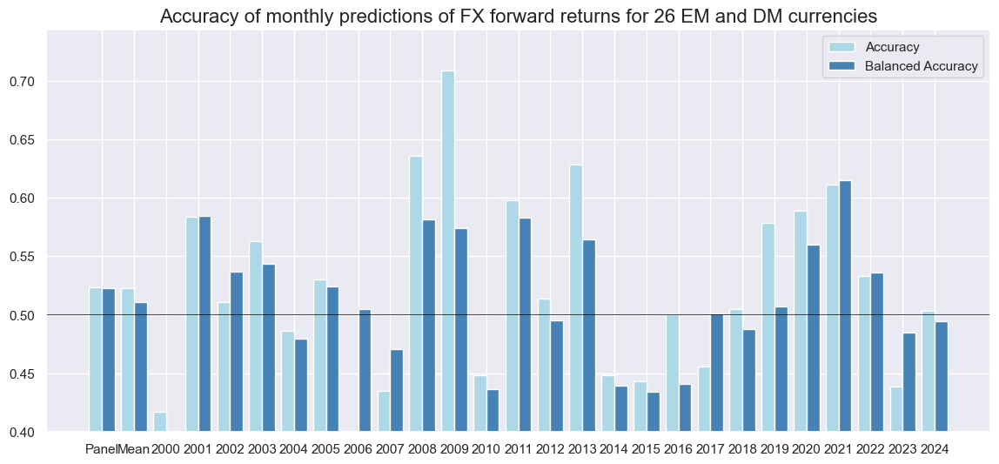

In [51]:
dix = dict_eqdi
srrx = dix["srr"]
srrx.accuracy_bars(
    type="years",
    title="Accuracy of monthly predictions of FX forward returns for 26 EM and DM currencies",
    size=(14, 6),
)

#### Naive PnL

In [52]:
dix = dict_eqdi

sigx = [dix["sig"]] + dix["rivs"]
targ = dix["targ"]
cidx = dix["cidx"]
blax = dix["black"]

naive_pnl = msn.NaivePnL(
    dfx,
    ret=targ,
    sigs=sigx,
    cids=cidx,
    start="2000-01-01",
    blacklist=blax,
    bms=["USD_EQXR_NSA"],
)

for sig in sigx:
    naive_pnl.make_pnl(
        sig,
        sig_neg=True,
        sig_op="zn_score_pan",
        thresh=3,
        rebal_freq="monthly",
        vol_scale=10,
        rebal_slip=1,
        pnl_name=sig + "_PZN",
    )

for sig in sigx:
    naive_pnl.make_pnl(
        sig,
        sig_neg=True,
        sig_op="binary",
        thresh=3,
        rebal_freq="monthly",
        vol_scale=10,
        rebal_slip=1,
        pnl_name=sig + "_BIN",
    )

naive_pnl.make_long_pnl(vol_scale=10, label="Long only")
dix["pnls"] = naive_pnl

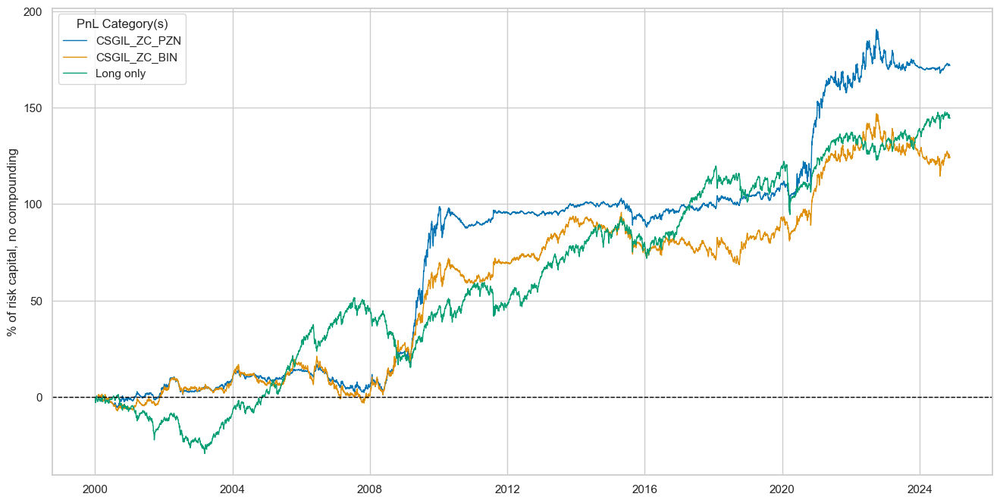

In [53]:
dix = dict_eqdi

sigx = dix["sig"]
naive_pnl = dix["pnls"]
pnls = [sigx + x for x in ["_PZN", "_BIN"]] + ["Long only"]

naive_pnl.plot_pnls(
    pnl_cats=pnls,
    pnl_cids=["ALL"],
    start="2000-01-01",
    title=None,
    xcat_labels=None,
    figsize=(16, 8),
)

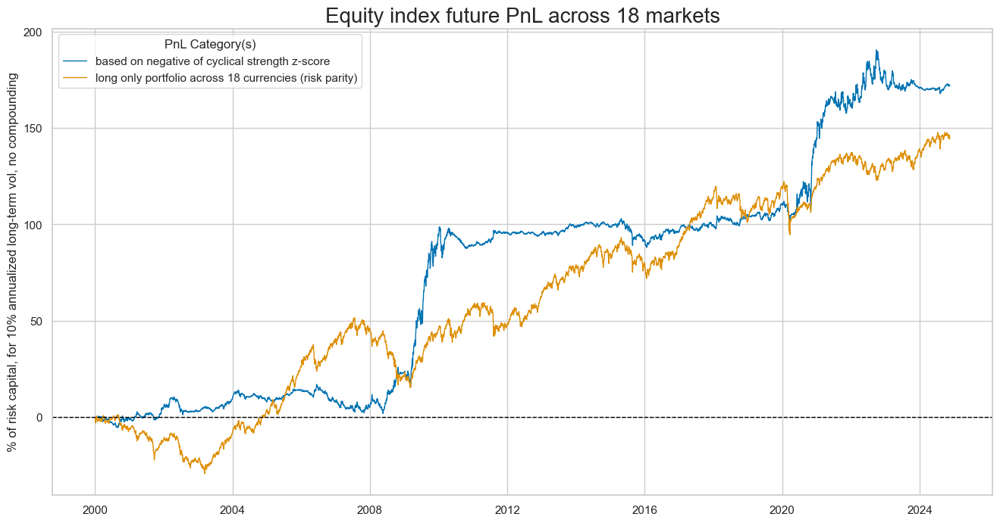

In [54]:
dix = dict_eqdi

sigx = dix["sig"]
naive_pnl = dix["pnls"]
pnls = [sigx + "_PZN"] + ["Long only"]

dict_labels={"CSGIL_ZC_PZN": "based on negative of cyclical strength z-score",
            "Long only": "long only portfolio across 18 currencies (risk parity)"}

naive_pnl.plot_pnls(
    pnl_cats=pnls,
    pnl_cids=["ALL"],
    start="2000-01-01",
    title="Equity index future PnL across 18 markets",
    xcat_labels=dict_labels,
    ylab="% of risk capital, for 10% annualized long-term vol, no compounding",
    figsize=(16, 8),
)

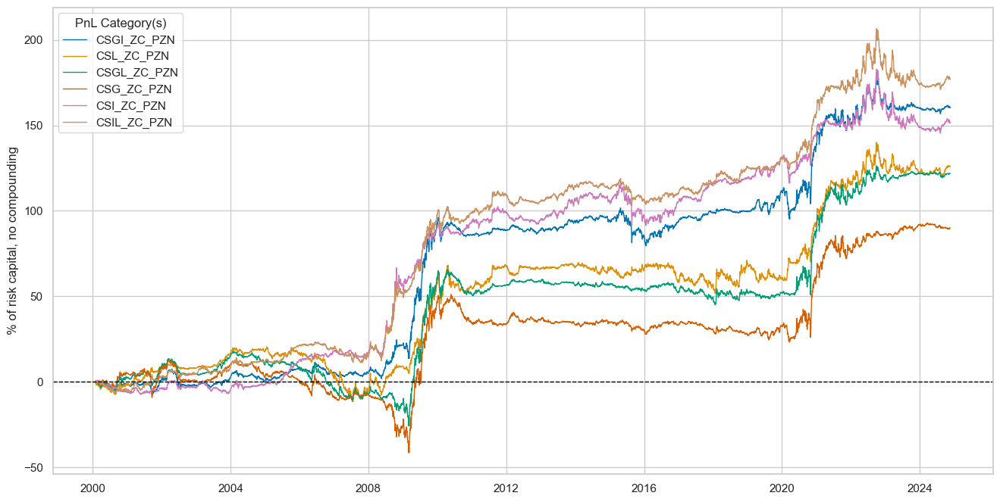

In [55]:
dix = dict_eqdi

sigx = dix["rivs"]
naive_pnl = dix["pnls"]
pnls = [sig + "_PZN" for sig in sigx]

naive_pnl.plot_pnls(
    pnl_cats=pnls,
    pnl_cids=["ALL"],
    start="2000-01-01",
    title=None,
    xcat_labels=None,
    figsize=(16, 8),
)

In [56]:
dix = dict_eqdi

sigx = [dix["sig"]] + dix["rivs"]
naive_pnl = dix["pnls"]
pnls = [sig + type for sig in sigx for type in ["_PZN", "_BIN"]]

df_eval = naive_pnl.evaluate_pnls(
    pnl_cats=pnls,
    pnl_cids=["ALL"],
    start="2000-01-01",
)
display(df_eval.transpose())

,Return %,St. Dev. %,Sharpe Ratio,Sortino Ratio,Max 21-Day Draw %,Max 6-Month Draw %,Peak to Trough Draw %,Top 5% Monthly PnL Share,USD_EQXR_NSA correl,Traded Months
xcat,,,,,,,,,,
CSGIL_ZC_PZN,6.94022,10.0,0.694022,1.056501,-16.166429,-16.223607,-22.790915,0.928508,0.017189,298
CSGI_ZC_PZN,6.477148,10.0,0.647715,0.969935,-15.512794,-16.084488,-22.115923,0.955529,0.10583,298
CSL_ZC_PZN,5.084576,10.0,0.508458,0.763275,-16.256005,-15.15405,-32.059263,1.02996,-0.166519,298
CSGL_ZC_PZN,4.921142,10.0,0.492114,0.755367,-16.141134,-19.189023,-43.66662,1.277214,0.091609,298
CSG_ZC_PZN,3.633014,10.0,0.363301,0.552031,-14.719867,-27.121756,-54.156334,1.680659,0.252896,298
CSI_ZC_PZN,6.113695,10.0,0.61137,0.88192,-19.795761,-24.688366,-37.621333,0.89019,-0.099871,298
CSIL_ZC_PZN,7.147002,10.0,0.7147,1.058185,-19.836399,-23.354137,-35.725208,0.830926,-0.156898,298
CSGIL_ZC_BIN,5.023701,10.0,0.50237,0.731789,-12.466828,-15.689518,-32.402217,0.949469,-0.037476,298
CSGI_ZC_BIN,5.67273,10.0,0.567273,0.81104,-15.337639,-18.773117,-27.927563,0.822128,0.049908,298


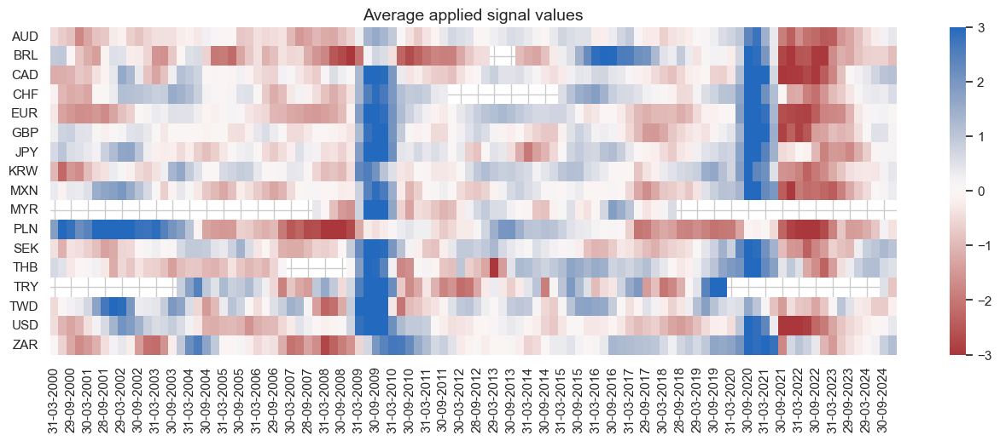

In [57]:
dix = dict_eqdi
sig = dix["sig"]
naive_pnl = dix["pnls"]

naive_pnl.signal_heatmap(
    pnl_name=sig + "_PZN", freq="q", start="2000-01-01", figsize=(16, 5)
)

### Directional FX strategy

#### Specs and panel test

In [58]:
sigs = cs_rel
ms = "CSGILvBM_ZC"  # main signal
oths = list(set(sigs) - set([ms]))  # other signals

targ = "FXXR_VT10"
cidx = msm.common_cids(dfx, sigs + [targ])
# cidx = list(set(cids_dm) & set(cidx))   # for DM alone

dict_fxdi = {
    "sig": ms,
    "rivs": oths,
    "targ": targ,
    "cidx": cidx,
    "black": None,
    "srr": None,
    "pnls": None,
}

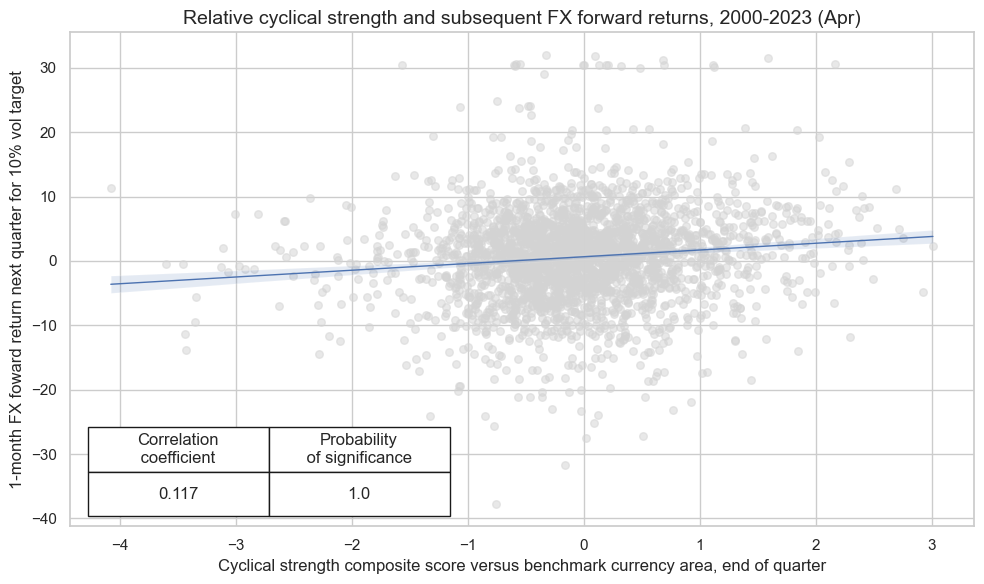

In [59]:
dix = dict_fxdi

sig = dix["sig"]
targ = dix["targ"]
cidx = dix["cidx"]
blax = dix["black"]

crx = msp.CategoryRelations(
    dfx,
    xcats=[sig, targ],
    cids=cidx,
    freq="Q",  # quarterly frequency allows for policy inertia
    lag=1,
    xcat_aggs=["last", "sum"],
    start="2000-01-01",
    blacklist=blax,
    xcat_trims=[1000, 40],
)
crx.reg_scatter(
    labels=False,
    coef_box="lower left",
    xlab="Cyclical strength composite score versus benchmark currency area, end of quarter",
    ylab="1-month FX foward return next quarter for 10% vol target",
    title="Relative cyclical strength and subsequent FX forward returns, 2000-2023 (Apr)",
    size=(10, 6),
    prob_est="map",
)

#### Accuracy and correlation check

In [60]:
dix = dict_fxdi

sig = dix["sig"]
rivs = dix["rivs"]
targ = dix["targ"]
cidx = dix["cidx"]
blax = dix["black"]

srr = mss.SignalReturnRelations(
    dfx,
    cids=cidx,
    sigs=[sig] + rivs,
    rets=targ,
    freqs="M",
    start="2000-01-01",
    blacklist=blax,
)

dix["srr"] = srr

In [61]:
dix = dict_fxdi
srrx = dix["srr"]
display(srrx.summary_table().astype("float").round(3))

,accuracy,bal_accuracy,pos_sigr,pos_retr,pos_prec,neg_prec,pearson,pearson_pval,kendall,kendall_pval,auc
M: CSGILvBM_ZC/last => FXXR_VT10,0.521,0.525,0.456,0.545,0.572,0.478,0.073,0.000,0.049,0.000,0.525
Mean years,0.520,0.517,0.454,0.545,0.561,0.473,0.062,0.319,0.036,0.287,0.515
Positive ratio,0.680,0.720,0.440,0.680,0.760,0.320,0.800,0.680,0.800,0.680,0.720
Mean cids,0.521,0.520,0.459,0.546,0.569,0.472,0.069,0.306,0.042,0.355,0.520
Positive ratio,0.741,0.741,0.296,0.852,0.852,0.333,0.815,0.667,0.778,0.556,0.741


In [62]:
dix = dict_fxdi
srrx = dix["srr"]
display(srrx.signals_table().sort_index().astype("float").round(3))

accuracy  bal_accuracy  pos_sigr  \
Return    Signal      Frequency Aggregation                                     
FXXR_VT10 CSGILvBM_ZC M         last            0.521         0.525     0.456   
          CSGIvBM_ZC  M         last            0.510         0.512     0.469   
          CSGLvBM_ZC  M         last            0.520         0.522     0.478   
          CSGvBM_ZC   M         last            0.512         0.513     0.480   
          CSILvBM_ZC  M         last            0.528         0.531     0.469   
          CSIvBM_ZC   M         last            0.516         0.518     0.470   
          CSLvBM_ZC   M         last            0.526         0.528     0.472   

                                             pos_retr  pos_prec  neg_prec  \
Return    Signal      Frequency Aggregation                                 
FXXR_VT10 CSGILvBM_ZC M         last            0.545     0.572     0.478   
          CSGIvBM_ZC  M         last            0.544     0.557     0.468   
          CSGLvBM_ZC  M         last            0.545     0.568     0.476   
          CSGvBM_ZC   M         last            0.539     0.552     0.474   
          CSILvBM_ZC  M         last            0.544     0.577     0.485   
          CSIvBM_ZC   M         last            0.541     0.561     0.476   
          CSLvBM_ZC   M         last            0.543     0.573     0.484   

                                             pearson  pearson_pval  kendall  \
Return    Signal      Frequency Aggregation                                   
FXXR_VT10 CSGILvBM_ZC M         last           0.073         0.000    0.049   
          CSGIvBM_ZC  M         last           0.051         0.000    0.033   
          CSGLvBM_ZC  M         last           0.059         0.000    0.043   
          CSGvBM_ZC   M         last           0.023         0.048    0.016   
          CSILvBM_ZC  M         last           0.082         0.000    0.056   
          CSIvBM_ZC   M         last           0.054         0.000    0.036   
          CSLvBM_ZC   M         last           0.074         0.000    0.056   

                                             kendall_pval    auc  
Return    Signal      Frequency Aggregation                       
FXXR_VT10 CSGILvBM_ZC M         last                0.000  0.525  
          CSGIvBM_ZC  M         last                0.000  0.512  
          CSGLvBM_ZC  M         last                0.000  0.522  
          CSGvBM_ZC   M         last                0.037  0.513  
          CSILvBM_ZC  M         last                0.000  0.531  
          CSIvBM_ZC   M         last                0.000  0.519  
          CSLvBM_ZC   M         last                0.000  0.528

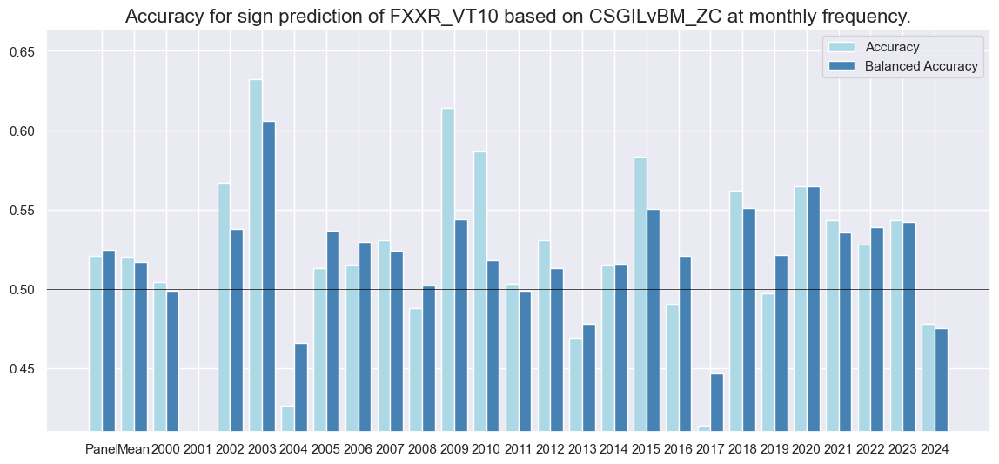

In [63]:
dix = dict_fxdi
srrx = dix["srr"]
srrx.accuracy_bars(
    type="years",
    # title="",
    size=(14, 6),
)

#### Naive PnL

In [64]:
dix = dict_fxdi

sigx = [dix["sig"]] + dix["rivs"]
targ = dix["targ"]
cidx = dix["cidx"]
blax = dix["black"]

naive_pnl = msn.NaivePnL(
    dfx,
    ret=targ,
    sigs=sigx,
    cids=cidx,
    start="2000-01-01",
    blacklist=blax,
    bms=["USD_EQXR_NSA"],
)

for sig in sigx:
    naive_pnl.make_pnl(
        sig,
        sig_neg=False,
        sig_op="zn_score_pan",
        thresh=3,
        rebal_freq="monthly",
        vol_scale=10,
        rebal_slip=1,
        pnl_name=sig + "_PZN",
    )

for sig in sigx:
    naive_pnl.make_pnl(
        sig,
        sig_neg=False,
        sig_op="binary",
        thresh=3,
        rebal_freq="monthly",
        vol_scale=10,
        rebal_slip=1,
        pnl_name=sig + "_BIN",
    )

naive_pnl.make_long_pnl(vol_scale=10, label="Long only")
dix["pnls"] = naive_pnl

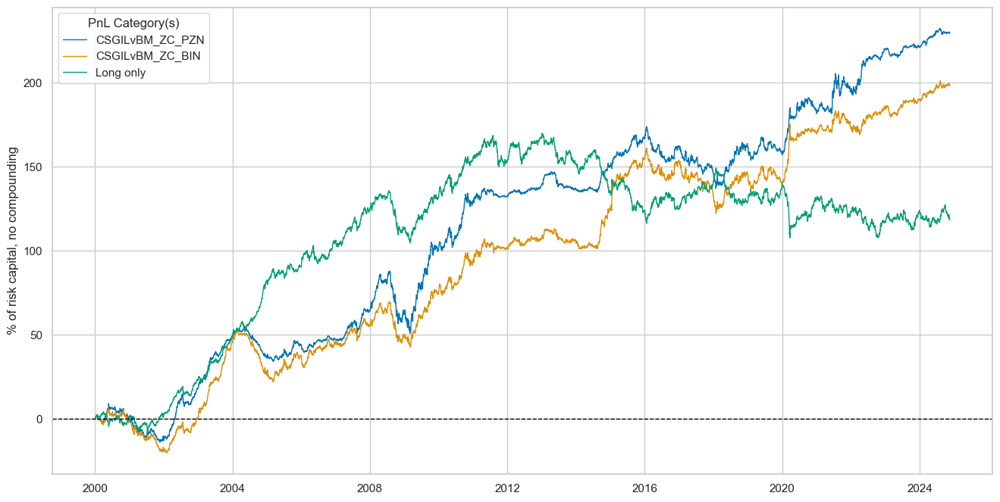

In [65]:
dix = dict_fxdi

sigx = dix["sig"]
naive_pnl = dix["pnls"]
pnls = [sigx + x for x in ["_PZN", "_BIN"]] + ["Long only"]

naive_pnl.plot_pnls(
    pnl_cats=pnls,
    pnl_cids=["ALL"],
    start="2000-01-01",
    title=None,
    xcat_labels=None,
    figsize=(16, 8),
)

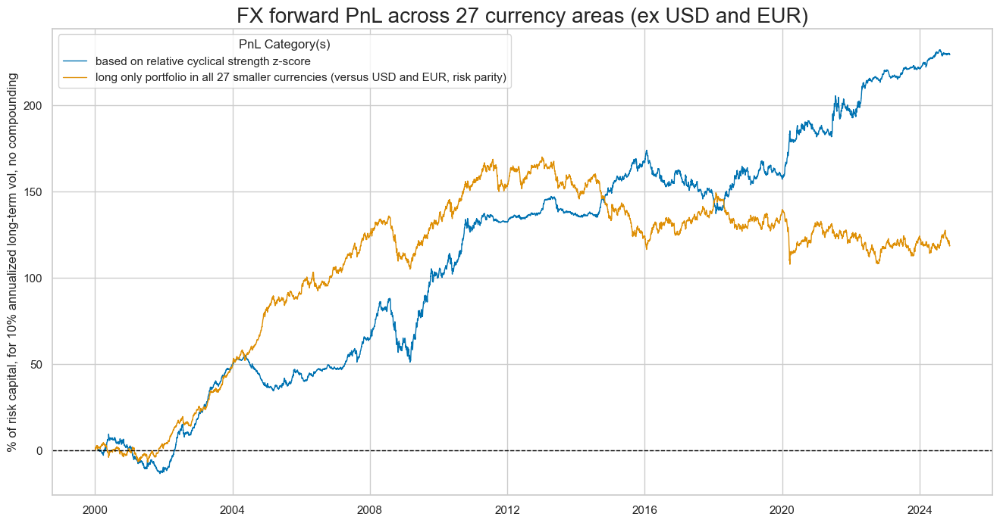

In [66]:
dix = dict_fxdi

sigx = dix["sig"]
naive_pnl = dix["pnls"]
pnls = [sigx + "_PZN"] + ["Long only"]

dict_labels={"CSGILvBM_ZC_PZN":"based on relative cyclical strength z-score",
"Long only": "long only portfolio in all 27 smaller currencies (versus USD and EUR, risk parity)"}

naive_pnl.plot_pnls(
    pnl_cats=pnls,
    pnl_cids=["ALL"],
    start="2000-01-01",
    title="FX forward PnL across 27 currency areas (ex USD and EUR)",
    xcat_labels=dict_labels,
    ylab="% of risk capital, for 10% annualized long-term vol, no compounding",
    figsize=(16, 8),
)

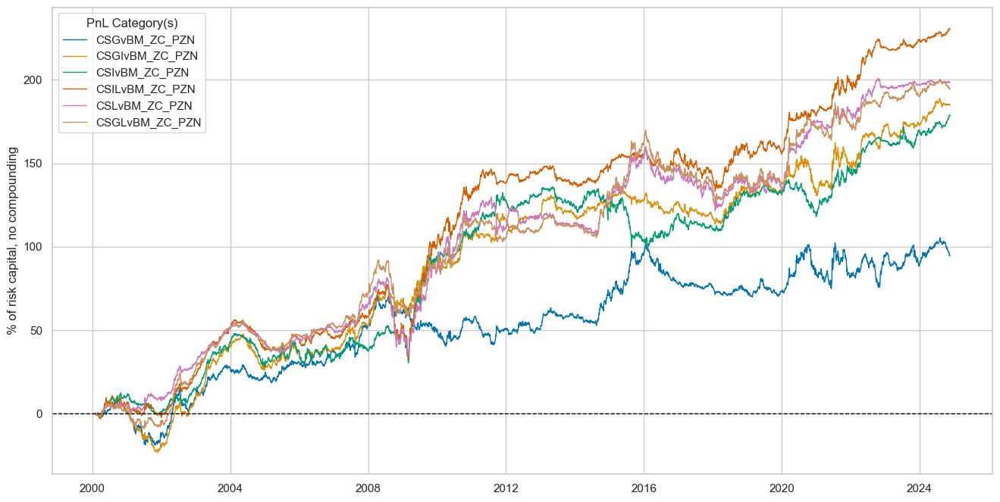

In [67]:
dix = dict_fxdi

sigx = dix["rivs"]
naive_pnl = dix["pnls"]
pnls = [sig + "_PZN" for sig in sigx]

naive_pnl.plot_pnls(
    pnl_cats=pnls,
    pnl_cids=["ALL"],
    start="2000-01-01",
    title=None,
    xcat_labels=None,
    figsize=(16, 8),
)

In [68]:
dix = dict_fxdi

sigx = [dix["sig"]] + dix["rivs"]
naive_pnl = dix["pnls"]
pnls = [sig + type for sig in sigx for type in ["_PZN", "_BIN"]]

df_eval = naive_pnl.evaluate_pnls(
    pnl_cats=pnls,
    pnl_cids=["ALL"],
    start="2000-01-01",
)
display(df_eval.transpose())

,Return %,St. Dev. %,Sharpe Ratio,Sortino Ratio,Max 21-Day Draw %,Max 6-Month Draw %,Peak to Trough Draw %,Top 5% Monthly PnL Share,USD_EQXR_NSA correl,Traded Months
xcat,,,,,,,,,,
CSGILvBM_ZC_PZN,9.261088,10.0,0.926109,1.382363,-15.673803,-29.756144,-37.090776,0.570461,0.066619,298
CSGvBM_ZC_PZN,3.827413,10.0,0.382741,0.557852,-14.212981,-22.414324,-32.459905,1.31609,-0.043541,298
CSGIvBM_ZC_PZN,7.456637,10.0,0.745664,1.115362,-10.217006,-22.244731,-34.453754,0.738076,0.058735,298
CSIvBM_ZC_PZN,7.197503,10.0,0.71975,1.069246,-14.530983,-25.393154,-37.485675,0.716886,0.121809,298
CSILvBM_ZC_PZN,9.288838,10.0,0.928884,1.380198,-17.483943,-31.51101,-45.263751,0.587457,0.105013,298
CSLvBM_ZC_PZN,8.007575,10.0,0.800757,1.167653,-21.942334,-39.163553,-46.777365,0.67673,0.060382,298
CSGLvBM_ZC_PZN,7.844372,10.0,0.784437,1.163382,-16.817638,-30.414612,-43.802041,0.691028,0.015146,298
CSGILvBM_ZC_BIN,8.00653,10.0,0.800653,1.200041,-11.132284,-22.971975,-38.928926,0.66176,0.018296,298
CSGvBM_ZC_BIN,4.778669,10.0,0.477867,0.683746,-15.351668,-18.663776,-25.745332,1.076229,-0.054738,298


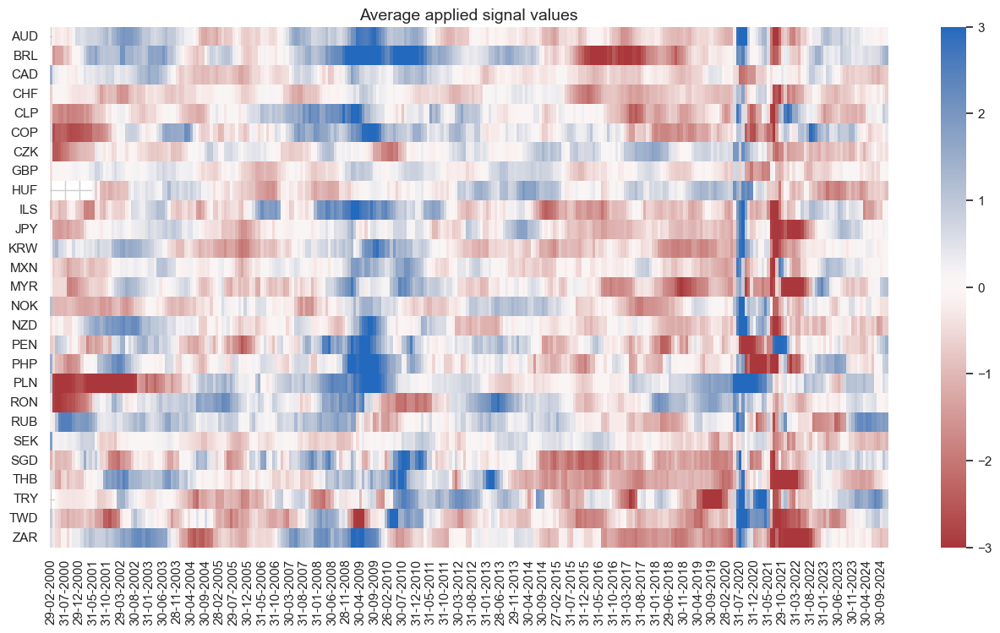

In [69]:
dix = dict_fxdi
sig = dix["sig"]
naive_pnl = dix["pnls"]

naive_pnl.signal_heatmap(
    pnl_name=sig + "_PZN", freq="m", start="2000-01-01", figsize=(16, 8)
)

### Directional IRS strategy

#### Specs and panel test

In [70]:
sigs = cs_dir
ms = "CSGIL_ZC"  # main signal
oths = list(set(sigs) - set([ms]))  # other signals

targ = "DU05YXR_VT10"  # "DU02YXR_VT10"
cidx = msm.common_cids(dfx, sigs + [targ])
# cidx = list(set(cids_dm) & set(cidx))   # for DM alone

dict_dudi = {
    "sig": ms,
    "rivs": oths,
    "targ": targ,
    "cidx": cidx,
    "black": dublack,
    "srr": None,
    "pnls": None,
}

In [71]:
dix = dict_dudi
cidx = dix["cidx"]
print(len(cidx))
", ".join(cidx)

26


'AUD, BRL, CAD, CHF, CLP, COP, CZK, EUR, GBP, HUF, ILS, JPY, KRW, MXN, MYR, NOK, NZD, PLN, RUB, SEK, SGD, THB, TRY, TWD, USD, ZAR'

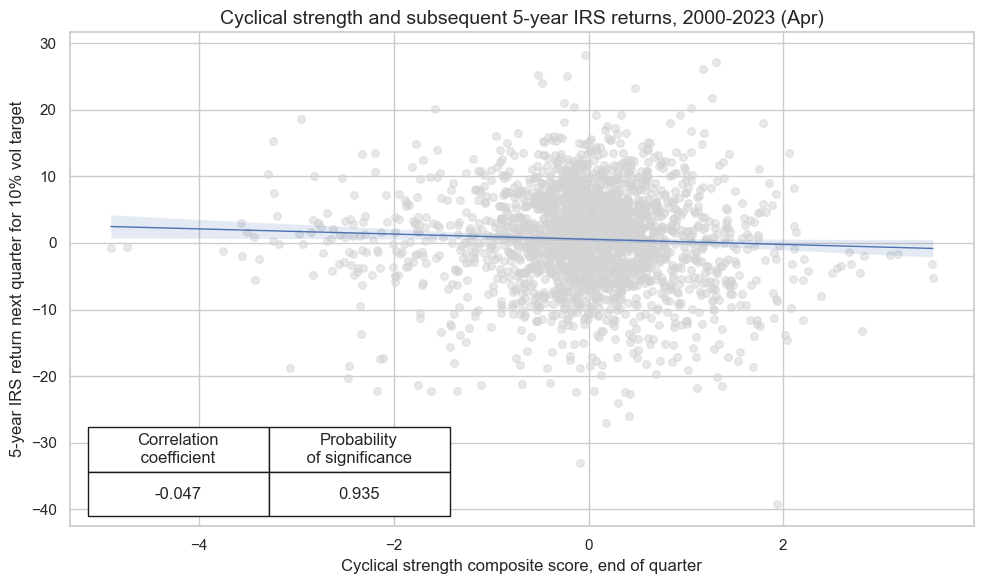

In [72]:
dix = dict_dudi

sig = dix["sig"]
targ = dix["targ"]
cidx = dix["cidx"]
blax = dix["black"]

crx = msp.CategoryRelations(
    dfx,
    xcats=[sig, targ],
    cids=cidx,
    freq="Q",
    lag=1,
    xcat_aggs=["last", "sum"],
    start="2000-01-01",
    blacklist=blax,
    xcat_trims=[None, None],
)
crx.reg_scatter(
    labels=False,
    coef_box="lower left",
    xlab="Cyclical strength composite score, end of quarter",
    ylab="5-year IRS return next quarter for 10% vol target",
    title="Cyclical strength and subsequent 5-year IRS returns, 2000-2023 (Apr)",
    size=(10, 6),
    prob_est="map",
)

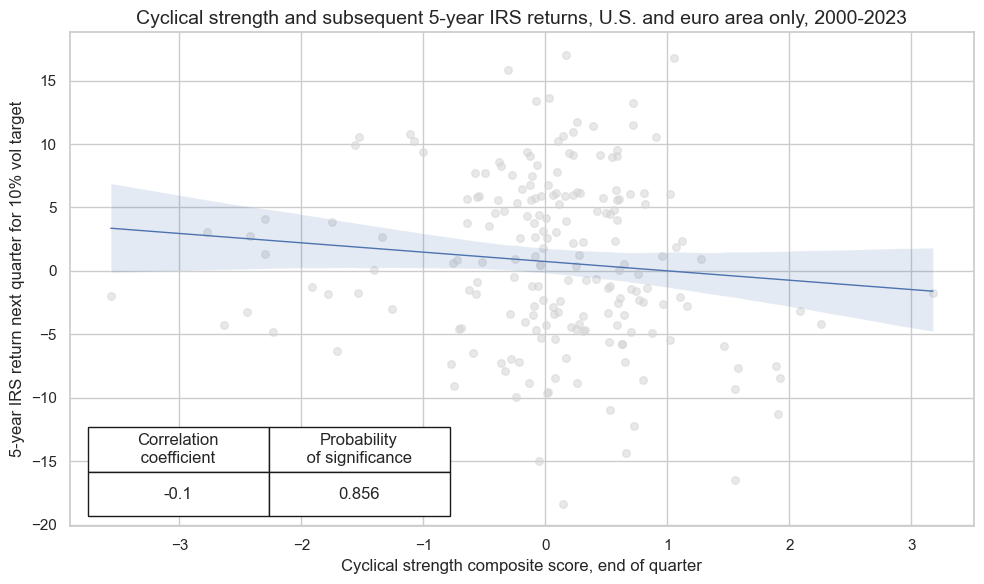

In [73]:
dix = dict_dudi

sig = dix["sig"]
targ = dix["targ"]
cidx = ["EUR", "USD"]
blax = dix["black"]

crx = msp.CategoryRelations(
    dfx,
    xcats=[sig, targ],
    cids=cidx,
    freq="Q",
    lag=1,
    xcat_aggs=["last", "sum"],
    start="2000-01-01",
    blacklist=blax,
    xcat_trims=[None, None],
)
crx.reg_scatter(
    labels=False,
    coef_box="lower left",
    xlab="Cyclical strength composite score, end of quarter",
    ylab="5-year IRS return next quarter for 10% vol target",
    title="Cyclical strength and subsequent 5-year IRS returns, U.S. and euro area only, 2000-2023",
    size=(10, 6),
    prob_est="map",
)

#### Accuracy and correlation check

In [74]:
dix = dict_dudi

sig = dix["sig"]
rivs = dix["rivs"]
targ = dix["targ"]
cidx = dix["cidx"]
blax = dix["black"]

srr = mss.SignalReturnRelations(
    dfx,
    cids=cidx,
    sigs=[sig] + rivs,
    sig_neg=[True] + [True] * len(rivs),
    rets=targ,
    freqs="M",
    start="2000-01-01",
    blacklist=blax,
)

dix["srr"] = srr

In [75]:
dix = dict_dudi
srrx = dix["srr"]
display(srrx.summary_table().astype("float").round(3))

,accuracy,bal_accuracy,pos_sigr,pos_retr,pos_prec,neg_prec,pearson,pearson_pval,kendall,kendall_pval,auc
M: CSGIL_ZC_NEG/last => DU05YXR_VT10,0.527,0.527,0.502,0.546,0.573,0.482,0.046,0.000,0.034,0.000,0.527
Mean years,0.520,0.514,0.496,0.556,0.571,0.457,0.017,0.385,0.017,0.391,0.513
Positive ratio,0.640,0.680,0.480,0.800,0.760,0.360,0.560,0.400,0.560,0.440,0.680
Mean cids,0.527,0.527,0.498,0.544,0.572,0.482,0.045,0.457,0.032,0.485,0.527
Positive ratio,0.885,0.923,0.462,0.962,1.000,0.308,0.808,0.538,0.846,0.500,0.923


Labor market dynamics are good predictors, labor market status is not, supporting the hypothesis that fixed-income markets are only inattentive to recent dynamics but not to the broad state of the economy.

In [76]:
dix = dict_dudi
srrx = dix["srr"]
display(srrx.signals_table().sort_index().astype("float").round(3))

accuracy  bal_accuracy  \
Return       Signal       Frequency Aggregation                           
DU05YXR_VT10 CSGIL_ZC_NEG M         last            0.527         0.527   
             CSGI_ZC_NEG  M         last            0.529         0.524   
             CSGL_ZC_NEG  M         last            0.513         0.516   
             CSG_ZC_NEG   M         last            0.516         0.512   
             CSIL_ZC_NEG  M         last            0.520         0.521   
             CSI_ZC_NEG   M         last            0.525         0.522   
             CSL_ZC_NEG   M         last            0.502         0.514   

                                                 pos_sigr  pos_retr  pos_prec  \
Return       Signal       Frequency Aggregation                                 
DU05YXR_VT10 CSGIL_ZC_NEG M         last            0.502     0.546     0.573   
             CSGI_ZC_NEG  M         last            0.562     0.546     0.567   
             CSGL_ZC_NEG  M         last            0.462     0.546     0.563   
             CSG_ZC_NEG   M         last            0.549     0.546     0.556   
             CSIL_ZC_NEG  M         last            0.484     0.546     0.568   
             CSI_ZC_NEG   M         last            0.536     0.545     0.565   
             CSL_ZC_NEG   M         last            0.377     0.545     0.563   

                                                 neg_prec  pearson  \
Return       Signal       Frequency Aggregation                      
DU05YXR_VT10 CSGIL_ZC_NEG M         last            0.482    0.046   
             CSGI_ZC_NEG  M         last            0.482    0.049   
             CSGL_ZC_NEG  M         last            0.469    0.035   
             CSG_ZC_NEG   M         last            0.467    0.033   
             CSIL_ZC_NEG  M         last            0.475    0.040   
             CSI_ZC_NEG   M         last            0.479    0.035   
             CSL_ZC_NEG   M         last            0.465    0.026   

                                                 pearson_pval  kendall  \
Return       Signal       Frequency Aggregation                          
DU05YXR_VT10 CSGIL_ZC_NEG M         last                0.000    0.034   
             CSGI_ZC_NEG  M         last                0.000    0.033   
             CSGL_ZC_NEG  M         last                0.004    0.033   
             CSG_ZC_NEG   M         last                0.007    0.029   
             CSIL_ZC_NEG  M         last                0.001    0.030   
             CSI_ZC_NEG   M         last                0.004    0.027   
             CSL_ZC_NEG   M         last                0.040    0.026   

                                                 kendall_pval    auc  
Return       Signal       Frequency Aggregation                       
DU05YXR_VT10 CSGIL_ZC_NEG M         last                0.000  0.527  
             CSGI_ZC_NEG  M         last                0.000  0.524  
             CSGL_ZC_NEG  M         last                0.000  0.516  
             CSG_ZC_NEG   M         last                0.000  0.512  
             CSIL_ZC_NEG  M         last                0.000  0.522  
             CSI_ZC_NEG   M         last                0.001  0.522  
             CSL_ZC_NEG   M         last                0.002  0.513

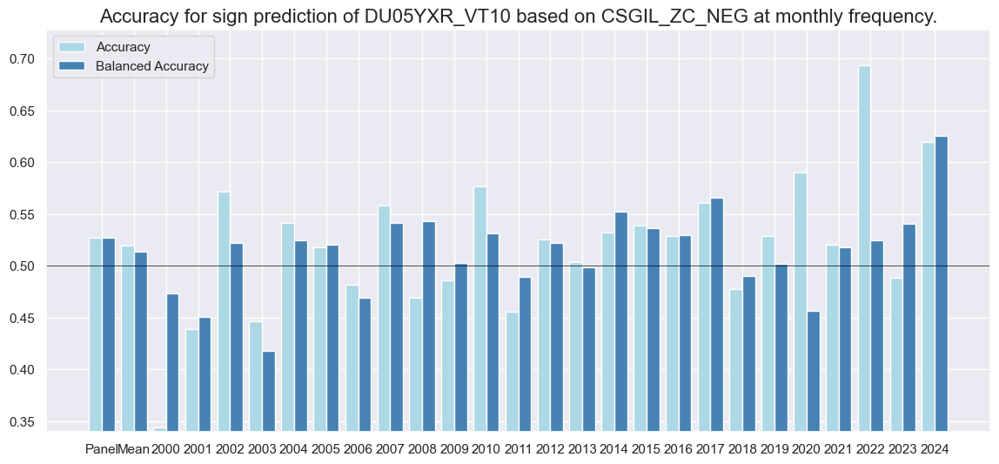

In [77]:
dix = dict_dudi
srrx = dix["srr"]
srrx.accuracy_bars(
    type="years",
    # title="Accuracy of monthly predictions of FX forward returns for 26 EM and DM currencies",
    size=(14, 6),
)

#### Naive PnL

In [78]:
dix = dict_dudi

sigx = [dix["sig"]] + dix["rivs"]
targ = dix["targ"]
cidx = dix["cidx"]
blax = dix["black"]

naive_pnl = msn.NaivePnL(
    dfx,
    ret=targ,
    sigs=sigx,
    cids=cidx,
    start="2000-01-01",
    blacklist=blax,
    bms=["USD_EQXR_NSA", "USD_DU05YXR_VT10"],
)

for sig in sigx:
    naive_pnl.make_pnl(
        sig,
        sig_neg=True,
        sig_op="zn_score_pan",
        thresh=3,
        rebal_freq="monthly",
        vol_scale=10,
        rebal_slip=1,
        pnl_name=sig + "_PZN",
    )

for sig in sigx:
    naive_pnl.make_pnl(
        sig,
        sig_neg=True,
        sig_op="binary",
        thresh=3,
        rebal_freq="monthly",
        vol_scale=10,
        rebal_slip=1,
        pnl_name=sig + "_BIN",
    )

naive_pnl.make_long_pnl(vol_scale=10, label="Long only")
dix["pnls"] = naive_pnl

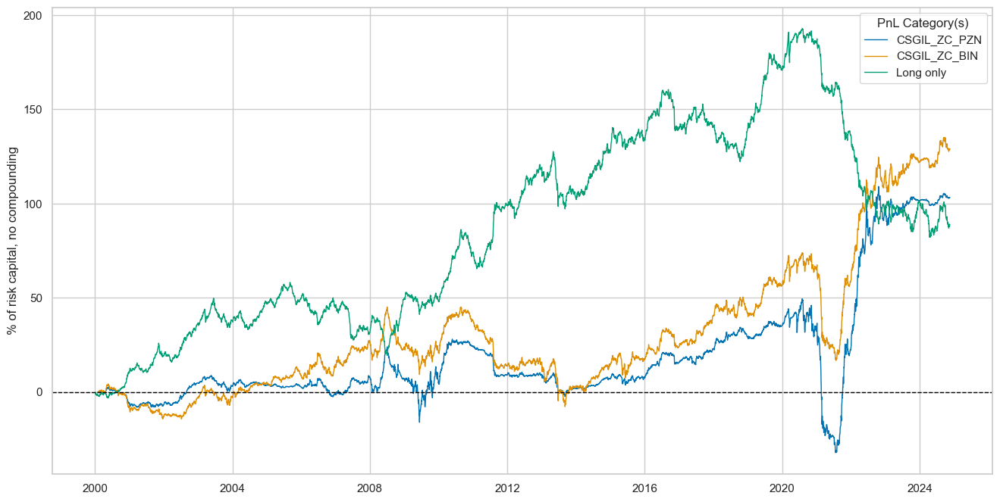

In [79]:
dix = dict_dudi

sigx = dix["sig"]
naive_pnl = dix["pnls"]
pnls = [sigx + x for x in ["_PZN", "_BIN"]] + ["Long only"]

naive_pnl.plot_pnls(
    pnl_cats=pnls,
    pnl_cids=["ALL"],
    start="2000-01-01",
    title=None,
    xcat_labels=None,
    figsize=(16, 8),
)

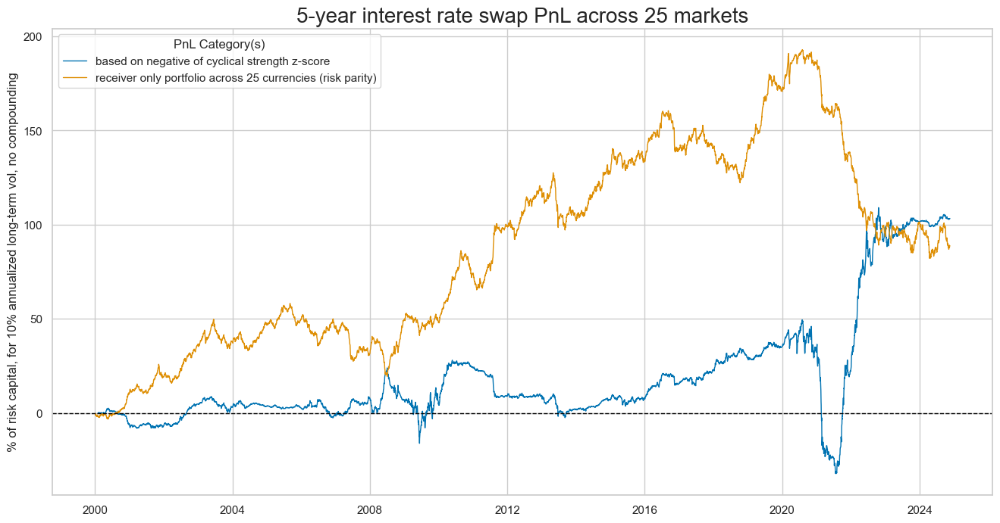

In [80]:
dix = dict_dudi

sigx = dix["sig"]
naive_pnl = dix["pnls"]
pnls = [sigx + "_PZN"] + ["Long only"]

dict_labels={"CSGIL_ZC_PZN":"based on negative of cyclical strength z-score",
"Long only": "receiver only portfolio across 25 currencies (risk parity)"}

naive_pnl.plot_pnls(
    pnl_cats=pnls,
    pnl_cids=["ALL"],
    start="2000-01-01",
    title="5-year interest rate swap PnL across 25 markets",
    xcat_labels=dict_labels,
    ylab="% of risk capital, for 10% annualized long-term vol, no compounding",
    figsize=(16, 8),
)

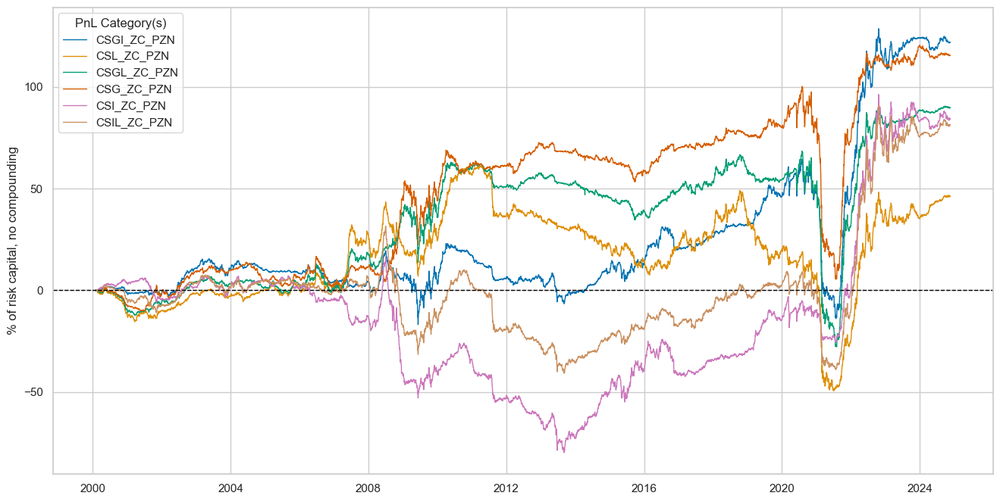

In [81]:
dix = dict_dudi

sigx = dix["rivs"]
naive_pnl = dix["pnls"]
pnls = [sig + "_PZN" for sig in sigx]

naive_pnl.plot_pnls(
    pnl_cats=pnls,
    pnl_cids=["ALL"],
    start="2000-01-01",
    title=None,
    xcat_labels=None,
    figsize=(16, 8),
)

In [82]:
dix = dict_dudi

sigx = [dix["sig"]] + dix["rivs"]
naive_pnl = dix["pnls"]
pnls = [sig + type for sig in sigx for type in ["_PZN", "_BIN"]]

df_eval = naive_pnl.evaluate_pnls(
    pnl_cats=pnls,
    pnl_cids=["ALL"],
    start="2000-01-01",
)
display(df_eval.transpose())

,Return %,St. Dev. %,Sharpe Ratio,Sortino Ratio,Max 21-Day Draw %,Max 6-Month Draw %,Peak to Trough Draw %,Top 5% Monthly PnL Share,USD_EQXR_NSA correl,USD_DU05YXR_VT10 correl,Traded Months
xcat,,,,,,,,,,,
CSGIL_ZC_PZN,4.16784,10.0,0.416784,0.575774,-45.793736,-67.90159,-81.675222,1.833909,-0.047435,-0.005533,298
CSGI_ZC_PZN,4.923035,10.0,0.492303,0.688027,-42.362385,-63.929288,-78.310767,1.560824,-0.069614,0.082674,298
CSL_ZC_PZN,1.874711,10.0,0.187471,0.256665,-42.063428,-60.010895,-110.758683,3.355906,0.02001,-0.203839,298
CSGL_ZC_PZN,3.624902,10.0,0.36249,0.492273,-52.584546,-79.874424,-96.209772,1.924651,-0.023304,-0.02364,298
CSG_ZC_PZN,4.660084,10.0,0.466008,0.644726,-49.787496,-77.317165,-94.870154,1.558637,-0.044899,0.102364,298
CSI_ZC_PZN,3.40874,10.0,0.340874,0.481672,-18.305893,-56.67491,-96.044596,2.168579,-0.072866,0.021042,298
CSIL_ZC_PZN,3.285492,10.0,0.328549,0.458652,-30.479786,-48.210489,-72.383527,2.294462,-0.041852,-0.074072,298
CSGIL_ZC_BIN,5.209368,10.0,0.520937,0.72154,-33.637271,-47.903753,-57.261791,1.195209,-0.036136,-0.002175,298
CSGI_ZC_BIN,5.29339,10.0,0.529339,0.730874,-32.710023,-48.204066,-55.429584,1.182556,-0.063886,0.12569,298


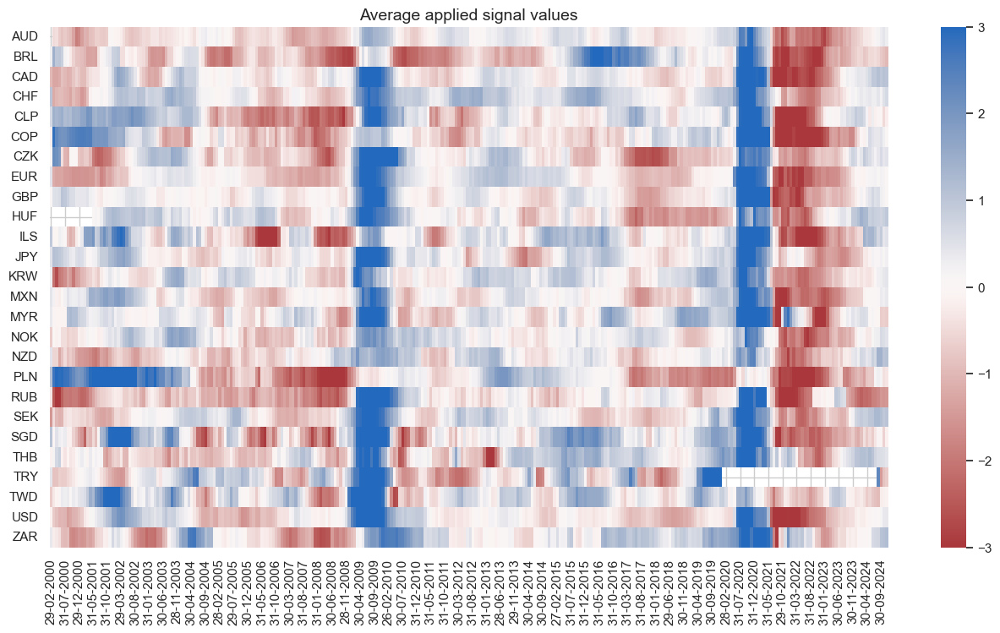

In [83]:
dix = dict_dudi
sig = dix["sig"]
naive_pnl = dix["pnls"]

naive_pnl.signal_heatmap(
    pnl_name=sig + "_PZN", freq="m", start="2000-01-01", figsize=(16, 8)
)

### FX versus equity strategy (directional features)

#### Specs and panel test

In [84]:
sigs = cs_dir
ms = "CSGIL_ZC"  # main signal
oths = list(set(sigs) - set([ms]))  # other signals

targ = "FXvEQXR"
cidx = msm.common_cids(dfx, sigs + [targ])
cidx = list(set(cidx_fxeq) & set(cidx))
dict_fxeq = {
    "sig": ms,
    "rivs": oths,
    "targ": targ,
    "cidx": cidx,
    "black": fxblack,
    "srr": None,
    "pnls": None,
}

In [85]:
dix = dict_fxeq
cidx = dix["cidx"]
cidx.sort()
print(len(cidx))
", ".join(cidx)

17


'AUD, BRL, CAD, CHF, EUR, GBP, JPY, KRW, MXN, MYR, PLN, SEK, SGD, THB, TRY, TWD, ZAR'

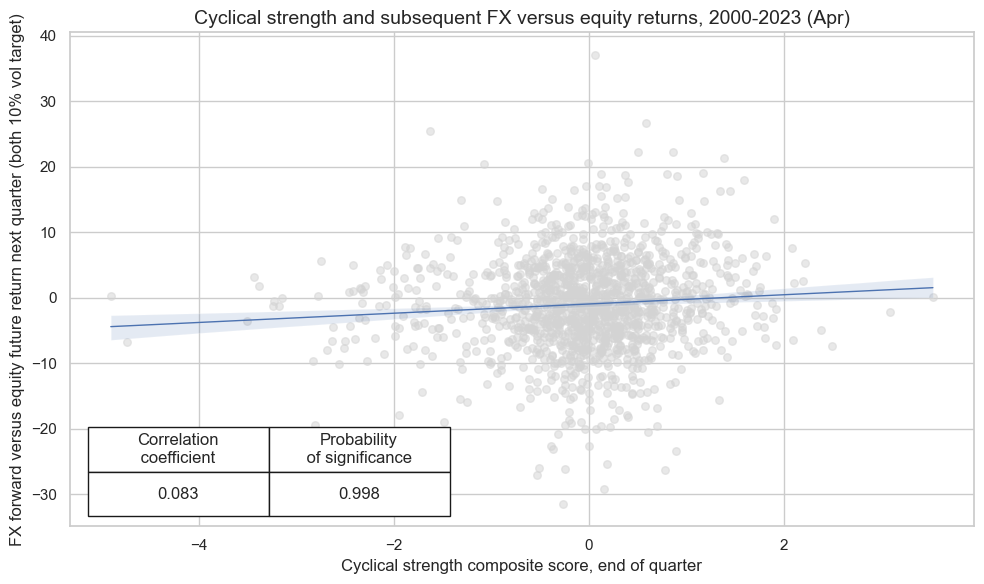

In [86]:
dix = dict_fxeq

sig = dix["sig"]
targ = dix["targ"]
cidx = dix["cidx"]
blax = dix["black"]

crx = msp.CategoryRelations(
    dfx,
    xcats=[sig, targ],
    cids=cidx,
    freq="Q",  # quarterly frequency allows for policy inertia
    lag=1,
    xcat_aggs=["last", "sum"],
    start="2000-01-01",
    blacklist=blax,
    xcat_trims=[None, None],
)
crx.reg_scatter(
    labels=False,
    coef_box="lower left",
    xlab="Cyclical strength composite score, end of quarter",
    ylab="FX forward versus equity future return next quarter (both 10% vol target)",
    title="Cyclical strength and subsequent FX versus equity returns, 2000-2023 (Apr)",
    size=(10, 6),
    prob_est="map",
)

#### Accuracy and correlation check

In [87]:
dix = dict_fxeq

sig = dix["sig"]
rivs = dix["rivs"]
targ = dix["targ"]
cidx = dix["cidx"]
blax = dix["black"]

srr = mss.SignalReturnRelations(
    dfx,
    cids=cidx,
    sigs=[sig] + rivs,
    rets=targ,
    freqs="M",
    start="2000-01-01",
    blacklist=blax,
)

dix["srr"] = srr

In [88]:
dix = dict_fxeq
srrx = dix["srr"]
display(srrx.summary_table().astype("float").round(3))

,accuracy,bal_accuracy,pos_sigr,pos_retr,pos_prec,neg_prec,pearson,pearson_pval,kendall,kendall_pval,auc
M: CSGIL_ZC/last => FXvEQXR,0.518,0.517,0.486,0.460,0.477,0.557,0.047,0.003,0.029,0.006,0.517
Mean years,0.517,0.508,0.491,0.461,0.466,0.551,0.046,0.396,0.016,0.430,0.506
Positive ratio,0.680,0.480,0.400,0.280,0.280,0.720,0.680,0.360,0.480,0.320,0.480
Mean cids,0.519,0.513,0.489,0.462,0.474,0.551,0.042,0.494,0.025,0.461,0.512
Positive ratio,0.812,0.688,0.500,0.125,0.250,0.750,0.688,0.625,0.750,0.438,0.688


In [89]:
dix = dict_fxeq
srrx = dix["srr"]
display(srrx.signals_table().sort_index().astype("float").round(3))

accuracy  bal_accuracy  pos_sigr  \
Return  Signal   Frequency Aggregation                                     
FXvEQXR CSGIL_ZC M         last            0.518         0.517     0.486   
        CSGI_ZC  M         last            0.519         0.514     0.442   
        CSGL_ZC  M         last            0.497         0.500     0.546   
        CSG_ZC   M         last            0.501         0.497     0.456   
        CSIL_ZC  M         last            0.516         0.516     0.497   
        CSI_ZC   M         last            0.523         0.519     0.447   
        CSL_ZC   M         last            0.504         0.513     0.601   

                                        pos_retr  pos_prec  neg_prec  pearson  \
Return  Signal   Frequency Aggregation                                          
FXvEQXR CSGIL_ZC M         last            0.459     0.477     0.557    0.047   
        CSGI_ZC  M         last            0.460     0.476     0.553    0.035   
        CSGL_ZC  M         last            0.459     0.460     0.541    0.027   
        CSG_ZC   M         last            0.460     0.456     0.538    0.006   
        CSIL_ZC  M         last            0.459     0.476     0.557    0.067   
        CSI_ZC   M         last            0.460     0.481     0.557    0.051   
        CSL_ZC   M         last            0.459     0.469     0.556    0.049   

                                        pearson_pval  kendall  kendall_pval  \
Return  Signal   Frequency Aggregation                                        
FXvEQXR CSGIL_ZC M         last                0.003    0.029         0.006   
        CSGI_ZC  M         last                0.026    0.023         0.031   
        CSGL_ZC  M         last                0.084    0.014         0.177   
        CSG_ZC   M         last                0.680   -0.003         0.798   
        CSIL_ZC  M         last                0.000    0.040         0.000   
        CSI_ZC   M         last                0.001    0.033         0.001   
        CSL_ZC   M         last                0.002    0.033         0.002   

                                          auc  
Return  Signal   Frequency Aggregation         
FXvEQXR CSGIL_ZC M         last         0.517  
        CSGI_ZC  M         last         0.514  
        CSGL_ZC  M         last         0.500  
        CSG_ZC   M         last         0.497  
        CSIL_ZC  M         last         0.516  
        CSI_ZC   M         last         0.519  
        CSL_ZC   M         last         0.512

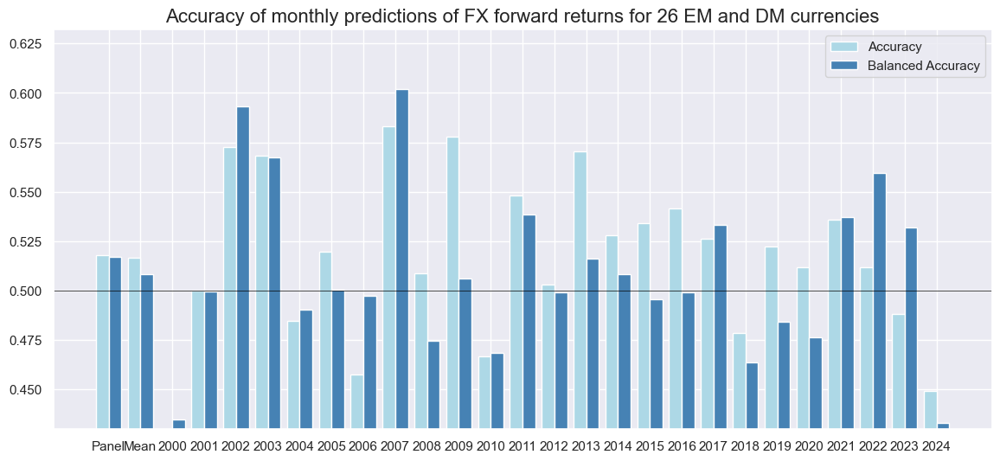

In [90]:
dix = dict_fxeq
srrx = dix["srr"]
srrx.accuracy_bars(
    type="years",
    title="Accuracy of monthly predictions of FX forward returns for 26 EM and DM currencies",
    size=(14, 6),
)

#### Naive PnL

In [91]:
dix = dict_fxeq

sigx = [dix["sig"]] + dix["rivs"]
targ = dix["targ"]
cidx = dix["cidx"]
blax = dix["black"]

naive_pnl = msn.NaivePnL(
    dfx,
    ret=targ,
    sigs=sigx,
    cids=cidx,
    start="2000-01-01",
    blacklist=blax,
    bms=["USD_EQXR_NSA"],
)

for sig in sigx:
    naive_pnl.make_pnl(
        sig,
        sig_neg=False,
        sig_op="zn_score_pan",
        thresh=3,
        rebal_freq="monthly",
        vol_scale=10,
        rebal_slip=1,
        pnl_name=sig + "_PZN",
    )

for sig in sigx:
    naive_pnl.make_pnl(
        sig,
        sig_neg=False,
        sig_op="binary",
        thresh=3,
        rebal_freq="monthly",
        vol_scale=10,
        rebal_slip=1,
        pnl_name=sig + "_BIN",
    )

naive_pnl.make_long_pnl(vol_scale=10, label="Long only")
dix["pnls"] = naive_pnl

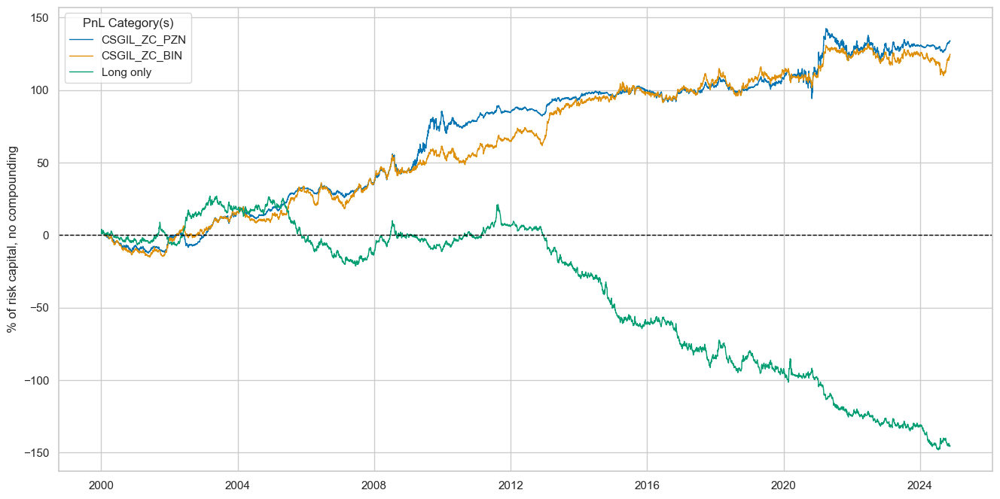

In [92]:
dix = dict_fxeq

sigx = dix["sig"]
naive_pnl = dix["pnls"]
pnls = [sigx + x for x in ["_PZN", "_BIN"]] + ["Long only"]

naive_pnl.plot_pnls(
    pnl_cats=pnls,
    pnl_cids=["ALL"],
    start="2000-01-01",
    title=None,
    xcat_labels=None,
    figsize=(16, 8),
)

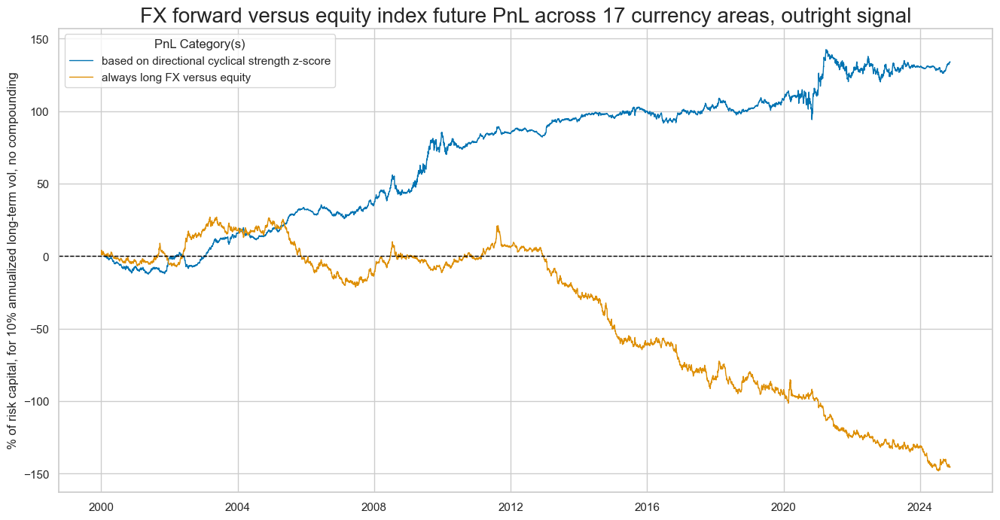

In [93]:
dix = dict_fxeq

sigx = dix["sig"]
naive_pnl = dix["pnls"]
pnls = [sigx + "_PZN"] + ["Long only"]

dict_labels={"CSGIL_ZC_PZN":"based on directional cyclical strength z-score",
"Long only": "always long FX versus equity"}

naive_pnl.plot_pnls(
    pnl_cats=pnls,
    pnl_cids=["ALL"],
    start="2000-01-01",
    title="FX forward versus equity index future PnL across 17 currency areas, outright signal",
    xcat_labels=dict_labels,
    ylab="% of risk capital, for 10% annualized long-term vol, no compounding",
    figsize=(16, 8),
)

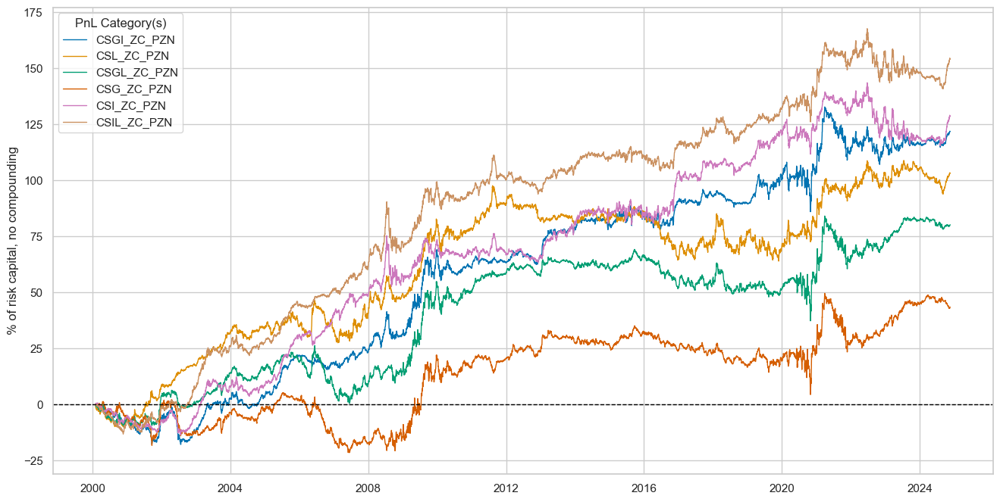

In [94]:
dix = dict_fxeq

sigx = dix["rivs"]
naive_pnl = dix["pnls"]
pnls = [sig + "_PZN" for sig in sigx]

naive_pnl.plot_pnls(
    pnl_cats=pnls,
    pnl_cids=["ALL"],
    start="2000-01-01",
    title=None,
    xcat_labels=None,
    figsize=(16, 8),
)

In [95]:
dix = dict_fxeq

sigx = [dix["sig"]] + dix["rivs"]
naive_pnl = dix["pnls"]
pnls = [sig + type for sig in sigx for type in ["_PZN", "_BIN"]]

df_eval = naive_pnl.evaluate_pnls(
    pnl_cats=pnls,
    pnl_cids=["ALL"],
    start="2000-01-01",
)
display(df_eval.transpose())

,Return %,St. Dev. %,Sharpe Ratio,Sortino Ratio,Max 21-Day Draw %,Max 6-Month Draw %,Peak to Trough Draw %,Top 5% Monthly PnL Share,USD_EQXR_NSA correl,Traded Months
xcat,,,,,,,,,,
CSGIL_ZC_PZN,5.404663,10.0,0.540466,0.793665,-15.437734,-18.211074,-22.363847,0.991188,0.033378,298
CSGI_ZC_PZN,4.913452,10.0,0.491345,0.707903,-15.231804,-20.778578,-25.644142,1.084504,0.10942,298
CSL_ZC_PZN,4.160296,10.0,0.41603,0.613842,-11.552108,-16.627945,-33.648778,1.030258,-0.135208,298
CSGL_ZC_PZN,3.235519,10.0,0.323552,0.478286,-16.589878,-19.892795,-31.831864,1.624277,0.033973,298
CSG_ZC_PZN,1.754645,10.0,0.175465,0.256299,-16.158822,-23.622871,-30.677551,2.827893,0.150313,298
CSI_ZC_PZN,5.181652,10.0,0.518165,0.730243,-18.322582,-19.412635,-28.085692,0.822389,0.026168,298
CSIL_ZC_PZN,6.211037,10.0,0.621104,0.90086,-17.658517,-19.72873,-26.851595,0.753829,-0.050241,298
CSGIL_ZC_BIN,5.029814,10.0,0.502981,0.72627,-12.058163,-18.563666,-22.077322,0.930152,0.00776,298
CSGI_ZC_BIN,4.445168,10.0,0.444517,0.632069,-14.878733,-18.899299,-26.300824,1.011533,0.070574,298


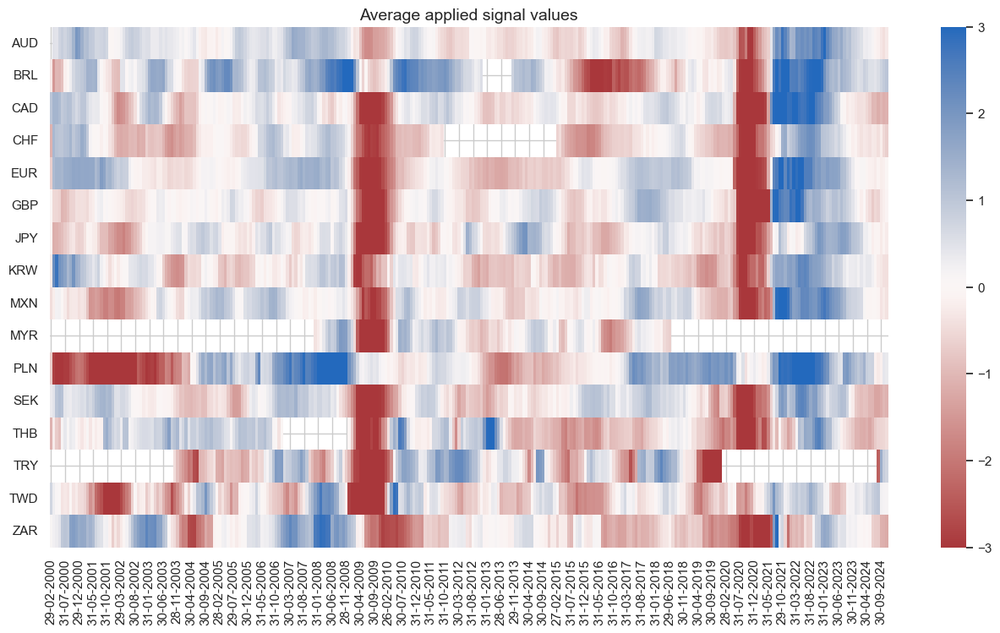

In [96]:
dix = dict_fxeq
sig = dix["sig"]
naive_pnl = dix["pnls"]

naive_pnl.signal_heatmap(
    pnl_name=sig + "_PZN", freq="m", start="2000-01-01", figsize=(16, 8)
)

### FX versus equity strategy (relative features)

#### Specs and panel test

In [97]:
sigs = cs_rel
ms = "CSGILvBM_ZC"  # main signal
oths = list(set(sigs) - set([ms]))  # other signals

targ = "FXvEQXR"
cidx = msm.common_cids(dfx, sigs + [targ])
cidx = list(set(cidx_fxeq) & set(cidx))
dict_fxeq_rf = {
    "sig": ms,
    "rivs": oths,
    "targ": targ,
    "cidx": cidx,
    "black": fxblack,
    "srr": None,
    "pnls": None,
}

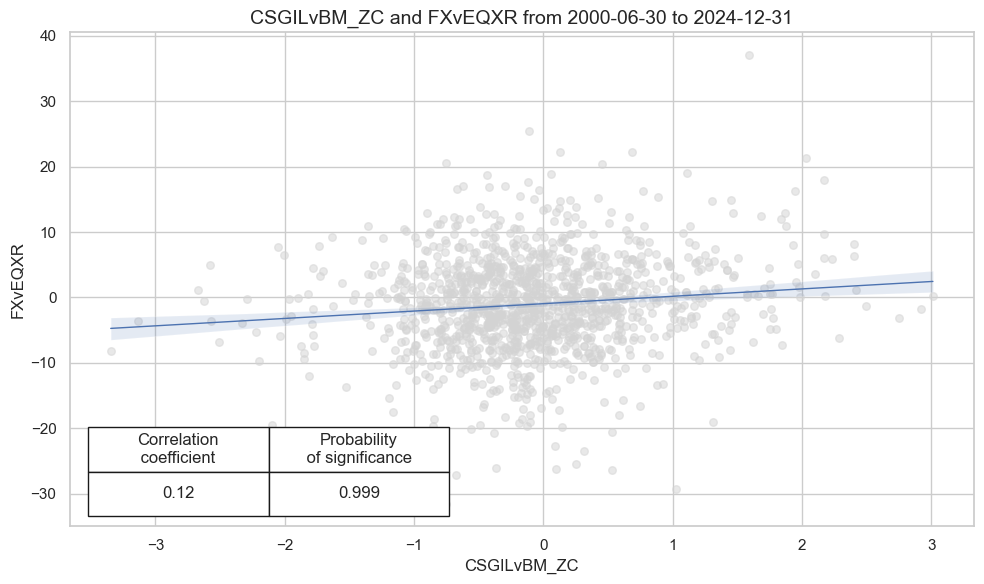

In [98]:
dix = dict_fxeq_rf

sig = dix["sig"]
targ = dix["targ"]
cidx = dix["cidx"]
blax = dix["black"]

crx = msp.CategoryRelations(
    dfx,
    xcats=[sig, targ],
    cids=cidx,
    freq="Q",  # quarterly frequency allows for policy inertia
    lag=1,
    xcat_aggs=["last", "sum"],
    start="2000-01-01",
    blacklist=blax,
    xcat_trims=[None, None],
)
crx.reg_scatter(
    labels=False,
    coef_box="lower left",
    # separator=2011,
    #     xlab="",
    #     ylab="",
    #     title="",
    size=(10, 6),
    prob_est="map",
)

#### Accuracy and correlation check

In [99]:
dix = dict_fxeq_rf

sig = dix["sig"]
rivs = dix["rivs"]
targ = dix["targ"]
cidx = dix["cidx"]
blax = dix["black"]

srr = mss.SignalReturnRelations(
    dfx,
    cids=cidx,
    sigs=[sig] + rivs,
    rets=targ,
    freqs="M",
    start="2000-01-01",
    blacklist=blax,
)

dix["srr"] = srr

In [100]:
dix = dict_fxeq_rf
srrx = dix["srr"]
display(srrx.summary_table().astype("float").round(3))

,accuracy,bal_accuracy,pos_sigr,pos_retr,pos_prec,neg_prec,pearson,pearson_pval,kendall,kendall_pval,auc
M: CSGILvBM_ZC/last => FXvEQXR,0.520,0.513,0.414,0.460,0.475,0.551,0.079,0.000,0.041,0.000,0.513
Mean years,0.517,0.500,0.423,0.461,0.463,0.538,0.047,0.392,0.015,0.487,0.500
Positive ratio,0.560,0.560,0.360,0.240,0.360,0.760,0.680,0.440,0.480,0.360,0.560
Mean cids,0.518,0.505,0.424,0.462,0.467,0.543,0.055,0.334,0.028,0.434,0.505
Positive ratio,0.733,0.533,0.267,0.133,0.200,0.800,0.733,0.533,0.667,0.467,0.533


In [101]:
dix = dict_fxeq_rf
srrx = dix["srr"]
display(srrx.signals_table().sort_index().astype("float").round(3))

accuracy  bal_accuracy  pos_sigr  \
Return  Signal      Frequency Aggregation                                     
FXvEQXR CSGILvBM_ZC M         last            0.520         0.513     0.414   
        CSGIvBM_ZC  M         last            0.504         0.500     0.447   
        CSGLvBM_ZC  M         last            0.518         0.513     0.432   
        CSGvBM_ZC   M         last            0.506         0.503     0.460   
        CSILvBM_ZC  M         last            0.519         0.514     0.435   
        CSIvBM_ZC   M         last            0.512         0.508     0.452   
        CSLvBM_ZC   M         last            0.530         0.526     0.436   

                                           pos_retr  pos_prec  neg_prec  \
Return  Signal      Frequency Aggregation                                 
FXvEQXR CSGILvBM_ZC M         last            0.460     0.475     0.551   
        CSGIvBM_ZC  M         last            0.459     0.459     0.541   
        CSGLvBM_ZC  M         last            0.460     0.474     0.551   
        CSGvBM_ZC   M         last            0.459     0.463     0.543   
        CSILvBM_ZC  M         last            0.460     0.476     0.553   
        CSIvBM_ZC   M         last            0.457     0.466     0.551   
        CSLvBM_ZC   M         last            0.459     0.488     0.563   

                                           pearson  pearson_pval  kendall  \
Return  Signal      Frequency Aggregation                                   
FXvEQXR CSGILvBM_ZC M         last           0.079         0.000    0.041   
        CSGIvBM_ZC  M         last           0.058         0.000    0.027   
        CSGLvBM_ZC  M         last           0.062         0.000    0.039   
        CSGvBM_ZC   M         last           0.030         0.067    0.014   
        CSILvBM_ZC  M         last           0.083         0.000    0.046   
        CSIvBM_ZC   M         last           0.052         0.001    0.031   
        CSLvBM_ZC   M         last           0.066         0.000    0.042   

                                           kendall_pval    auc  
Return  Signal      Frequency Aggregation                       
FXvEQXR CSGILvBM_ZC M         last                0.000  0.513  
        CSGIvBM_ZC  M         last                0.014  0.500  
        CSGLvBM_ZC  M         last                0.000  0.512  
        CSGvBM_ZC   M         last                0.204  0.503  
        CSILvBM_ZC  M         last                0.000  0.514  
        CSIvBM_ZC   M         last                0.005  0.508  
        CSLvBM_ZC   M         last                0.000  0.525

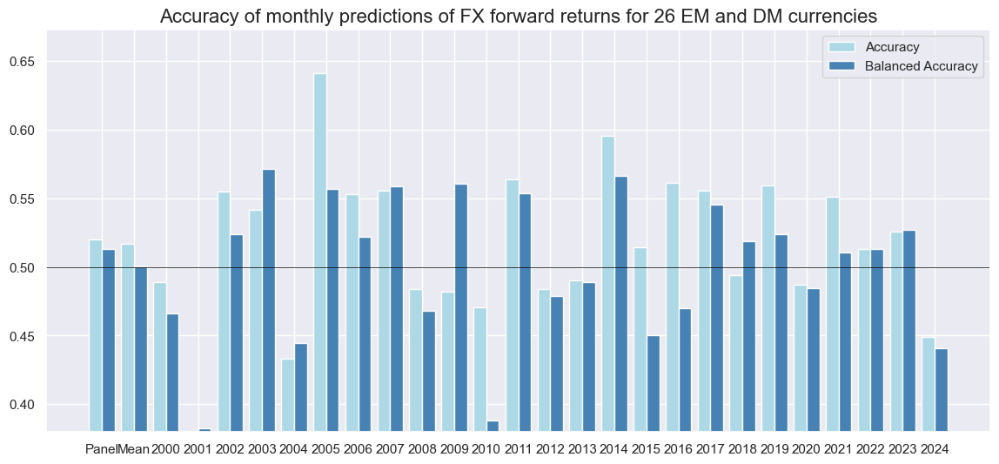

In [102]:
dix = dict_fxeq_rf
srrx = dix["srr"]
srrx.accuracy_bars(
    type="years",
    title="Accuracy of monthly predictions of FX forward returns for 26 EM and DM currencies",
    size=(14, 6),
)

#### Naive PnL

In [103]:
dix = dict_fxeq_rf

sigx = [dix["sig"]] + dix["rivs"]
targ = dix["targ"]
cidx = dix["cidx"]
blax = dix["black"]

naive_pnl = msn.NaivePnL(
    dfx,
    ret=targ,
    sigs=sigx,
    cids=cidx,
    start="2000-01-01",
    blacklist=blax,
    bms=["USD_EQXR_NSA"],
)

for sig in sigx:
    naive_pnl.make_pnl(
        sig,
        sig_neg=False,
        sig_op="zn_score_pan",
        thresh=3,
        rebal_freq="monthly",
        vol_scale=10,
        rebal_slip=1,
        pnl_name=sig + "_PZN",
    )

for sig in sigx:
    naive_pnl.make_pnl(
        sig,
        sig_neg=False,
        sig_op="binary",
        thresh=3,
        rebal_freq="monthly",
        vol_scale=10,
        rebal_slip=1,
        pnl_name=sig + "_BIN",
    )

naive_pnl.make_long_pnl(vol_scale=10, label="Long only")
dix["pnls"] = naive_pnl

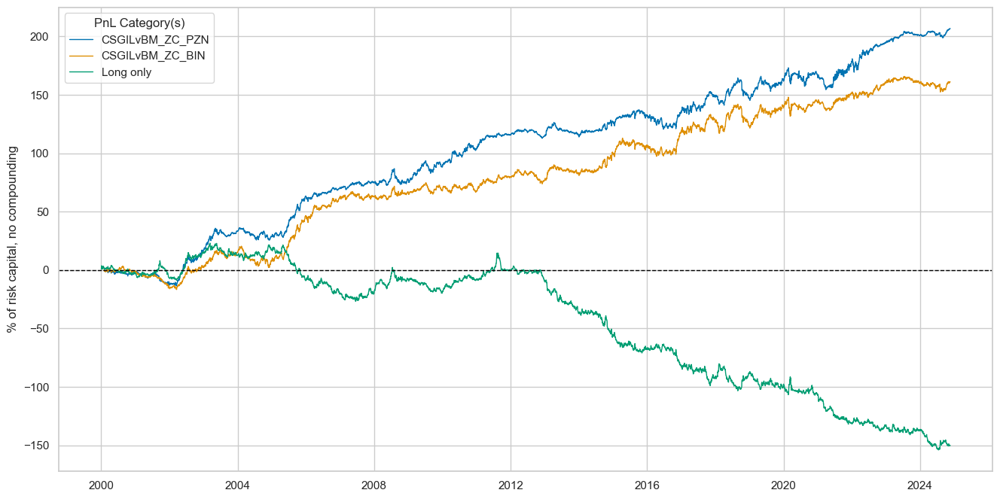

In [104]:
dix = dict_fxeq_rf

sigx = dix["sig"]
naive_pnl = dix["pnls"]
pnls = [sigx + x for x in ["_PZN", "_BIN"]] + ["Long only"]

naive_pnl.plot_pnls(
    pnl_cats=pnls,
    pnl_cids=["ALL"],
    start="2000-01-01",
    title=None,
    xcat_labels=None,
    figsize=(16, 8),
)

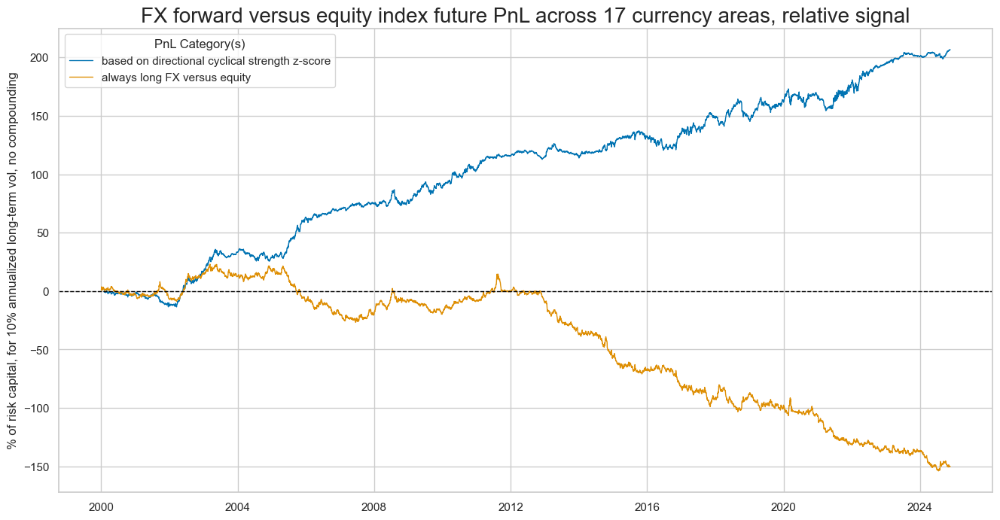

In [105]:
dix = dict_fxeq_rf

sigx = dix["sig"]
naive_pnl = dix["pnls"]
pnls = [sigx + "_PZN"] + ["Long only"]

dict_labels={"CSGILvBM_ZC_PZN": "based on directional cyclical strength z-score",
         "Long only": "always long FX versus equity"}

naive_pnl.plot_pnls(
    pnl_cats=pnls,
    pnl_cids=["ALL"],
    start="2000-01-01",
    title="FX forward versus equity index future PnL across 17 currency areas, relative signal",
    xcat_labels=dict_labels,
    ylab="% of risk capital, for 10% annualized long-term vol, no compounding",
    figsize=(16, 8),
)

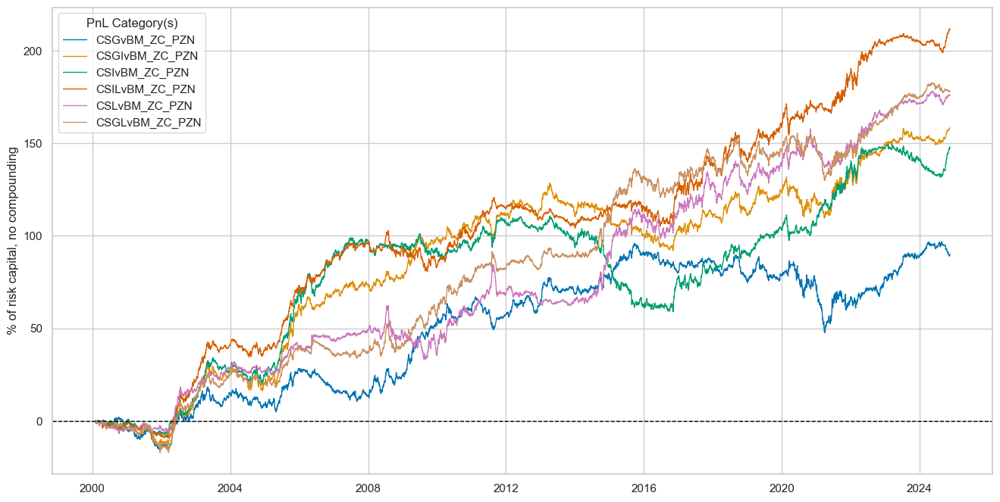

In [106]:
dix = dict_fxeq_rf

sigx = dix["rivs"]
naive_pnl = dix["pnls"]
pnls = [sig + "_PZN" for sig in sigx]

naive_pnl.plot_pnls(
    pnl_cats=pnls,
    pnl_cids=["ALL"],
    start="2000-01-01",
    title=None,
    xcat_labels=None,
    figsize=(16, 8),
)

In [107]:
dix = dict_fxeq_rf

sigx = [dix["sig"]] + dix["rivs"]
naive_pnl = dix["pnls"]
pnls = [sig + type for sig in sigx for type in ["_PZN", "_BIN"]]

df_eval = naive_pnl.evaluate_pnls(
    pnl_cats=pnls,
    pnl_cids=["ALL"],
    start="2000-01-01",
)
display(df_eval.transpose())

,Return %,St. Dev. %,Sharpe Ratio,Sortino Ratio,Max 21-Day Draw %,Max 6-Month Draw %,Peak to Trough Draw %,Top 5% Monthly PnL Share,USD_EQXR_NSA correl,Traded Months
xcat,,,,,,,,,,
CSGILvBM_ZC_PZN,8.334418,10.0,0.833442,1.200683,-13.459492,-15.37297,-19.140221,0.544992,0.053613,298
CSGvBM_ZC_PZN,3.633139,10.0,0.363314,0.518486,-12.631551,-28.83066,-48.408873,1.121046,0.027406,298
CSGIvBM_ZC_PZN,6.38599,10.0,0.638599,0.919681,-10.220062,-20.709122,-36.673399,0.722807,0.087613,298
CSIvBM_ZC_PZN,5.946811,10.0,0.594681,0.850107,-13.722564,-26.15678,-51.667236,0.776585,0.081429,298
CSILvBM_ZC_PZN,8.530024,10.0,0.853002,1.231267,-15.410937,-11.863888,-22.370403,0.53846,0.044535,298
CSLvBM_ZC_PZN,7.094953,10.0,0.709495,1.03636,-14.434188,-19.075401,-29.061787,0.697287,-0.021247,298
CSGLvBM_ZC_PZN,7.195167,10.0,0.719517,1.044721,-12.642724,-23.13424,-25.77028,0.6325,0.005897,298
CSGILvBM_ZC_BIN,6.497507,10.0,0.649751,0.92958,-14.345262,-17.811849,-20.399282,0.702889,0.076423,298
CSGvBM_ZC_BIN,4.76715,10.0,0.476715,0.694914,-12.277093,-20.541087,-24.804862,0.98014,-0.003623,298


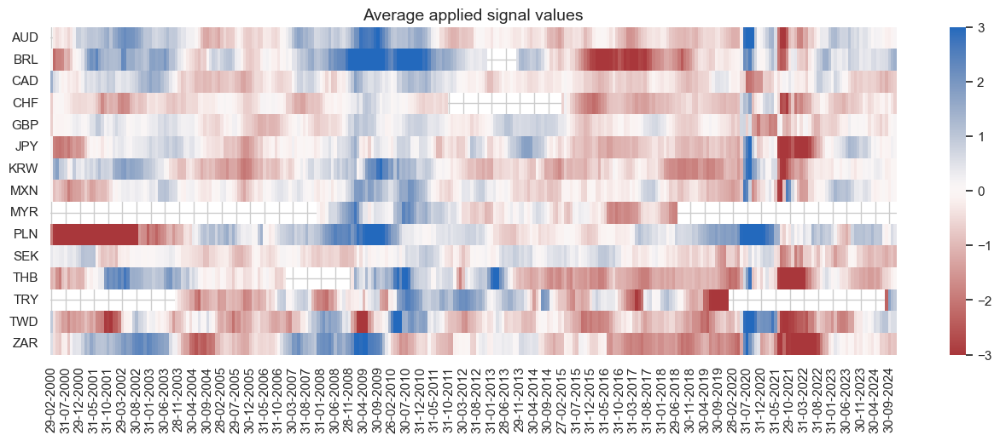

In [108]:
dix = dict_fxeq_rf
sig = dix["sig"]
naive_pnl = dix["pnls"]

naive_pnl.signal_heatmap(
    pnl_name=sig + "_PZN", freq="m", start="2000-01-01", figsize=(16, 5)
)

### FX versus IRS strategy (relative features)

#### Specs and panel test

In [109]:
sigs = cs_rel
ms = "CSGILvBM_ZC"  # main signal
oths = list(set(sigs) - set([ms]))  # other signals

targ = "FXvDU05XR"
cidx = msm.common_cids(dfx, sigs + [targ])
cidx = list(set(cidx_fxdu) & set(cidx))
dict_fxdu_rf = {
    "sig": ms,
    "rivs": oths,
    "targ": targ,
    "cidx": cidx,
    "black": fxblack,
    "srr": None,
    "pnls": None,
}

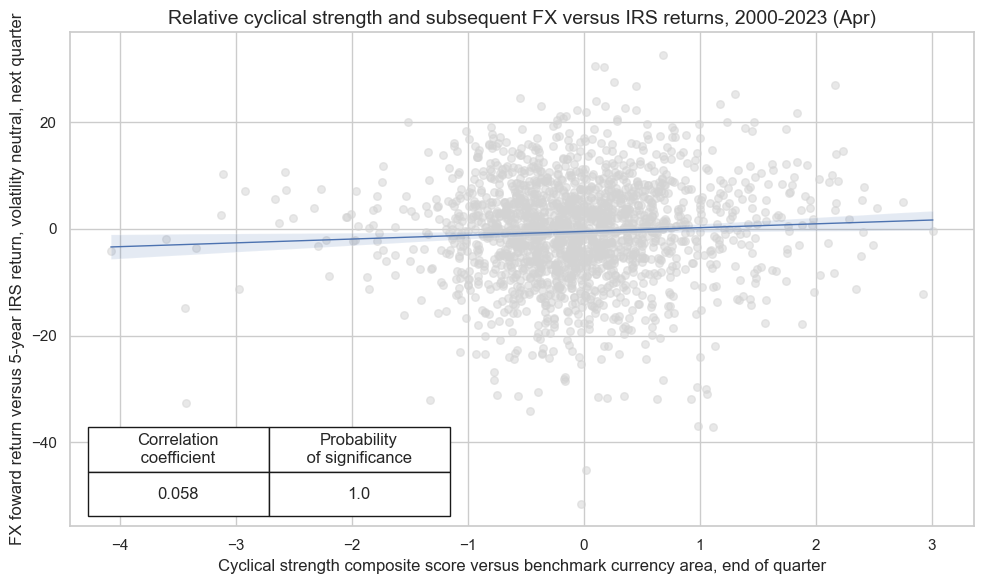

In [110]:
dix = dict_fxdu_rf

sig = dix["sig"]
targ = dix["targ"]
cidx = dix["cidx"]
blax = dix["black"]

crx = msp.CategoryRelations(
    dfx,
    xcats=[sig, targ],
    cids=cidx,
    freq="Q",  # quarterly frequency allows for policy inertia
    lag=1,
    xcat_aggs=["last", "sum"],
    start="2000-01-01",
    blacklist=blax,
    xcat_trims=[None, None],
)
crx.reg_scatter(
    labels=False,
    coef_box="lower left",
    xlab="Cyclical strength composite score versus benchmark currency area, end of quarter",
    ylab="FX foward return versus 5-year IRS return, volatility neutral, next quarter",
    title="Relative cyclical strength and subsequent FX versus IRS returns, 2000-2023 (Apr)",
    size=(10, 6),
    prob_est="map",
)

#### Accuracy and correlation check

In [111]:
dix = dict_fxdu_rf

sig = dix["sig"]
rivs = dix["rivs"]
targ = dix["targ"]
cidx = dix["cidx"]
blax = dix["black"]

srr = mss.SignalReturnRelations(
    dfx,
    cids=cidx,
    sigs=[sig] + rivs,
    rets=targ,
    freqs="M",
    start="2000-01-01",
    blacklist=blax,
)

dix["srr"] = srr

In [112]:
dix = dict_fxdu_rf
srrx = dix["srr"]
display(srrx.summary_table().astype("float").round(3))

,accuracy,bal_accuracy,pos_sigr,pos_retr,pos_prec,neg_prec,pearson,pearson_pval,kendall,kendall_pval,auc
M: CSGILvBM_ZC/last => FXvDU05XR,0.522,0.523,0.440,0.501,0.526,0.519,0.053,0.000,0.033,0.000,0.522
Mean years,0.522,0.520,0.442,0.495,0.510,0.529,0.068,0.395,0.040,0.379,0.518
Positive ratio,0.560,0.720,0.400,0.440,0.480,0.640,0.800,0.560,0.720,0.520,0.720
Mean cids,0.523,0.522,0.448,0.503,0.528,0.517,0.036,0.433,0.029,0.391,0.521
Positive ratio,0.783,0.783,0.348,0.609,0.696,0.609,0.609,0.391,0.609,0.435,0.783


In [113]:
dix = dict_fxdu_rf
srrx = dix["srr"]
display(srrx.signals_table().sort_index().astype("float").round(3))

accuracy  bal_accuracy  pos_sigr  \
Return    Signal      Frequency Aggregation                                     
FXvDU05XR CSGILvBM_ZC M         last            0.522         0.523     0.440   
          CSGIvBM_ZC  M         last            0.508         0.508     0.462   
          CSGLvBM_ZC  M         last            0.517         0.517     0.456   
          CSGvBM_ZC   M         last            0.504         0.504     0.462   
          CSILvBM_ZC  M         last            0.521         0.521     0.460   
          CSIvBM_ZC   M         last            0.510         0.510     0.475   
          CSLvBM_ZC   M         last            0.522         0.522     0.443   

                                             pos_retr  pos_prec  neg_prec  \
Return    Signal      Frequency Aggregation                                 
FXvDU05XR CSGILvBM_ZC M         last            0.501     0.526     0.519   
          CSGIvBM_ZC  M         last            0.502     0.511     0.505   
          CSGLvBM_ZC  M         last            0.501     0.520     0.515   
          CSGvBM_ZC   M         last            0.502     0.506     0.502   
          CSILvBM_ZC  M         last            0.499     0.522     0.520   
          CSIvBM_ZC   M         last            0.499     0.510     0.511   
          CSLvBM_ZC   M         last            0.499     0.523     0.521   

                                             pearson  pearson_pval  kendall  \
Return    Signal      Frequency Aggregation                                   
FXvDU05XR CSGILvBM_ZC M         last           0.053         0.000    0.033   
          CSGIvBM_ZC  M         last           0.047         0.001    0.025   
          CSGLvBM_ZC  M         last           0.036         0.008    0.025   
          CSGvBM_ZC   M         last           0.021         0.114    0.008   
          CSILvBM_ZC  M         last           0.054         0.000    0.037   
          CSIvBM_ZC   M         last           0.039         0.005    0.026   
          CSLvBM_ZC   M         last           0.037         0.006    0.029   

                                             kendall_pval    auc  
Return    Signal      Frequency Aggregation                       
FXvDU05XR CSGILvBM_ZC M         last                0.000  0.522  
          CSGIvBM_ZC  M         last                0.006  0.508  
          CSGLvBM_ZC  M         last                0.005  0.517  
          CSGvBM_ZC   M         last                0.394  0.504  
          CSILvBM_ZC  M         last                0.000  0.521  
          CSIvBM_ZC   M         last                0.005  0.510  
          CSLvBM_ZC   M         last                0.002  0.521

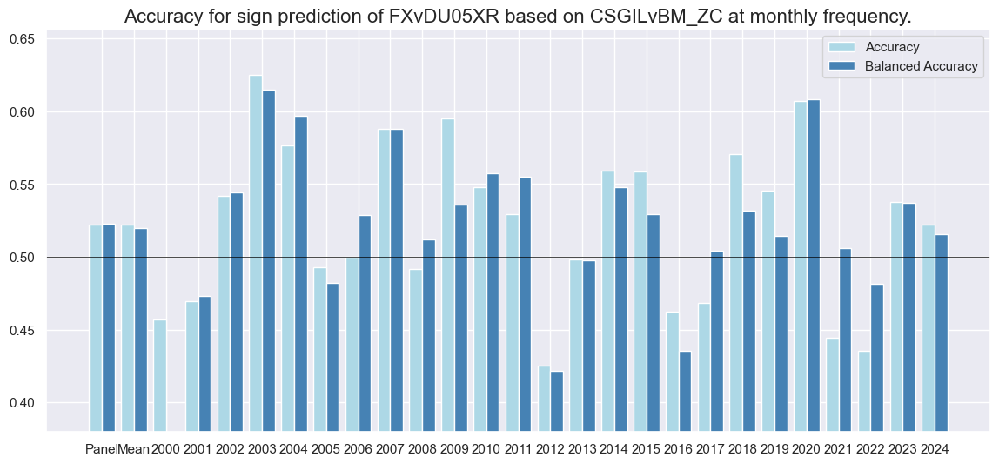

In [114]:
dix = dict_fxdu_rf
srrx = dix["srr"]
srrx.accuracy_bars(
    type="years",
    # title="Accuracy of monthly predictions of FX forward returns for 26 EM and DM currencies",
    size=(14, 6),
)

#### Naive PnL

In [115]:
dix = dict_fxdu_rf

sigx = [dix["sig"]] + dix["rivs"]
targ = dix["targ"]
cidx = dix["cidx"]
blax = dix["black"]

naive_pnl = msn.NaivePnL(
    dfx,
    ret=targ,
    sigs=sigx,
    cids=cidx,
    start="2000-01-01",
    blacklist=blax,
    bms=["USD_EQXR_NSA"],
)

for sig in sigx:
    naive_pnl.make_pnl(
        sig,
        sig_neg=False,
        sig_op="zn_score_pan",
        thresh=3,
        rebal_freq="monthly",
        vol_scale=10,
        rebal_slip=1,
        pnl_name=sig + "_PZN",
    )

for sig in sigx:
    naive_pnl.make_pnl(
        sig,
        sig_neg=False,
        sig_op="binary",
        thresh=3,
        rebal_freq="monthly",
        vol_scale=10,
        rebal_slip=1,
        pnl_name=sig + "_BIN",
    )

naive_pnl.make_long_pnl(vol_scale=10, label="Long only")
dix["pnls"] = naive_pnl

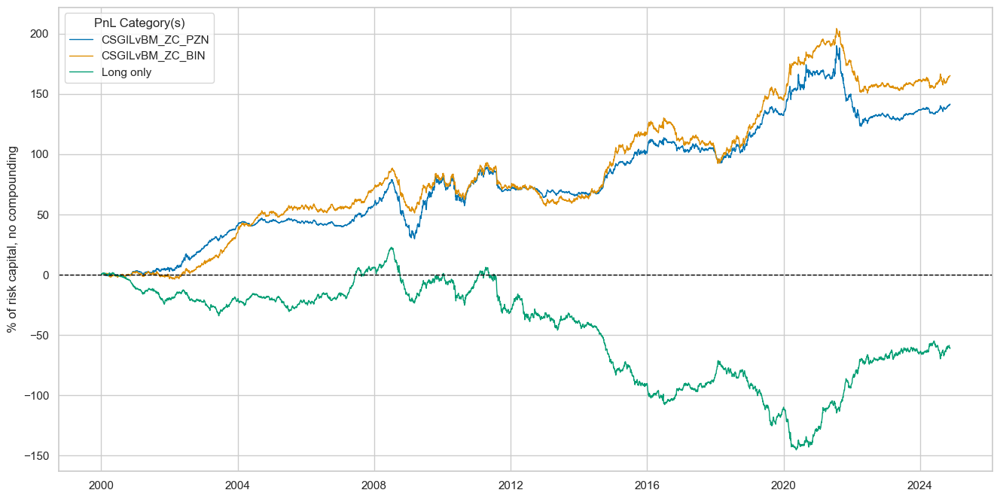

In [116]:
dix = dict_fxdu_rf

sigx = dix["sig"]
naive_pnl = dix["pnls"]
pnls = [sigx + x for x in ["_PZN", "_BIN"]] + ["Long only"]

naive_pnl.plot_pnls(
    pnl_cats=pnls,
    pnl_cids=["ALL"],
    start="2000-01-01",
    title=None,
    xcat_labels=None,
    figsize=(16, 8),
)

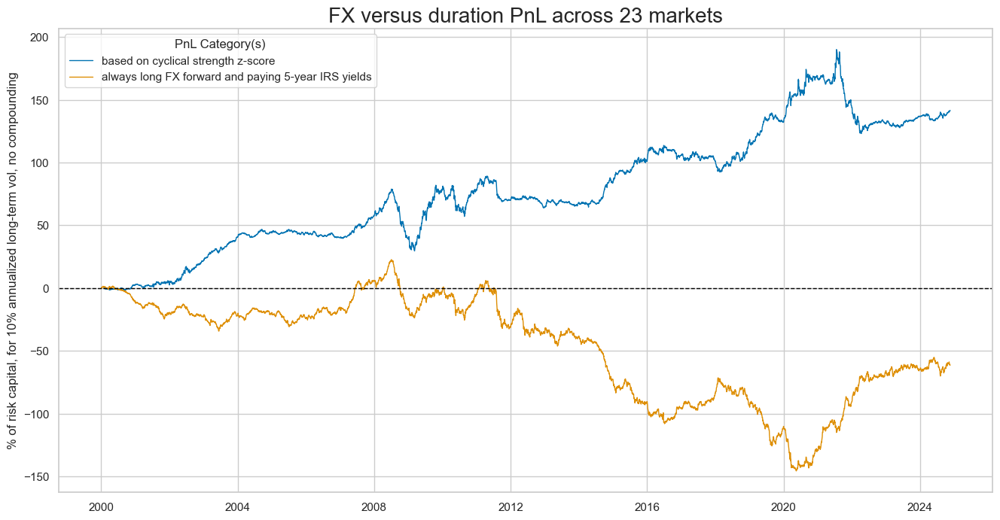

In [117]:
dix = dict_fxdu_rf

sigx = dix["sig"]
naive_pnl = dix["pnls"]
pnls = [sigx + "_PZN"] + ["Long only"]

dict_labels={"CSGILvBM_ZC_PZN": "based on cyclical strength z-score",
         "Long only": "always long FX forward and paying 5-year IRS yields"}

naive_pnl.plot_pnls(
    pnl_cats=pnls,
    pnl_cids=["ALL"],
    start="2000-01-01",
    title="FX versus duration PnL across 23 markets",
    xcat_labels=dict_labels,
    ylab="% of risk capital, for 10% annualized long-term vol, no compounding",
    figsize=(16, 8),
)

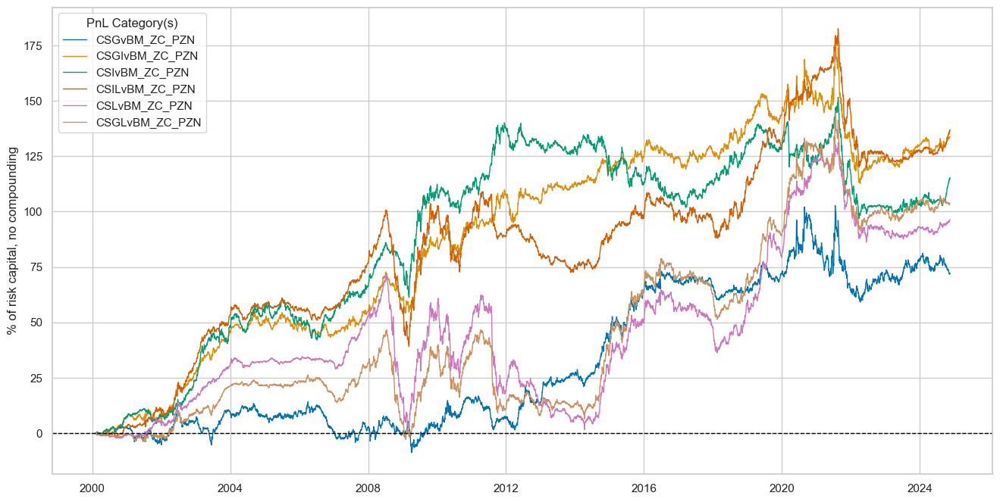

In [118]:
dix = dict_fxdu_rf

sigx = dix["rivs"]
naive_pnl = dix["pnls"]
pnls = [sig + "_PZN" for sig in sigx]

naive_pnl.plot_pnls(
    pnl_cats=pnls,
    pnl_cids=["ALL"],
    start="2000-01-01",
    title=None,
    xcat_labels=None,
    figsize=(16, 8),
)

In [119]:
dix = dict_fxdu_rf

sigx = [dix["sig"]] + dix["rivs"]
naive_pnl = dix["pnls"]
pnls = [sig + type for sig in sigx for type in ["_PZN", "_BIN"]]

df_eval = naive_pnl.evaluate_pnls(
    pnl_cats=pnls,
    pnl_cids=["ALL"],
    start="2000-01-01",
)
display(df_eval.transpose())

,Return %,St. Dev. %,Sharpe Ratio,Sortino Ratio,Max 21-Day Draw %,Max 6-Month Draw %,Peak to Trough Draw %,Top 5% Monthly PnL Share,USD_EQXR_NSA correl,Traded Months
xcat,,,,,,,,,,
CSGILvBM_ZC_PZN,5.705776,10.0,0.570578,0.841965,-22.742112,-57.708844,-66.935626,1.002108,0.077799,298
CSGvBM_ZC_PZN,2.908389,10.0,0.290839,0.429563,-19.431038,-37.871655,-43.634825,1.74691,-0.026702,298
CSGIvBM_ZC_PZN,5.396073,10.0,0.539607,0.795309,-24.574693,-55.056114,-65.397084,0.974997,0.027617,298
CSIvBM_ZC_PZN,4.632813,10.0,0.463281,0.663906,-20.566443,-47.909548,-54.772466,1.08541,0.063032,298
CSILvBM_ZC_PZN,5.509477,10.0,0.550948,0.793448,-21.949948,-54.15788,-62.824813,1.030086,0.108625,298
CSLvBM_ZC_PZN,3.884578,10.0,0.388458,0.550726,-25.688218,-61.550766,-69.792614,1.477448,0.110023,298
CSGLvBM_ZC_PZN,4.189499,10.0,0.41895,0.620696,-22.161625,-45.352959,-54.102618,1.465566,0.063255,298
CSGILvBM_ZC_BIN,6.658925,10.0,0.665892,0.979691,-16.576618,-40.926422,-53.786432,0.800388,0.0475,298
CSGvBM_ZC_BIN,2.780417,10.0,0.278042,0.406489,-13.144493,-21.568452,-34.890465,1.921451,-0.039457,298


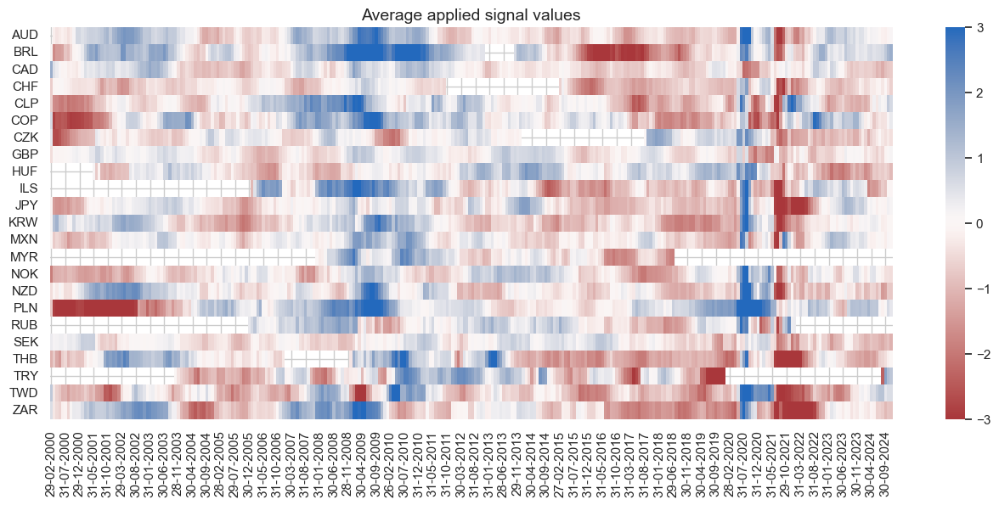

In [120]:
dix = dict_fxdu_rf
sig = dix["sig"]
naive_pnl = dix["pnls"]

naive_pnl.signal_heatmap(
    pnl_name=sig + "_PZN", freq="m", start="2000-01-01", figsize=(16, 6)
)

### IRS curve flattening strategy

#### Specs and panel test

In [121]:
sigs = cs_dir
ms = "CSGIL_ZC"  # main signal
oths = list(set(sigs) - set([ms]))  # other signals

targ = "DU05v02XR"
cidx = msm.common_cids(dfx, sigs + [targ])
cidx = list(set(cidx_du52) & set(cidx))

dict_du52 = {
    "sig": ms,
    "rivs": oths,
    "targ": targ,
    "cidx": cidx,
    "black": dublack,
    "srr": None,
    "pnls": None,
}

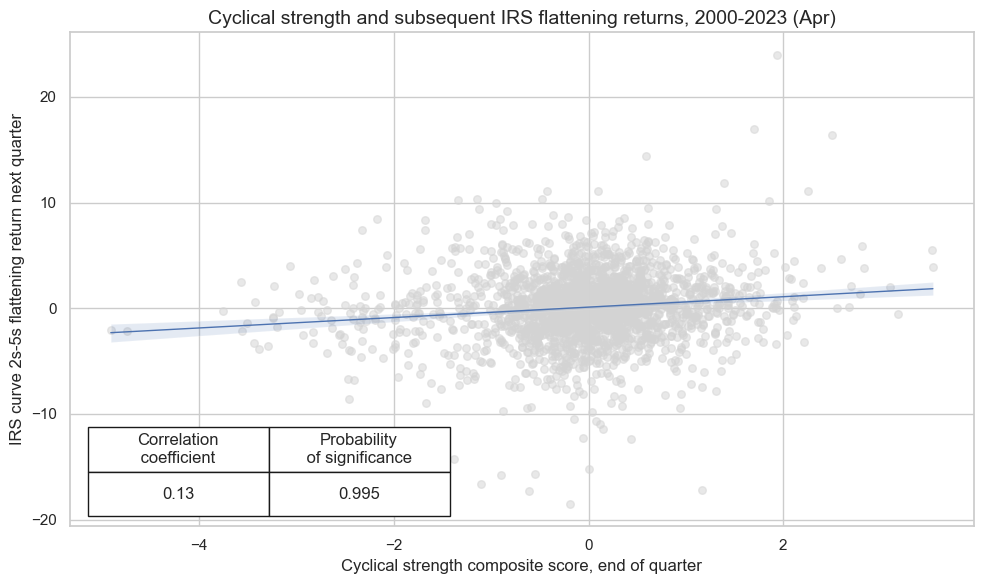

In [122]:
dix = dict_du52

sig = dix["sig"]
targ = dix["targ"]
cidx = dix["cidx"]
blax = dix["black"]

crx = msp.CategoryRelations(
    dfx,
    xcats=[sig, targ],
    cids=cidx,
    freq="Q",
    lag=1,
    xcat_aggs=["last", "sum"],
    start="2000-01-01",
    blacklist=blax,
    xcat_trims=[None, None],
)
crx.reg_scatter(
    labels=False,
    coef_box="lower left",
    xlab="Cyclical strength composite score, end of quarter",
    ylab="IRS curve 2s-5s flattening return next quarter",
    title="Cyclical strength and subsequent IRS flattening returns, 2000-2023 (Apr)",
    size=(10, 6),
    prob_est="map",
)

#### Accuracy and correlation check

In [123]:
dix = dict_du52

sig = dix["sig"]
rivs = dix["rivs"]
targ = dix["targ"]
cidx = dix["cidx"]
blax = dix["black"]

srr = mss.SignalReturnRelations(
    dfx,
    cids=cidx,
    sigs=[sig] + rivs,
    rets=targ,
    freqs="M",
    start="2000-01-01",
    blacklist=blax,
)

dix["srr"] = srr

In [124]:
dix = dict_du52
srrx = dix["srr"]
display(srrx.summary_table().astype("float").round(3))

,accuracy,bal_accuracy,pos_sigr,pos_retr,pos_prec,neg_prec,pearson,pearson_pval,kendall,kendall_pval,auc
M: CSGIL_ZC/last => DU05v02XR,0.534,0.534,0.498,0.517,0.551,0.516,0.091,0.000,0.053,0.000,0.534
Mean years,0.531,0.517,0.504,0.517,0.531,0.503,0.030,0.362,0.028,0.391,0.516
Positive ratio,0.760,0.680,0.520,0.560,0.680,0.480,0.640,0.440,0.640,0.440,0.680
Mean cids,0.533,0.537,0.502,0.515,0.548,0.525,0.102,0.261,0.059,0.284,0.536
Positive ratio,0.846,0.846,0.538,0.654,0.808,0.615,0.885,0.769,0.846,0.692,0.846


In [125]:
dix = dict_du52
srrx = dix["srr"]
display(srrx.signals_table().sort_index().astype("float").round(3))

accuracy  bal_accuracy  pos_sigr  \
Return    Signal   Frequency Aggregation                                     
DU05v02XR CSGIL_ZC M         last            0.534         0.534     0.498   
          CSGI_ZC  M         last            0.534         0.536     0.438   
          CSGL_ZC  M         last            0.537         0.536     0.538   
          CSG_ZC   M         last            0.529         0.531     0.451   
          CSIL_ZC  M         last            0.520         0.520     0.516   
          CSI_ZC   M         last            0.511         0.513     0.464   
          CSL_ZC   M         last            0.530         0.527     0.623   

                                          pos_retr  pos_prec  neg_prec  \
Return    Signal   Frequency Aggregation                                 
DU05v02XR CSGIL_ZC M         last            0.517     0.551     0.516   
          CSGI_ZC  M         last            0.517     0.558     0.515   
          CSGL_ZC  M         last            0.517     0.550     0.521   
          CSG_ZC   M         last            0.517     0.551     0.511   
          CSIL_ZC  M         last            0.518     0.537     0.502   
          CSI_ZC   M         last            0.518     0.532     0.493   
          CSL_ZC   M         last            0.518     0.538     0.516   

                                          pearson  pearson_pval  kendall  \
Return    Signal   Frequency Aggregation                                   
DU05v02XR CSGIL_ZC M         last           0.091         0.000    0.053   
          CSGI_ZC  M         last           0.089         0.000    0.057   
          CSGL_ZC  M         last           0.099         0.000    0.059   
          CSG_ZC   M         last           0.099         0.000    0.065   
          CSIL_ZC  M         last           0.048         0.000    0.025   
          CSI_ZC   M         last           0.024         0.051    0.014   
          CSL_ZC   M         last           0.057         0.000    0.033   

                                          kendall_pval    auc  
Return    Signal   Frequency Aggregation                       
DU05v02XR CSGIL_ZC M         last                0.000  0.534  
          CSGI_ZC  M         last                0.000  0.536  
          CSGL_ZC  M         last                0.000  0.535  
          CSG_ZC   M         last                0.000  0.531  
          CSIL_ZC  M         last                0.002  0.520  
          CSI_ZC   M         last                0.084  0.513  
          CSL_ZC   M         last                0.000  0.525

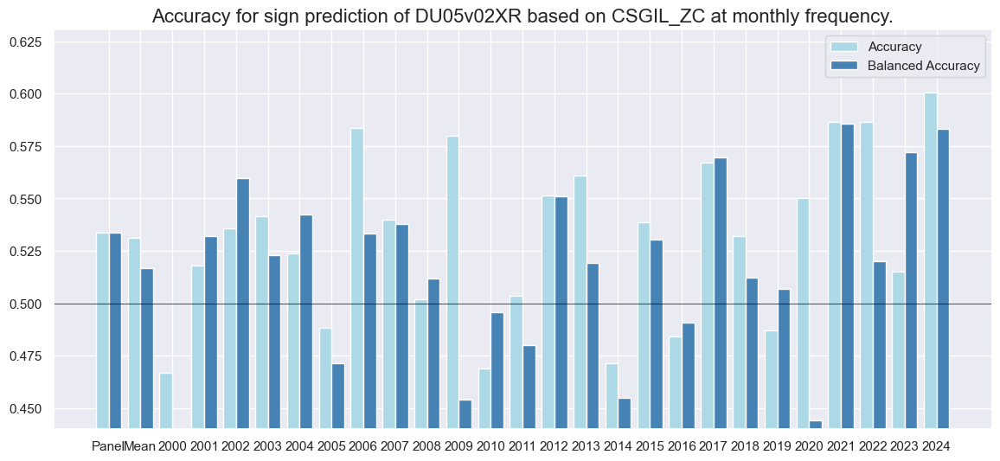

In [126]:
dix = dict_du52
srrx = dix["srr"]
srrx.accuracy_bars(
    type="years",
    # title="",
    size=(14, 6),
)

#### Naive PnL

In [127]:
dix = dict_du52

sigx = [dix["sig"]] + dix["rivs"]
targ = dix["targ"]
cidx = dix["cidx"]
blax = dix["black"]

naive_pnl = msn.NaivePnL(
    dfx,
    ret=targ,
    sigs=sigx,
    cids=cidx,
    start="2000-01-01",
    blacklist=blax,
    bms=["USD_EQXR_NSA", "USD_DU05YXR_VT10"],
)

for sig in sigx:
    naive_pnl.make_pnl(
        sig,
        sig_neg=False,
        sig_op="zn_score_pan",
        thresh=3,
        rebal_freq="monthly",
        vol_scale=10,
        rebal_slip=1,
        pnl_name=sig + "_PZN",
    )

for sig in sigx:
    naive_pnl.make_pnl(
        sig,
        sig_neg=False,
        sig_op="binary",
        thresh=3,
        rebal_freq="monthly",
        vol_scale=10,
        rebal_slip=1,
        pnl_name=sig + "_BIN",
    )

naive_pnl.make_long_pnl(vol_scale=10, label="Long only")
dix["pnls"] = naive_pnl

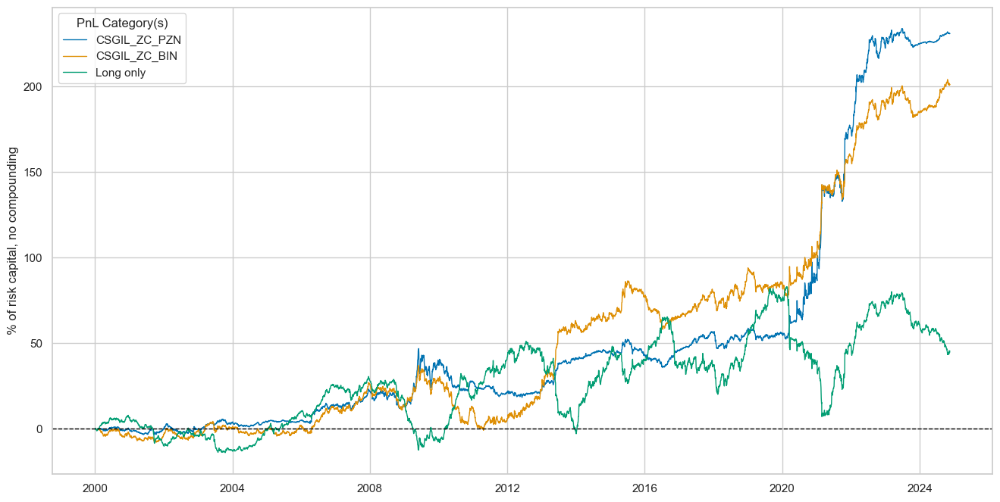

In [128]:
dix = dict_du52

sigx = dix["sig"]
naive_pnl = dix["pnls"]
pnls = [sigx + x for x in ["_PZN", "_BIN"]] + ["Long only"]

naive_pnl.plot_pnls(
    pnl_cats=pnls,
    pnl_cids=["ALL"],
    start="2000-01-01",
    title=None,
    xcat_labels=None,
    figsize=(16, 8),
)

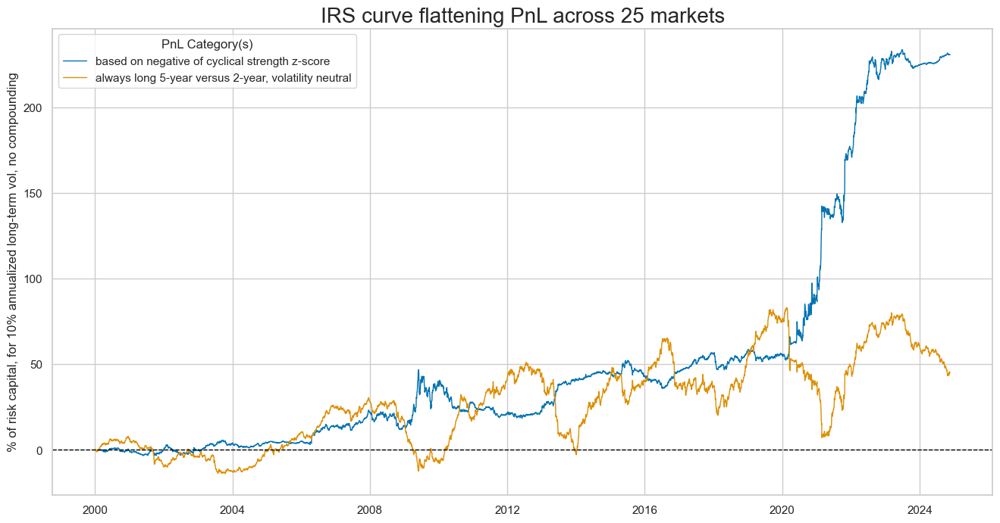

In [129]:
dix = dict_du52

sigx = dix["sig"]
naive_pnl = dix["pnls"]
pnls = [sigx + "_PZN"] + ["Long only"]

dict_labels={"CSGIL_ZC_PZN": "based on negative of cyclical strength z-score",
             "Long only": "always long 5-year versus 2-year, volatility neutral"}


naive_pnl.plot_pnls(
    pnl_cats=pnls,
    pnl_cids=["ALL"],
    start="2000-01-01",
    title="IRS curve flattening PnL across 25 markets",
    xcat_labels=dict_labels,
    ylab="% of risk capital, for 10% annualized long-term vol, no compounding",
    figsize=(16, 8),
)

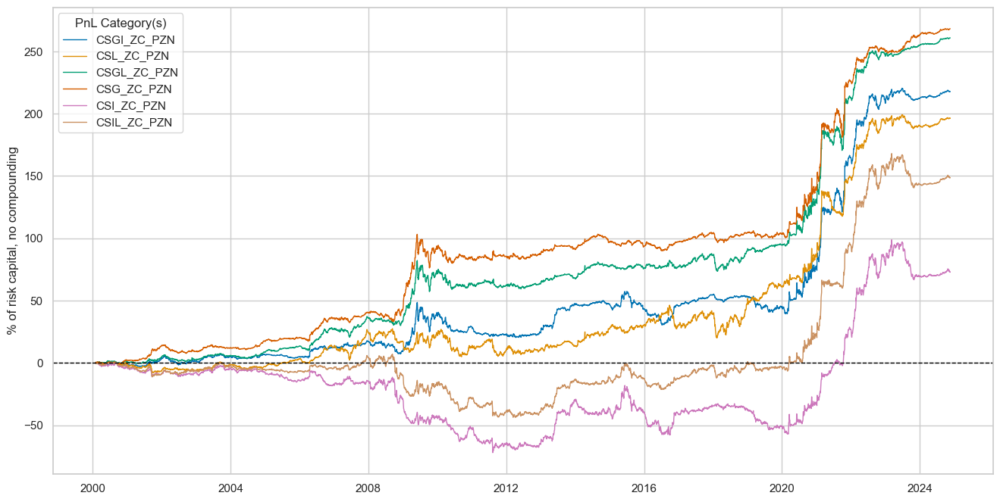

In [130]:
dix = dict_du52

sigx = dix["rivs"]
naive_pnl = dix["pnls"]
pnls = [sig + "_PZN" for sig in sigx]

naive_pnl.plot_pnls(
    pnl_cats=pnls,
    pnl_cids=["ALL"],
    start="2000-01-01",
    title=None,
    xcat_labels=None,
    figsize=(16, 8),
)

In [131]:
dix = dict_du52

sigx = [dix["sig"]] + dix["rivs"]
naive_pnl = dix["pnls"]
pnls = [sig + type for sig in sigx for type in ["_PZN", "_BIN"]]

df_eval = naive_pnl.evaluate_pnls(
    pnl_cats=pnls,
    pnl_cids=["ALL"],
    start="2000-01-01",
)
display(df_eval.transpose())

,Return %,St. Dev. %,Sharpe Ratio,Sortino Ratio,Max 21-Day Draw %,Max 6-Month Draw %,Peak to Trough Draw %,Top 5% Monthly PnL Share,USD_EQXR_NSA correl,USD_DU05YXR_VT10 correl,Traded Months
xcat,,,,,,,,,,,
CSGIL_ZC_PZN,9.30828,10.0,0.930828,1.602482,-13.101565,-16.115859,-28.495641,0.958435,0.024137,-0.07648,298
CSGI_ZC_PZN,8.784759,10.0,0.878476,1.492628,-15.147253,-15.059561,-28.172829,1.011797,0.024483,-0.11011,298
CSL_ZC_PZN,7.924012,10.0,0.792401,1.276974,-19.557033,-19.692997,-26.066696,0.910919,0.01463,0.028277,298
CSGL_ZC_PZN,10.522971,10.0,1.052297,1.814258,-15.630049,-14.370811,-24.981082,0.813368,0.015456,-0.030921,298
CSG_ZC_PZN,10.818679,10.0,1.081868,1.871761,-18.94251,-13.683236,-26.986602,0.821327,0.011263,-0.065007,298
CSI_ZC_PZN,2.942892,10.0,0.294289,0.442672,-14.528025,-34.794992,-71.809352,2.469762,0.029264,-0.119609,298
CSIL_ZC_PZN,5.996261,10.0,0.599626,0.956262,-14.380579,-32.900758,-50.712404,1.355478,0.028083,-0.075213,298
CSGIL_ZC_BIN,8.106836,10.0,0.810684,1.274466,-14.06567,-23.065628,-37.894811,0.871917,0.027545,-0.067672,298
CSGI_ZC_BIN,9.015673,10.0,0.901567,1.434,-13.927554,-20.471159,-36.391596,0.828269,0.022031,-0.12981,298


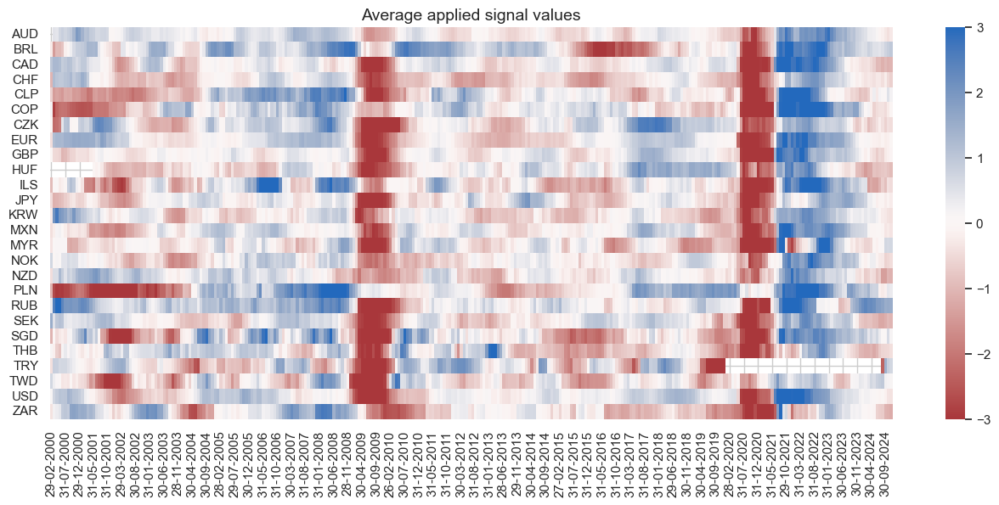

In [132]:
dix = dict_du52
sig = dix["sig"]
naive_pnl = dix["pnls"]

naive_pnl.signal_heatmap(
    pnl_name=sig + "_PZN", freq="m", start="2000-01-01", figsize=(16, 6)
)